#Notebook with models trainig
Three models are considered:
* Random Forest Regressor
* Support Vector Regressor
* AdaBoost Regressor

In [ ]:
import pandas as pd
import numpy as np
from sklearn import model_selection
import matplotlib.pyplot as plt

import sklearn
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor
from sklearn.model_selection import cross_val_score, cross_validate,  GridSearchCV
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.svm import SVR
from sklearn.decomposition import PCA

import math


In [ ]:
!gdown https://drive.google.com/uc?id=1oG6s6tXEWgfU5nk6tyFOHw4sdAdqQlZo

Downloading...
From: https://drive.google.com/uc?id=1oG6s6tXEWgfU5nk6tyFOHw4sdAdqQlZo
To: /content/weather_smog.csv
100% 91.1M/91.1M [00:00<00:00, 134MB/s]


In [ ]:
df = pd.read_csv('weather_smog.csv', parse_dates=True)
scaler = MinMaxScaler()
df['weekday'] = scaler.fit_transform(pd.to_datetime(df['date']).dt.weekday.values.reshape(-1, 1))
df['month'] = scaler.fit_transform(pd.to_datetime(df['date']).dt.month.values.reshape(-1, 1))
df['hour'] = scaler.fit_transform(pd.to_datetime(df['date']).dt.hour.values.reshape(-1, 1))
df.set_index('station', inplace=True)
df.set_index(['date'], append=True, inplace=True)
df = df[~df.index.duplicated()]
conditions = ['month', 'weekday', 'hour', 'temperature', 'precipitation_1', 'humidity', 'wind']
factors = ['NO2', 'O3', 'PM10', 'PM25', 'SO2']
weather = ['temperature', 'wind', 'humidity', 'precipitation_1']
for factor in factors:
    df[factor] = df[factor].astype(str).apply(lambda x: x.replace(',', '.')).astype(float)
    # scaling data for SVR
    # df[factor] = scaler.fit_transform(df[factor].values.reshape(-1, 1)).reshape(-1, 1)
    # aqiVals[factor] = np.array(scaler.transform([[el] for el in aqiVals[factor]])).flatten()
df

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (6,7,8,9,10) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


temperature  precipitation_1  humidity  wind  \
station   date                                                                
354190160 2008-01-01 00:00:00          0.5              0.0      99.0   2.0   
          2008-01-01 01:00:00          0.4              0.0      99.0   1.9   
          2008-01-01 02:00:00          0.3              0.0     100.0   1.9   
          2008-01-01 03:00:00          0.4              0.0     100.0   2.0   
          2008-01-01 04:00:00          0.5              0.0     100.0   2.3   
...                                    ...              ...       ...   ...   
353200270 2020-12-31 19:00:00         -2.0              0.0     100.0   1.9   
          2020-12-31 20:00:00         -1.9              0.0     100.0   1.4   
          2020-12-31 21:00:00         -1.6              0.0     100.0   1.0   
          2020-12-31 22:00:00         -1.4              0.0     100.0   1.7   
          2020-12-31 23:00:00         -1.4              0.0     100.0   1.8   

                               NO2  O3  PM10  PM25  SO2   weekday  month  \
station   date                                                             
354190160 2008-01-01 00:00:00  NaN NaN   NaN   NaN  NaN  0.166667    0.0   
          2008-01-01 01:00:00  NaN NaN   NaN   NaN  NaN  0.166667    0.0   
          2008-01-01 02:00:00  NaN NaN   NaN   NaN  NaN  0.166667    0.0   
          2008-01-01 03:00:00  NaN NaN   NaN   NaN  NaN  0.166667    0.0   
          2008-01-01 04:00:00  NaN NaN   NaN   NaN  NaN  0.166667    0.0   
...                            ...  ..   ...   ...  ...       ...    ...   
353200270 2020-12-31 19:00:00  NaN NaN   NaN   NaN  NaN  0.500000    1.0   
          2020-12-31 20:00:00  NaN NaN   NaN   NaN  NaN  0.500000    1.0   
          2020-12-31 21:00:00  NaN NaN   NaN   NaN  NaN  0.500000    1.0   
          2020-12-31 22:00:00  NaN NaN   NaN   NaN  NaN  0.500000    1.0   
          2020-12-31 23:00:00  NaN NaN   NaN   NaN  NaN  0.500000    1.0   

                                   hour  
station   date                           
354190160 2008-01-01 00:00:00  0.000000  
          2008-01-01 01:00:00  0.043478  
          2008-01-01 02:00:00  0.086957  
          2008-01-01 03:00:00  0.130435  
          2008-01-01 04:00:00  0.173913  
...                                 ...  
353200270 2020-12-31 19:00:00  0.826087  
          2020-12-31 20:00:00  0.869565  
          2020-12-31 21:00:00  0.913043  
          2020-12-31 22:00:00  0.956522  
          2020-12-31 23:00:00  1.000000  

[1630819 rows x 12 columns]

In [ ]:
aqiVals = {
    'PM10': [20, 50, 80, 110, 150],
    'PM25': [13, 35, 55, 75, 110],
    'O3':   [70, 120, 150, 180, 240],
    'NO2':  [40, 100, 150, 230, 400],
    'SO2':  [50, 100, 200, 350, 500]
}

def getAQI(factor, value):
    vals = aqiVals[factor]
    index = -1
    for i, el in enumerate(vals):
        if value <= el:
            index = i
            break
    else:
        index = len(vals)
    return index

def compareAQI(factor, y_pred, y_real, acc = 0):
    return sum([abs(getAQI(factor, y_pred[i]) - getAQI(factor, y_real[i])) <= acc for i, _ in enumerate(y_pred)])/len(y_pred)



In [ ]:
def createDataFrameWithHistoricalDataForParam(df: pd.DataFrame, factor, weather_shift: list, history: list):
    frame = df[[*conditions, factor]].copy(deep=True)
    frame[frame[factor] == 0] = np.nan
    for hour in history:
        frame[f'{factor}-{hour}'] = df.groupby(level=0)[factor].shift(hour)
    for factor in weather:
        for hour in weather_shift:
            frame[f'{factor}-{hour}'] = df.groupby(level=0)[factor].shift(hour)
    frame.dropna(inplace=True)
    return frame

In [ ]:
def createTrainAndTestSet(df, hours, factor, weather_shift, split, seed=9):
    df2 = createDataFrameWithHistoricalDataForParam(df, factor, weather_shift, hours)
    factor_history = [f'{factor}-{hour}' for hour in hours]
    weather_shifted = [f'{param}-{shift}' for param in weather for shift in weather_shift]
    print([*weather_shifted, 'month', 'weekday', 'hour', *factor_history])
    X = df2[[*weather_shifted, 'month', 'weekday', 'hour', *factor_history]]
    Y = df2[[factor]]
    X_train, X_test, Y_train, Y_test = model_selection.train_test_split(X, Y, test_size=split, random_state=seed)
    return X_train.values, X_test.values, Y_train.values, Y_test.values, [*conditions, *factor_history]

In [ ]:
def testModelForVariousParameters(model, df, hours_list, weather_shift, params_list, split, pca=False, n=10):
  for factor in params_list:
    for hours in hours_list:
      print(model)
      print(f'Param: {factor}, history: {hours}:')
      X_train, X_test, Y_train, Y_test, cols = createTrainAndTestSet(df, hours, factor, weather_shift, split)
      if pca:
        pcaa = PCA(n_components=n)
        pcaa.fit(X_train)
        X_train = pcaa.transform(X_train)
        X_test = pcaa.transform(X_test) 
        print(X_train)
      cv = cross_validate(model, X_train, Y_train.ravel(), n_jobs=1, cv=5, return_estimator=True)
      best_model = cv['estimator'][cv['test_score'].argmax()]
      Y_train_pred  = best_model.predict(X_train)
      Y_pred = best_model.predict(X_test)
      print(min(Y_pred), max(Y_pred))
      plotRealAndPredicted(Y_test, Y_pred, 100)
      print("MAE =", round(sklearn.metrics.mean_absolute_error(Y_train, Y_train_pred), 2), round(sklearn.metrics.mean_absolute_error(Y_test, Y_pred), 2)) 
      print("MSE =", round(sklearn.metrics.mean_squared_error(Y_train, Y_train_pred), 2), round(sklearn.metrics.mean_squared_error(Y_test, Y_pred), 2)) 
      print("RMSE =", round(sklearn.metrics.mean_squared_error(Y_train, Y_train_pred, squared=False), 2), round(sklearn.metrics.mean_squared_error(Y_test, Y_pred, squared=False), 2)) 
      print("R2 =", round(best_model.score(X_train, Y_train), 2), round(sklearn.metrics.r2_score(Y_test, Y_pred), 2))
      print("AQI accuracy =", compareAQI(factor, Y_train_pred, Y_train), compareAQI(factor, Y_pred, Y_test))
      print("AQI accuracy+-1 =", compareAQI(factor, Y_train_pred, Y_train, 1), compareAQI(factor, Y_pred, Y_test, 1))
      print()


In [ ]:
def plotRealAndPredicted(Y_real, Y_predicted, length=None):
    plt.figure(figsize=(20, 10))
    plt.plot(Y_real[:length], label="Real values")
    plt.plot(Y_predicted[:length], label="Predicted values")
    plt.xlabel('Time')
    plt.ylabel(r'Pollutant concentration, $\mu$g/m$^3$')
    plt.legend()
    plt.show()

Random Forest Regressor

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'NO2-12']
2.1177248558219026 157.94344393333375


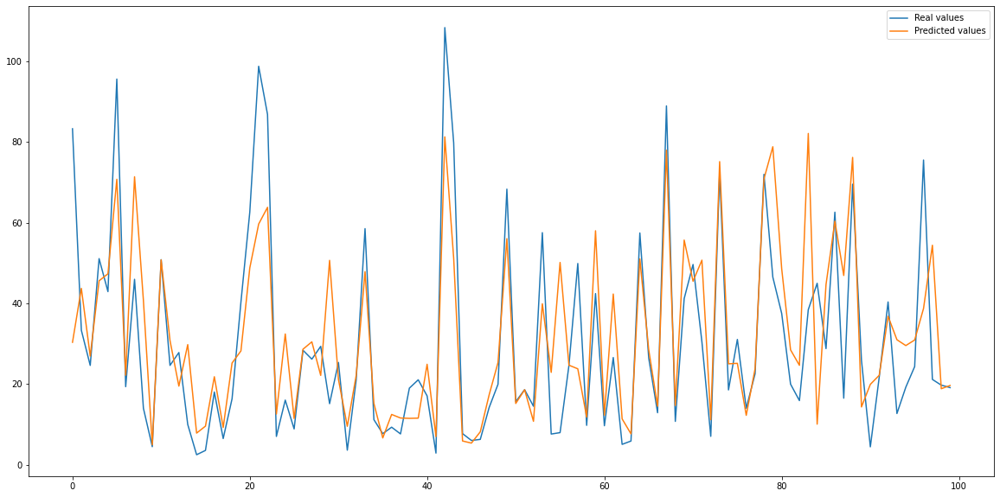

MAE = 2.43 11.64
MSE = 59.74 291.6
RMSE = 7.73 17.08
R2 = 0.93 0.65
AQI accuracy = 0.9653449322273923 0.831276552700789
AQI accuracy+-1 = 0.9996055027311349 0.9978150920493627

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'SO2-12']
1.5348824007936535 56.856907833333366


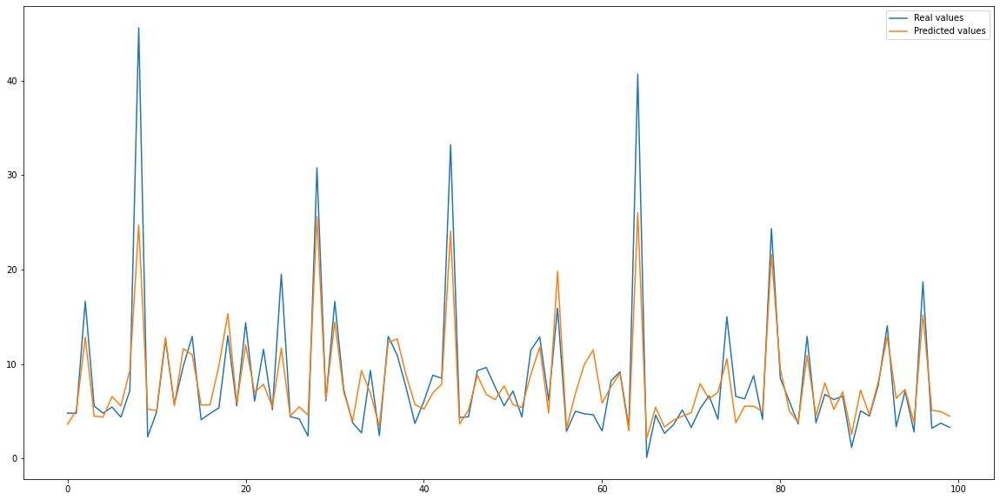

MAE = 0.41 2.12
MSE = 2.64 14.58
RMSE = 1.63 3.82
R2 = 0.93 0.64
AQI accuracy = 0.9995617879053462 0.9978348283328178
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'O3-12']
4.463508208862439 151.44583233333336


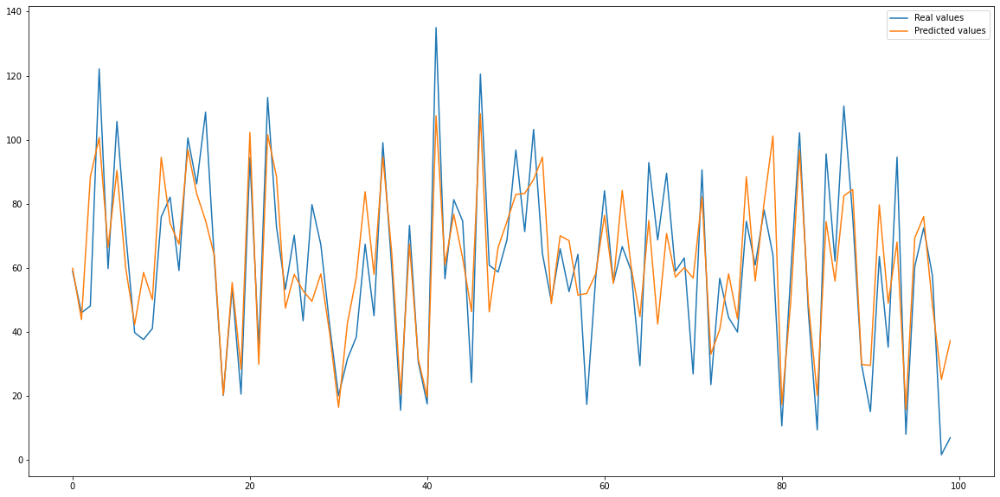

MAE = 2.36 11.53
MSE = 46.39 234.93
RMSE = 6.81 15.33
R2 = 0.94 0.69
AQI accuracy = 0.9660651867296253 0.8414839797639123
AQI accuracy+-1 = 0.9997547065677317 0.9992334815269048

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM10-12']
4.156033833333333 175.5613440000002


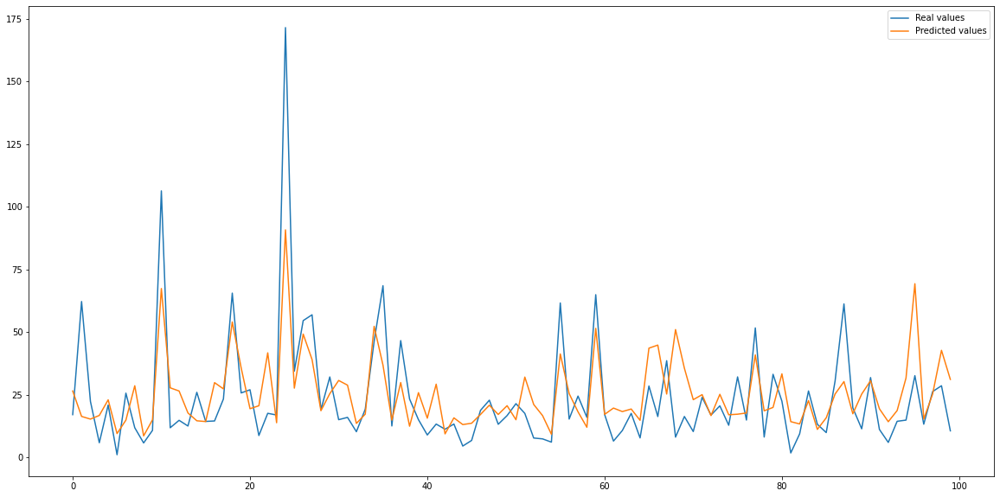

MAE = 2.18 10.6
MSE = 62.38 322.42
RMSE = 7.9 17.96
R2 = 0.89 0.47
AQI accuracy = 0.9262228964255186 0.642925936627179
AQI accuracy+-1 = 0.9944257834603484 0.9698545699701435

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM25-12']
2.4739050474415194 90.12186566666651


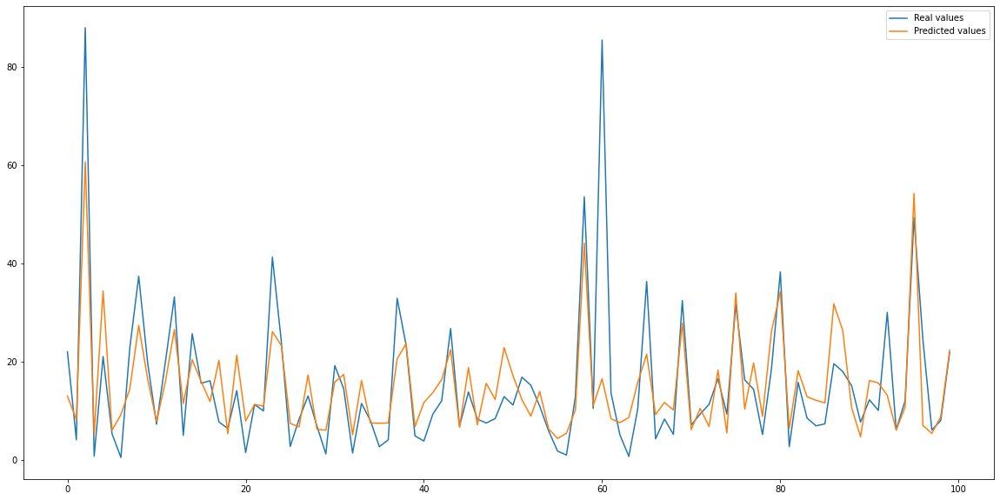

MAE = 1.07 5.21
MSE = 13.78 66.05
RMSE = 3.71 8.13
R2 = 0.92 0.62
AQI accuracy = 0.9468395293137561 0.7353951890034365
AQI accuracy+-1 = 0.9979954180985109 0.9901072581484953



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[12]], [12], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'NO2-12', 'NO2-13', 'NO2-14', 'NO2-15', 'NO2-16', 'NO2-17']
2.7141351114911627 125.27141019871803


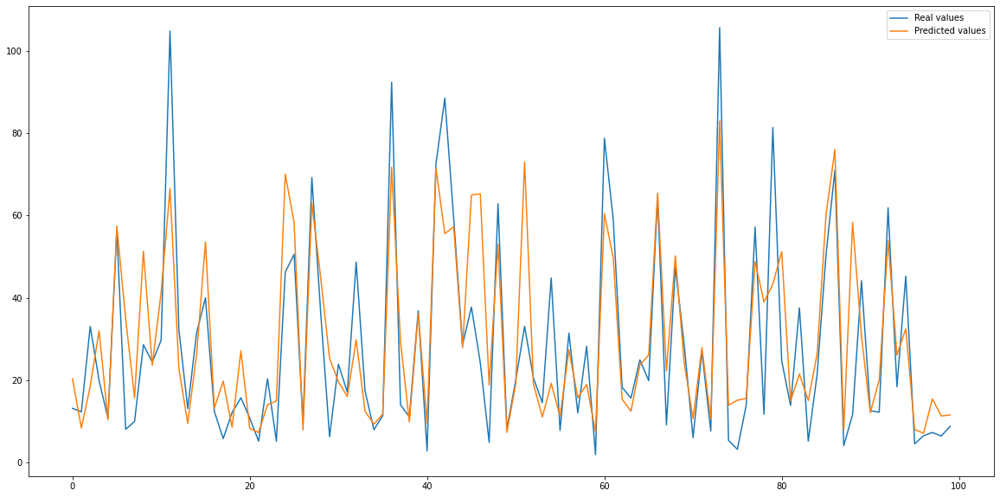

MAE = 2.49 11.7
MSE = 57.24 283.74
RMSE = 7.57 16.84
R2 = 0.93 0.66
AQI accuracy = 0.9655009550998132 0.833711167086482
AQI accuracy+-1 = 0.9997271143390919 0.9979848866498741

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'SO2-12', 'SO2-13', 'SO2-14', 'SO2-15', 'SO2-16', 'SO2-17']
1.0612954 41.90745010000004


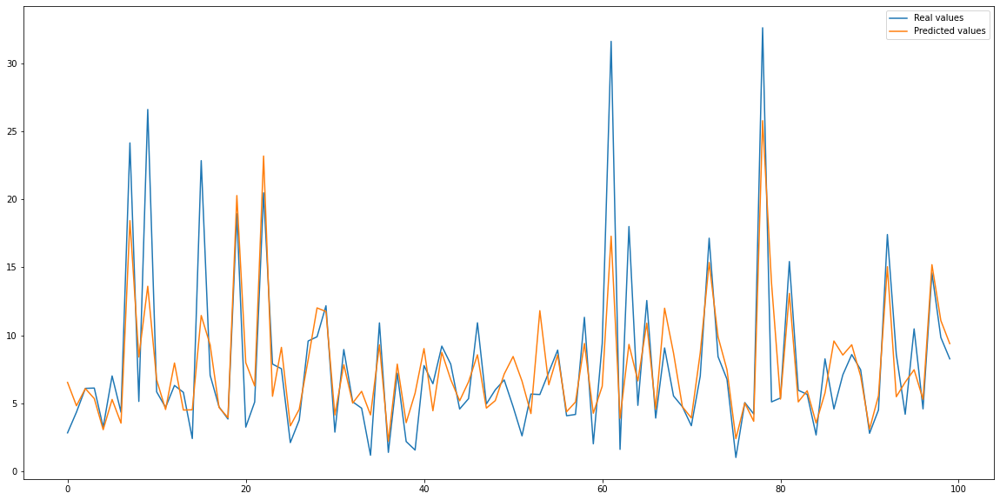

MAE = 0.45 2.2
MSE = 3.0 15.06
RMSE = 1.73 3.88
R2 = 0.92 0.63
AQI accuracy = 0.9994012790855898 0.9972787634701208
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'O3-12', 'O3-13', 'O3-14', 'O3-15', 'O3-16', 'O3-17']
3.556734314997913 160.21866666666665


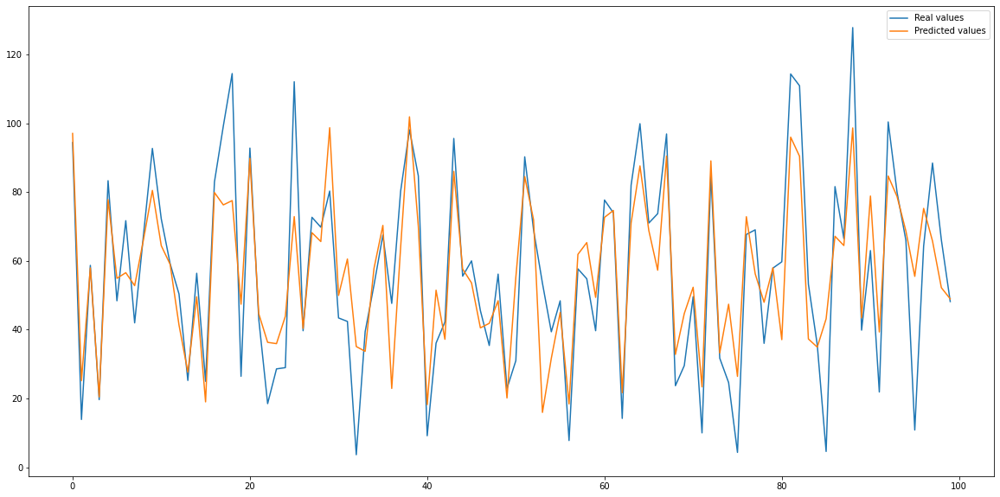

MAE = 2.36 11.3
MSE = 43.75 220.11
RMSE = 6.61 14.84
R2 = 0.94 0.71
AQI accuracy = 0.9666165694573149 0.8437003581996574
AQI accuracy+-1 = 0.9998987672971648 0.9994081918704252

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'PM10-12', 'PM10-13', 'PM10-14', 'PM10-15', 'PM10-16', 'PM10-17']
5.1374966532017545 174.91268666666673


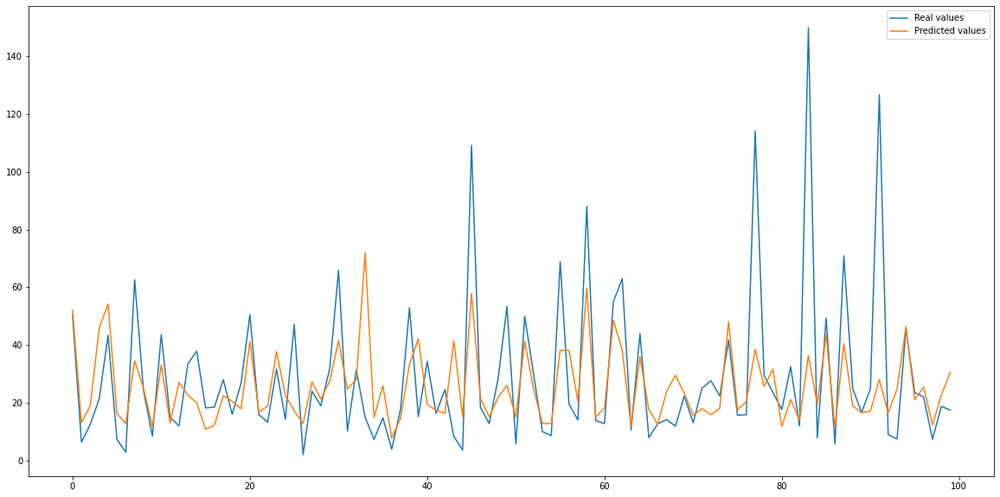

MAE = 2.34 10.82
MSE = 63.82 302.29
RMSE = 7.99 17.39
R2 = 0.89 0.49
AQI accuracy = 0.9216741221888596 0.6357174371292711
AQI accuracy+-1 = 0.994460444880201 0.9718613657532232

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'PM25-12', 'PM25-13', 'PM25-14', 'PM25-15', 'PM25-16', 'PM25-17']
2.890822423104033 93.21758300000019


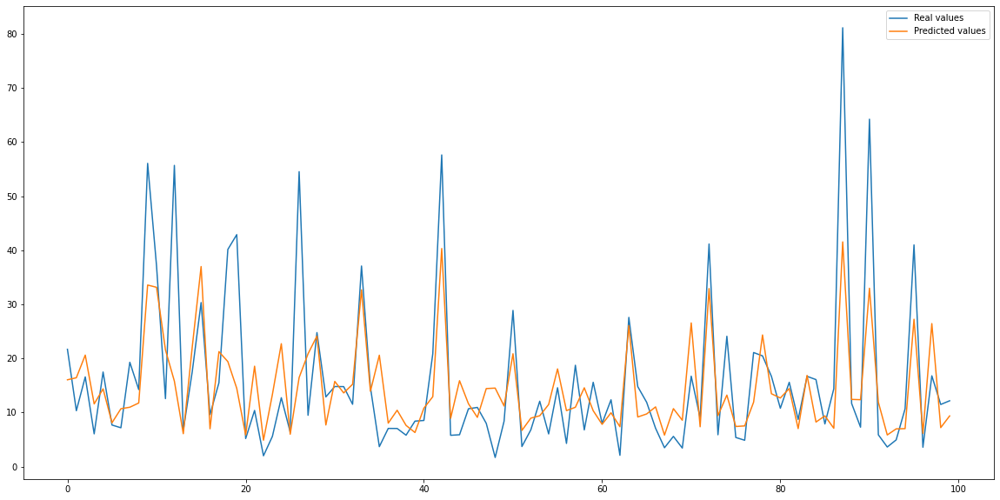

MAE = 1.1 5.46
MSE = 13.48 70.02
RMSE = 3.67 8.37
R2 = 0.93 0.61
AQI accuracy = 0.9440689560815433 0.7167560468425085
AQI accuracy+-1 = 0.9981392803393077 0.9923388420707016



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[12, 13, 14, 15, 16, 17]], [12, 13, 14, 15, 16, 17], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'precipitation_1-18', 'precipitation_1-19', 'precipitation_1-20', 'precipitation_1-21', 'precipitation_1-22', 'precipitation_1-23', 'month', 'we

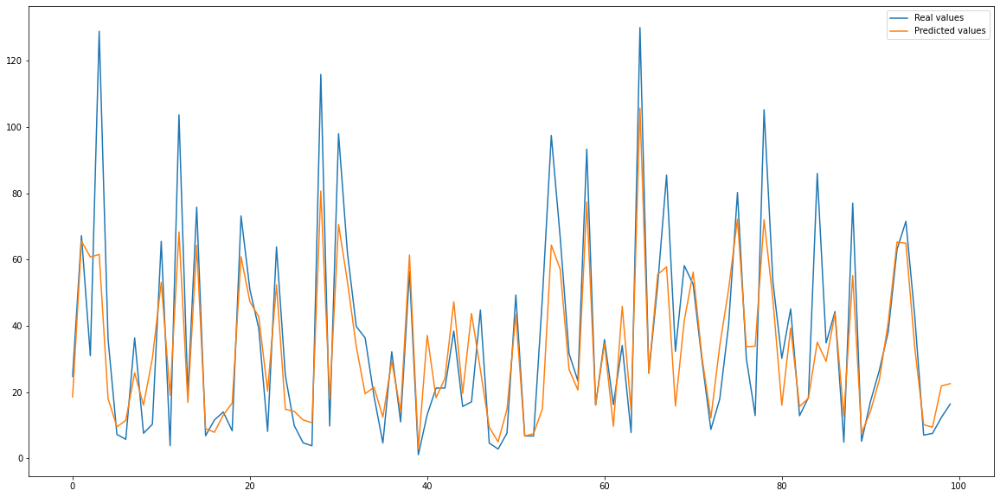

MAE = 2.38 11.43
MSE = 54.38 274.02
RMSE = 7.37 16.55
R2 = 0.94 0.68
AQI accuracy = 0.9655085378166015 0.8344234230279619
AQI accuracy+-1 = 0.9996159079935033 0.9988148018085247

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipit

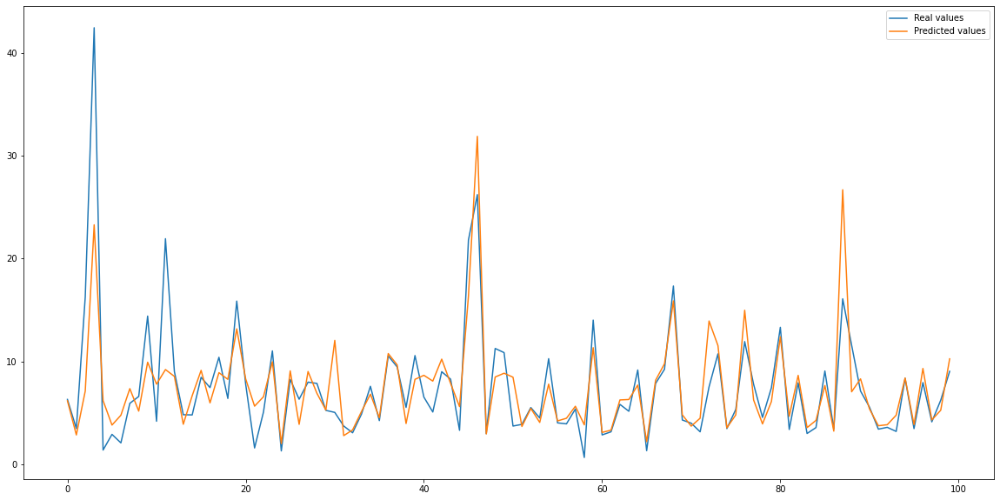

MAE = 0.42 2.06
MSE = 2.61 13.81
RMSE = 1.62 3.72
R2 = 0.93 0.67
AQI accuracy = 0.9995050369766494 0.9970886223360894
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 

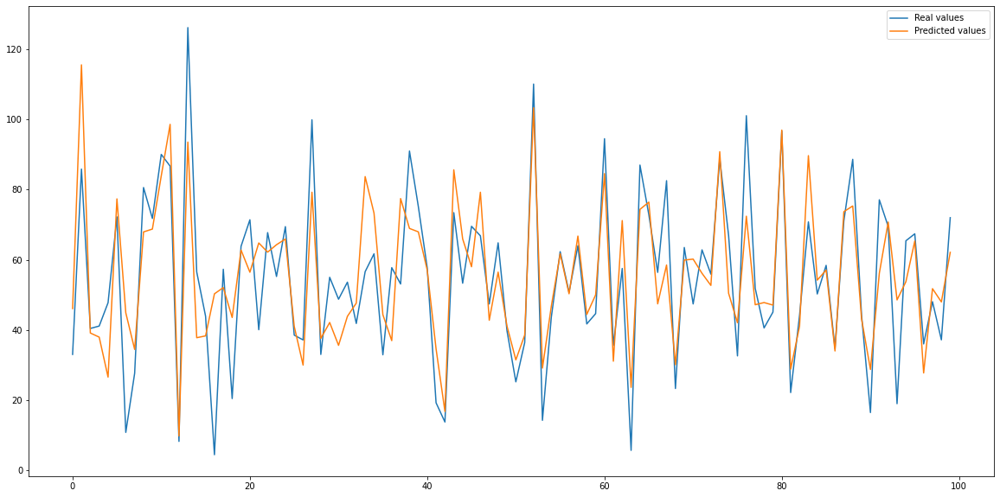

MAE = 2.26 10.85
MSE = 39.91 203.43
RMSE = 6.32 14.26
R2 = 0.95 0.73
AQI accuracy = 0.9672461537240837 0.8455312936397106
AQI accuracy+-1 = 0.9999127198863772 0.9995556684016758

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipi

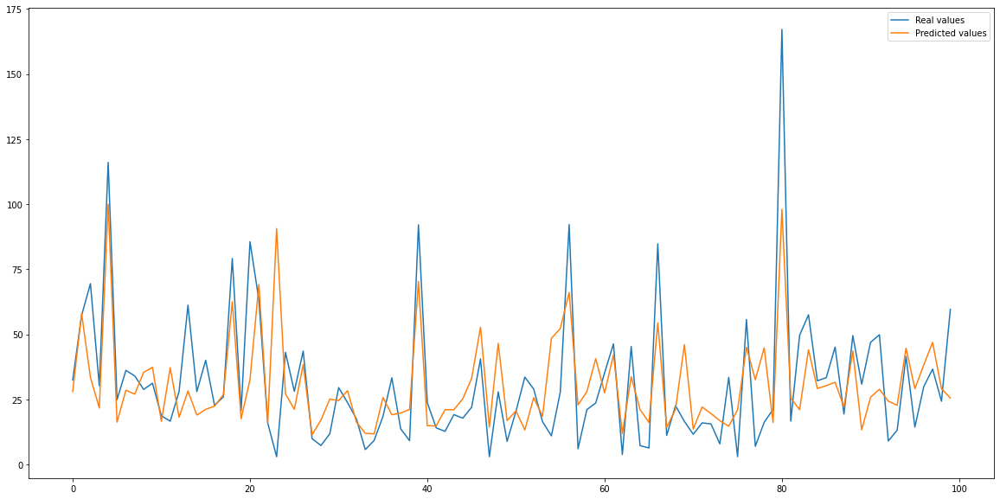

MAE = 2.26 10.43
MSE = 56.99 303.0
RMSE = 7.55 17.41
R2 = 0.9 0.5
AQI accuracy = 0.9234130749637917 0.6458073215801828
AQI accuracy+-1 = 0.9945687459421665 0.9733806122958598

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitat

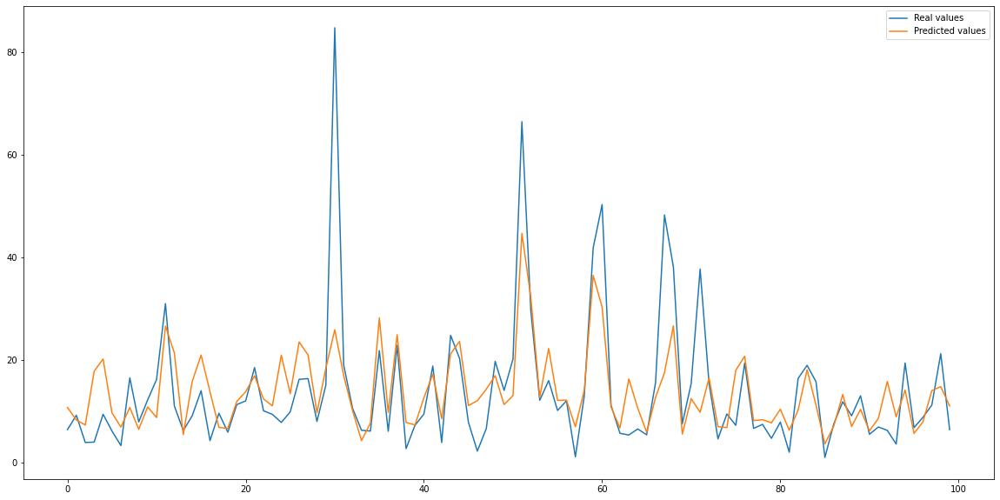

MAE = 1.08 5.23
MSE = 13.45 66.66
RMSE = 3.67 8.16
R2 = 0.93 0.61
AQI accuracy = 0.9438667632150616 0.735982391102873
AQI accuracy+-1 = 0.9980883417813179 0.989805375347544



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]], [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'NO2-2']
1.3760292270370371 160.8304180000005


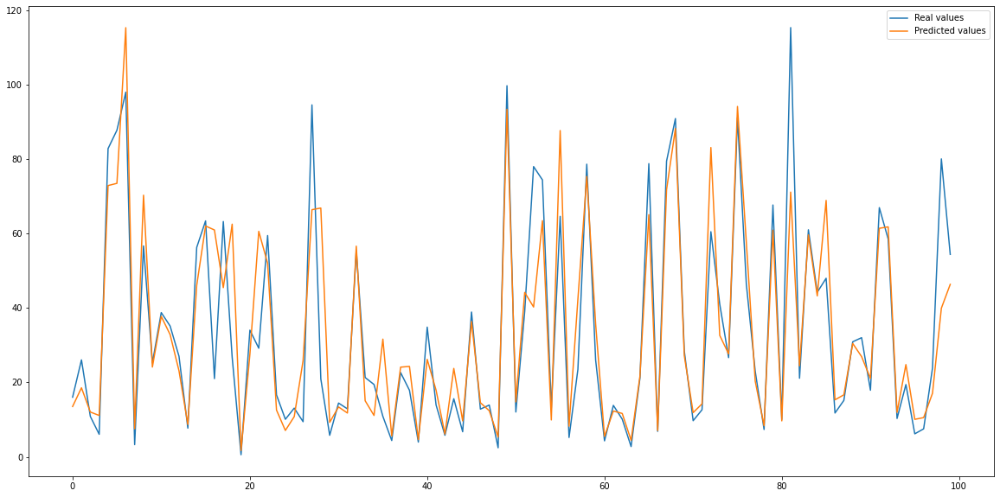

MAE = 1.45 7.21
MSE = 27.0 137.93
RMSE = 5.2 11.74
R2 = 0.97 0.84
AQI accuracy = 0.9794335397712373 0.8930848059388364
AQI accuracy+-1 = 0.9998083556918359 0.9990317114500121

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'SO2-2']
0.7647897000000011 57.59519533333326


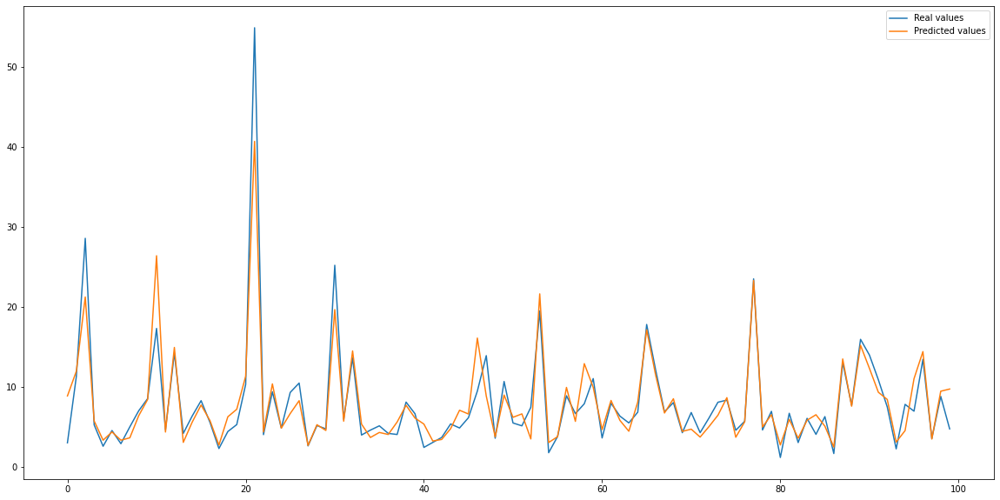

MAE = 0.29 1.43
MSE = 1.37 6.45
RMSE = 1.17 2.54
R2 = 0.97 0.83
AQI accuracy = 0.9995376197693236 0.9983561080858934
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'O3-2']
1.5651643833333388 166.33326333333383


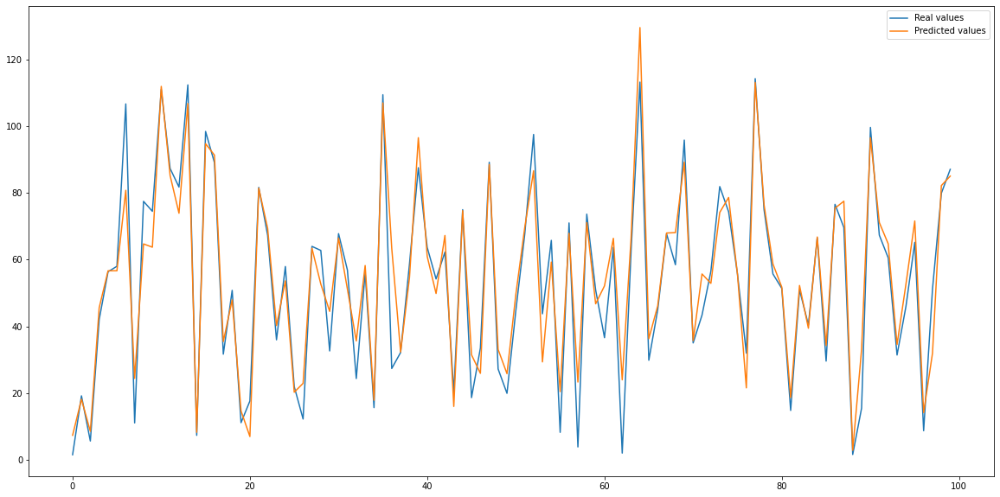

MAE = 1.19 5.91
MSE = 14.36 72.6
RMSE = 3.79 8.52
R2 = 0.98 0.9
AQI accuracy = 0.9831349433881486 0.9159352924987003
AQI accuracy+-1 = 0.9999847098308143 0.9998776795816642

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'PM10-2']
1.7146048999999952 221.27721966666684


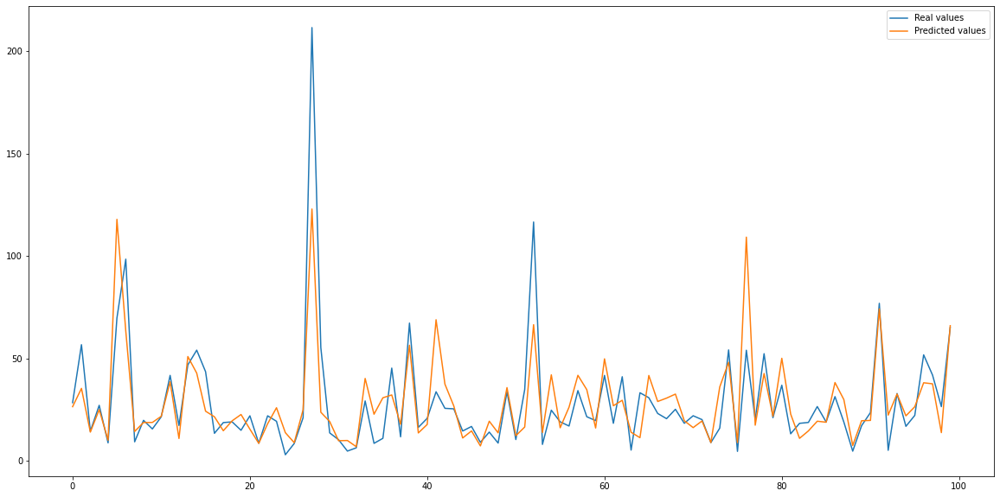

MAE = 1.47 7.49
MSE = 30.2 179.1
RMSE = 5.5 13.38
R2 = 0.95 0.71
AQI accuracy = 0.951231173798709 0.7575424336600526
AQI accuracy+-1 = 0.9973583552474301 0.9855127898637341

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'PM25-2']
0.966090099999997 115.25389866666679


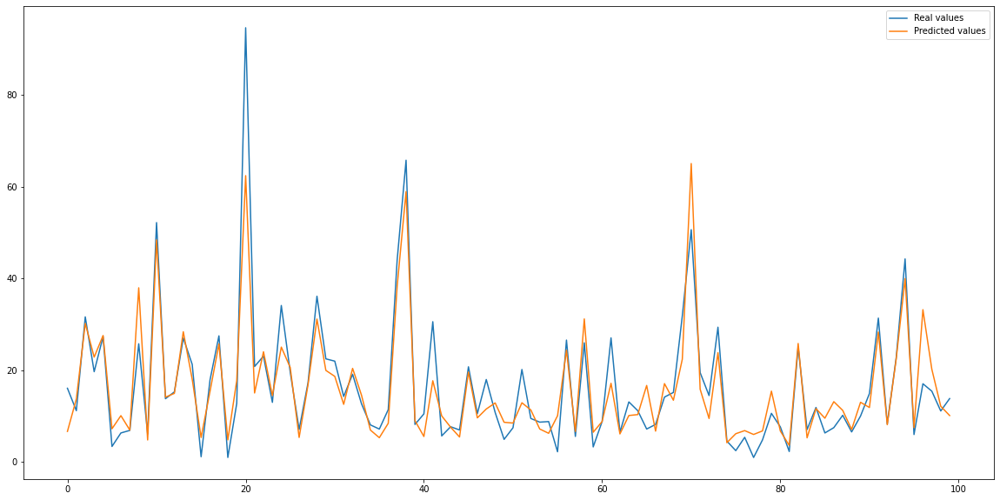

MAE = 0.73 3.71
MSE = 6.65 36.91
RMSE = 2.58 6.08
R2 = 0.96 0.8
AQI accuracy = 0.9624612202688728 0.8193381592554292
AQI accuracy+-1 = 0.9994570837642193 0.9950361944157187



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[2]], [2], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [2, 3, 4, 5]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'month', 'weekday', 'hour', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5']
1.0197876333333336 153.76661233333292


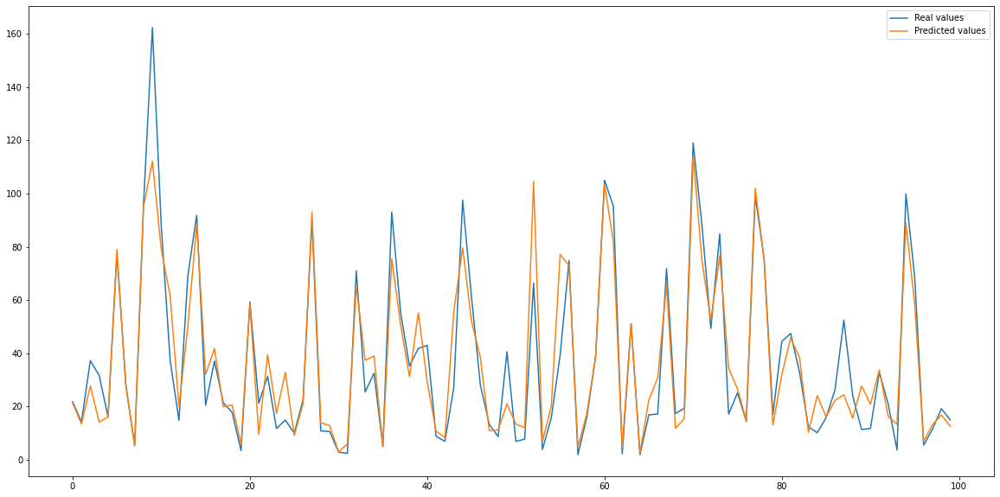

MAE = 1.46 7.07
MSE = 26.09 129.25
RMSE = 5.11 11.37
R2 = 0.97 0.84
AQI accuracy = 0.9786330074660727 0.8965929714568553
AQI accuracy+-1 = 0.9998556284288248 0.9995050321729088

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [2, 3, 4, 5]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'month', 'weekday', 'hour', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5']
1.3778909716666674 57.18934233333342


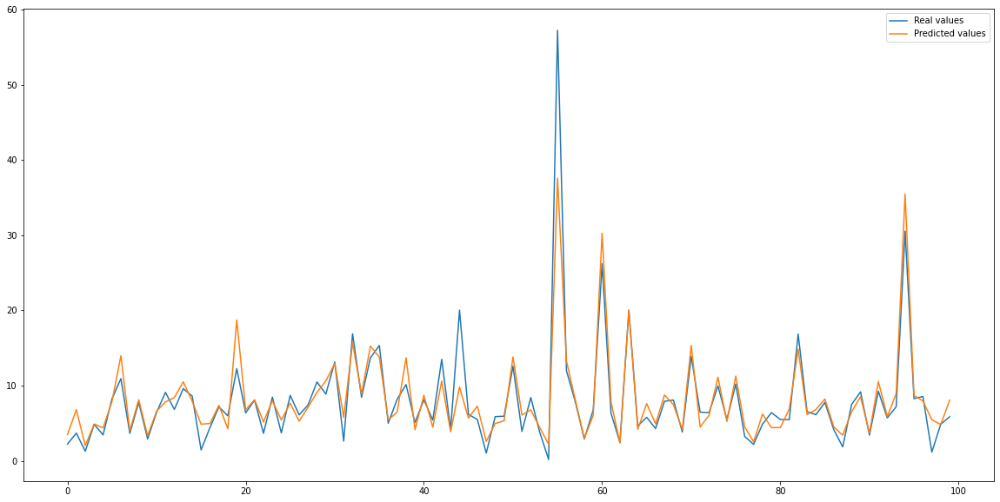

MAE = 0.29 1.37
MSE = 1.44 6.39
RMSE = 1.2 2.53
R2 = 0.96 0.84
AQI accuracy = 0.999655035159878 0.9983018467416684
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [2, 3, 4, 5]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'month', 'weekday', 'hour', 'O3-2', 'O3-3', 'O3-4', 'O3-5']
1.1565085104761899 172.79939333333334


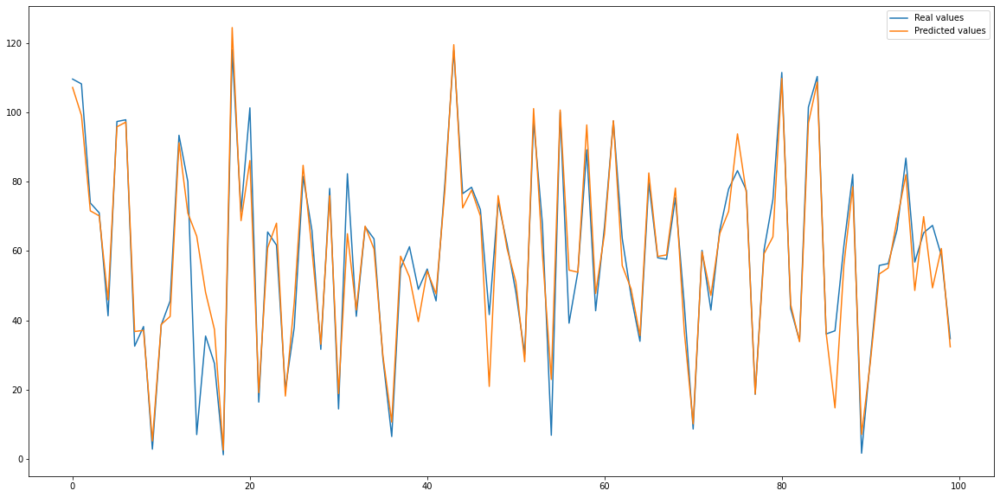

MAE = 1.19 5.68
MSE = 13.53 67.56
RMSE = 3.68 8.22
R2 = 0.98 0.91
AQI accuracy = 0.9829356013830576 0.9198592288457382
AQI accuracy+-1 = 0.9999768461348482 0.9999382582656747

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [2, 3, 4, 5]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'month', 'weekday', 'hour', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5']
2.488110266666673 219.88617133333338


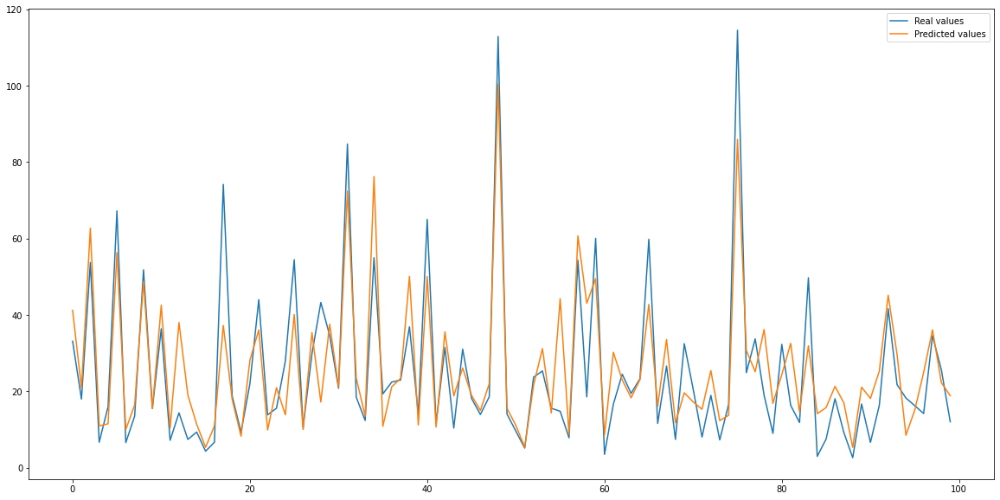

MAE = 1.57 7.37
MSE = 33.19 172.33
RMSE = 5.76 13.13
R2 = 0.94 0.72
AQI accuracy = 0.9475159820662485 0.7585556844547564
AQI accuracy+-1 = 0.9971480017885412 0.9857405259087394

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [2, 3, 4, 5]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'month', 'weekday', 'hour', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5']
1.4150661333333359 124.95674566666656


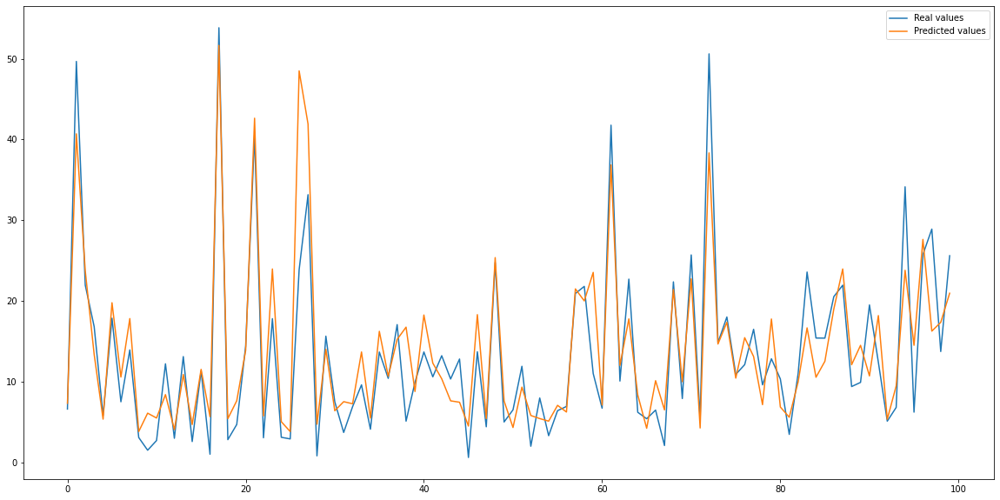

MAE = 0.74 3.6
MSE = 6.77 31.98
RMSE = 2.6 5.66
R2 = 0.96 0.81
AQI accuracy = 0.962804081958914 0.8236171800063945
AQI accuracy+-1 = 0.9992006607870827 0.9971224555046361



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[2, 3, 4, 5]], [2, 3, 4, 5], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [2, 3, 4, 5, 6, 7, 8, 9]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'month', 'weekday', 'hour', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9']
1.5821496666666657 158.94850266666694


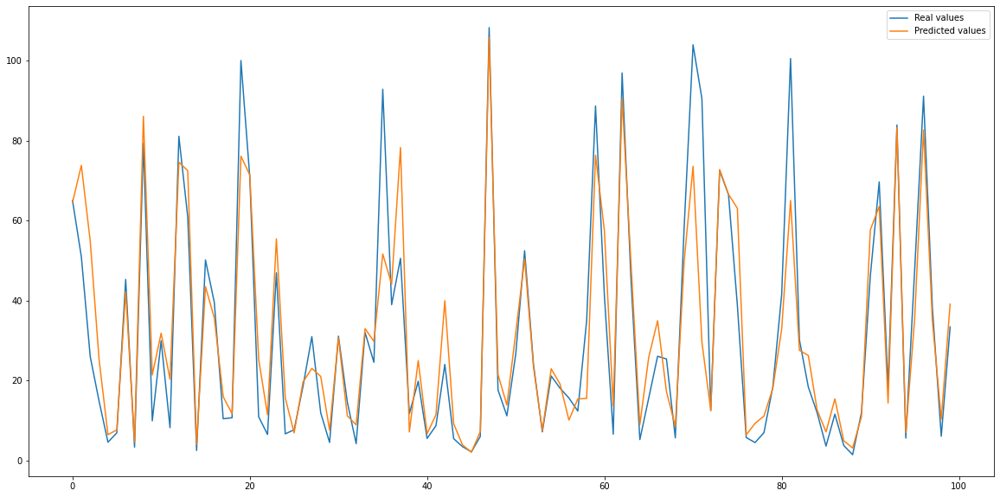

MAE = 1.46 7.19
MSE = 25.33 130.47
RMSE = 5.03 11.42
R2 = 0.97 0.85
AQI accuracy = 0.9795508625817966 0.8972125435540069
AQI accuracy+-1 = 0.9999043936432396 0.999660066287074

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [2, 3, 4, 5, 6, 7, 8, 9]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'month', 'weekday', 'hour', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9']
1.3063407999999976 58.222811000000064


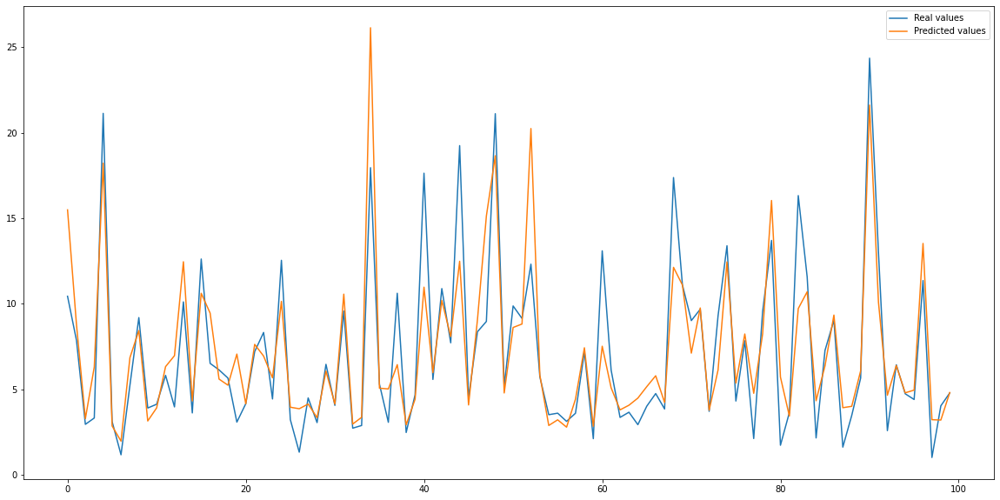

MAE = 0.28 1.44
MSE = 1.18 7.18
RMSE = 1.08 2.68
R2 = 0.97 0.83
AQI accuracy = 0.9996949105533213 0.9980031062791214
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [2, 3, 4, 5, 6, 7, 8, 9]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'month', 'weekday', 'hour', 'O3-2', 'O3-3', 'O3-4', 'O3-5', 'O3-6', 'O3-7', 'O3-8', 'O3-9']
1.5937872536201814 167.92563666666666


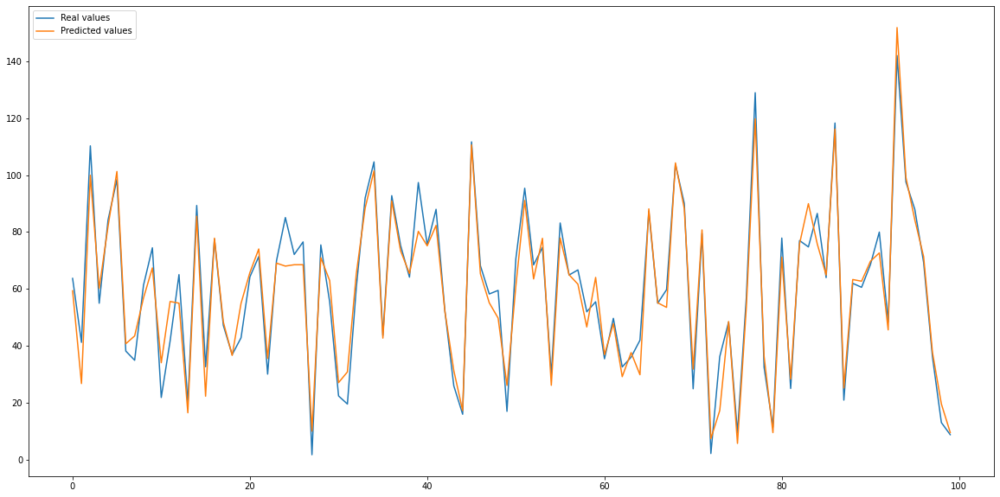

MAE = 1.21 5.75
MSE = 13.46 68.19
RMSE = 3.67 8.26
R2 = 0.98 0.91
AQI accuracy = 0.9821016843174801 0.9169662675461906
AQI accuracy+-1 = 0.9999921841416234 0.9998749491981117

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [2, 3, 4, 5, 6, 7, 8, 9]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'month', 'weekday', 'hour', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9']
2.7766564333333332 213.6397823333329


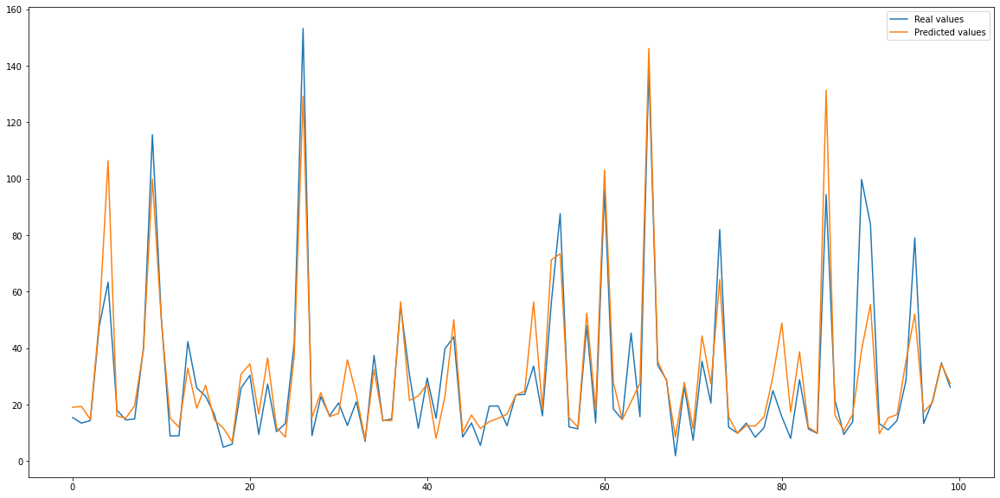

MAE = 1.58 7.3
MSE = 33.11 164.75
RMSE = 5.75 12.84
R2 = 0.94 0.72
AQI accuracy = 0.9479748261338035 0.7616435672657819
AQI accuracy+-1 = 0.9972940542658438 0.9864831774327832

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [2, 3, 4, 5, 6, 7, 8, 9]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'month', 'weekday', 'hour', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9']
1.6326451262218056 123.28810300000002


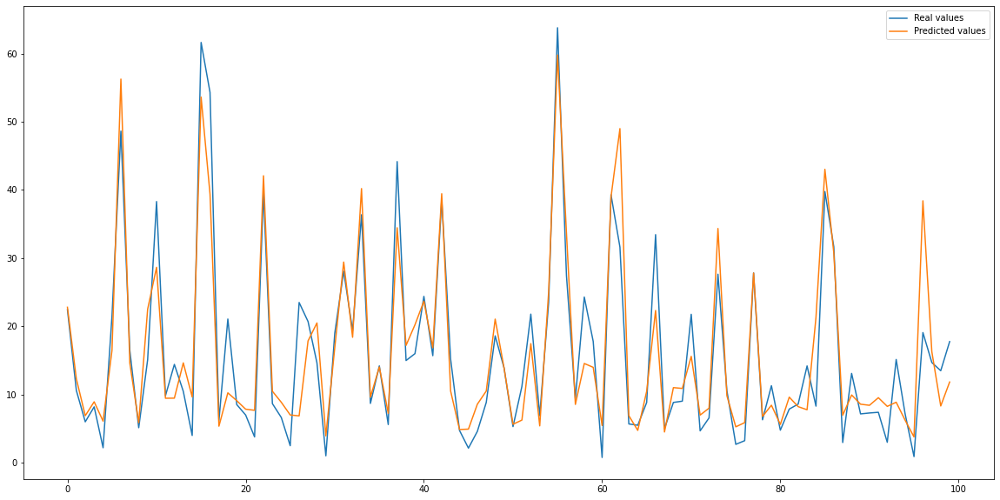

MAE = 0.74 3.63
MSE = 7.07 33.85
RMSE = 2.66 5.82
R2 = 0.96 0.82
AQI accuracy = 0.9619646517812621 0.819612188365651
AQI accuracy+-1 = 0.9991135242949748 0.9963434903047091



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[2, 3, 4, 5, 6, 7, 8, 9]], [2, 3, 4, 5, 6, 7, 8, 9], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'NO2-6']
1.64622201666667 166.5245648000005


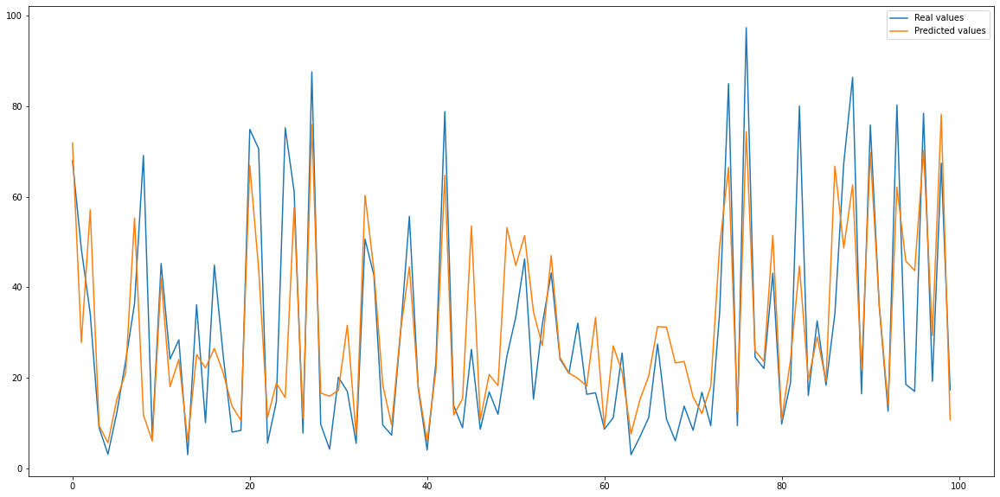

MAE = 2.03 10.08
MSE = 45.27 230.13
RMSE = 6.73 15.17
R2 = 0.95 0.72
AQI accuracy = 0.9711425800977739 0.855561391458931
AQI accuracy+-1 = 0.9997373843481071 0.9985051109046099

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'SO2-6']
1.4764012599999987 59.70278903333333


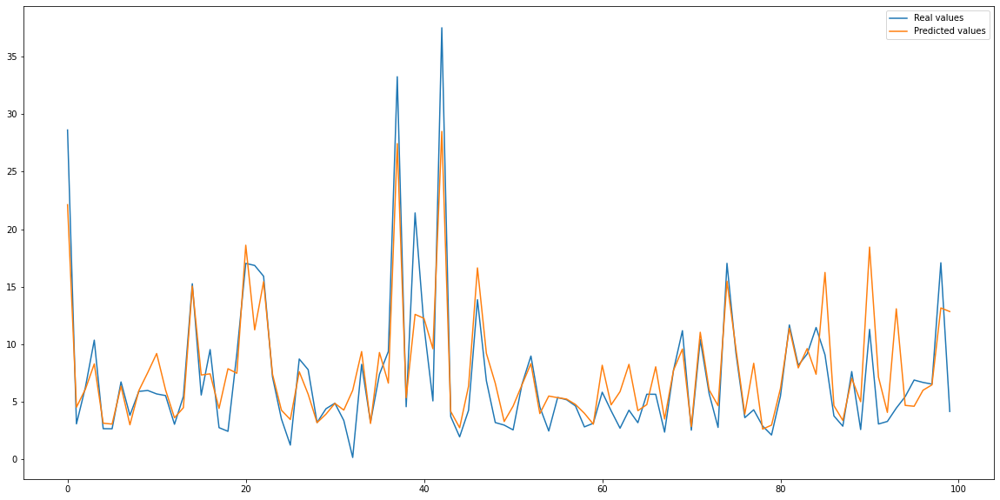

MAE = 0.38 1.88
MSE = 2.21 11.5
RMSE = 1.49 3.39
R2 = 0.94 0.71
AQI accuracy = 0.9996140486298727 0.9982504888340022
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'O3-6']
1.6477629666666673 159.87527000000003


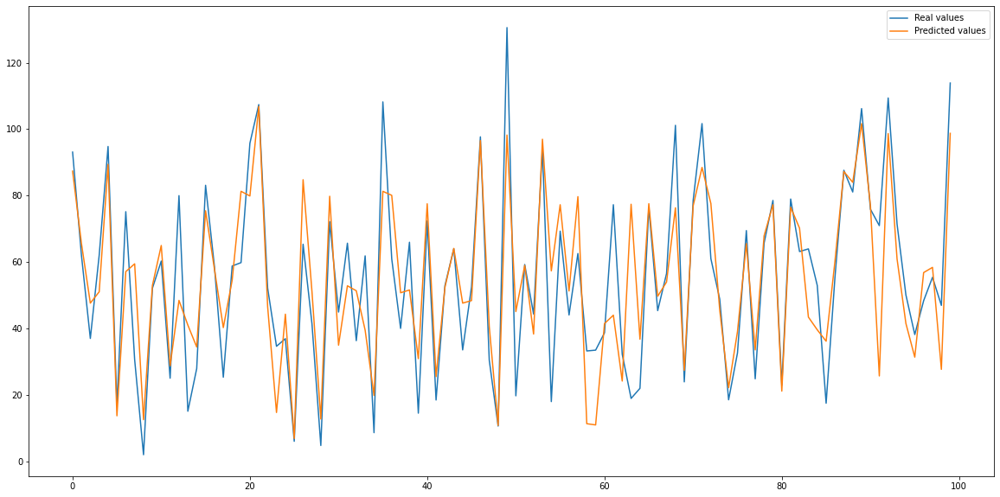

MAE = 1.94 9.68
MSE = 33.91 172.35
RMSE = 5.82 13.13
R2 = 0.96 0.78
AQI accuracy = 0.9721588560405408 0.8584157506353532
AQI accuracy+-1 = 0.999900485325413 0.9994794696714535

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM10-6']
2.722184066666669 250.48137266666672


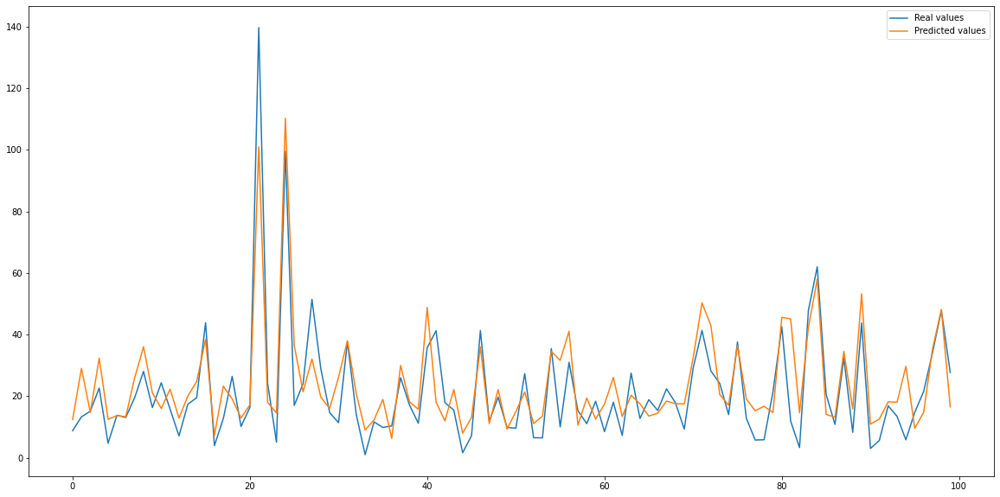

MAE = 1.96 9.6
MSE = 50.69 246.15
RMSE = 7.12 15.69
R2 = 0.91 0.55
AQI accuracy = 0.9342490403071018 0.6794145873320537
AQI accuracy+-1 = 0.9952975047984645 0.9759117082533589

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM25-6']
2.1787879999084248 109.50038799999987


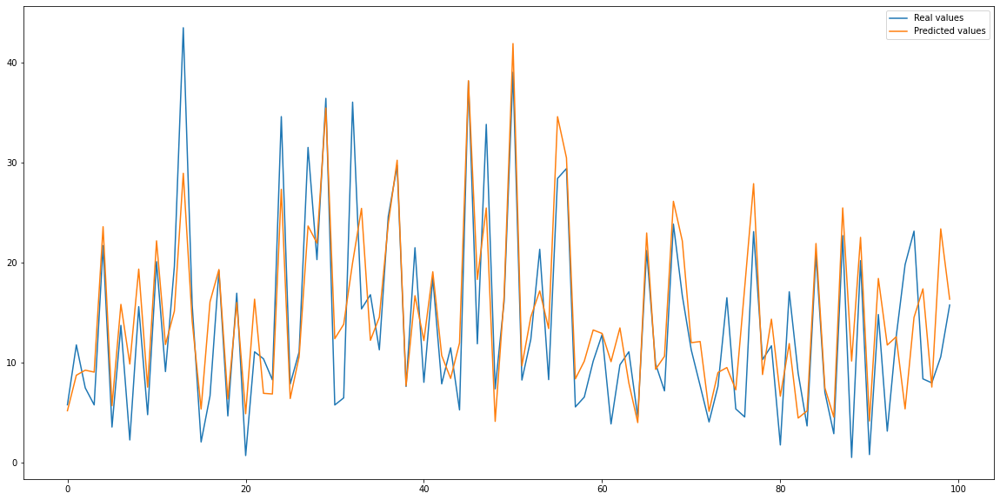

MAE = 0.97 4.73
MSE = 11.23 53.84
RMSE = 3.35 7.34
R2 = 0.94 0.7
AQI accuracy = 0.951560594660509 0.7568493150684932
AQI accuracy+-1 = 0.9982616817580364 0.9941884599418847



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[6]], [6], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [6, 7, 8, 9, 10, 11]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'month', 'weekday', 'hour', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11']
1.8964626666666675 144.9418813333331


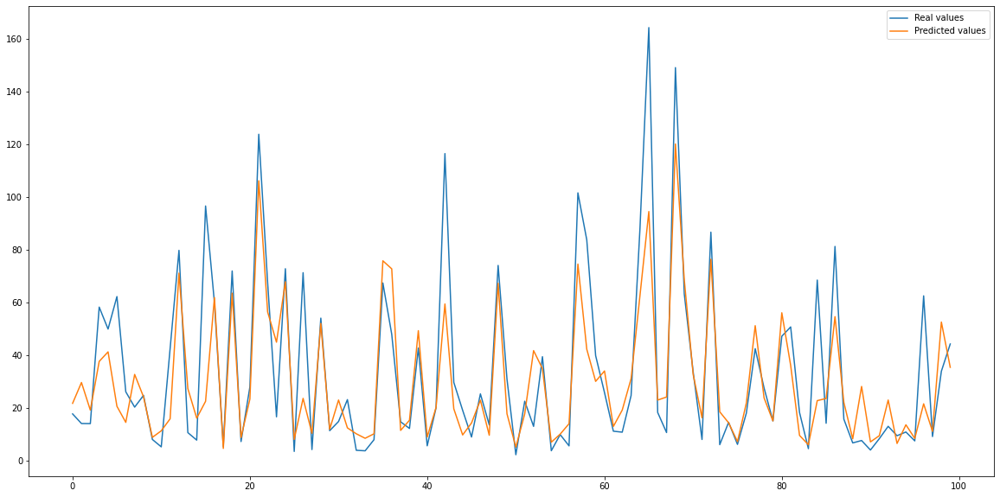

MAE = 2.11 10.07
MSE = 44.84 223.08
RMSE = 6.7 14.94
R2 = 0.95 0.73
AQI accuracy = 0.970203534072568 0.8570889578267796
AQI accuracy+-1 = 0.9997275033014024 0.9989100360526536

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [6, 7, 8, 9, 10, 11]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'month', 'weekday', 'hour', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9', 'SO2-10', 'SO2-11']
0.9990360333333338 46.39742883333333


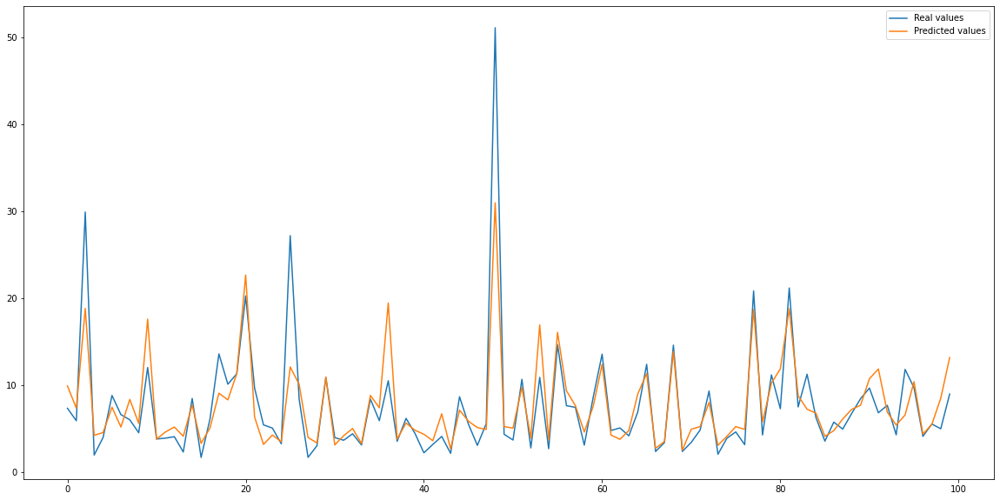

MAE = 0.38 1.9
MSE = 2.19 11.05
RMSE = 1.48 3.32
R2 = 0.95 0.71
AQI accuracy = 0.9996739573427523 0.9981525755270594
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [6, 7, 8, 9, 10, 11]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'month', 'weekday', 'hour', 'O3-6', 'O3-7', 'O3-8', 'O3-9', 'O3-10', 'O3-11']
2.8723044134327274 159.56666666666666


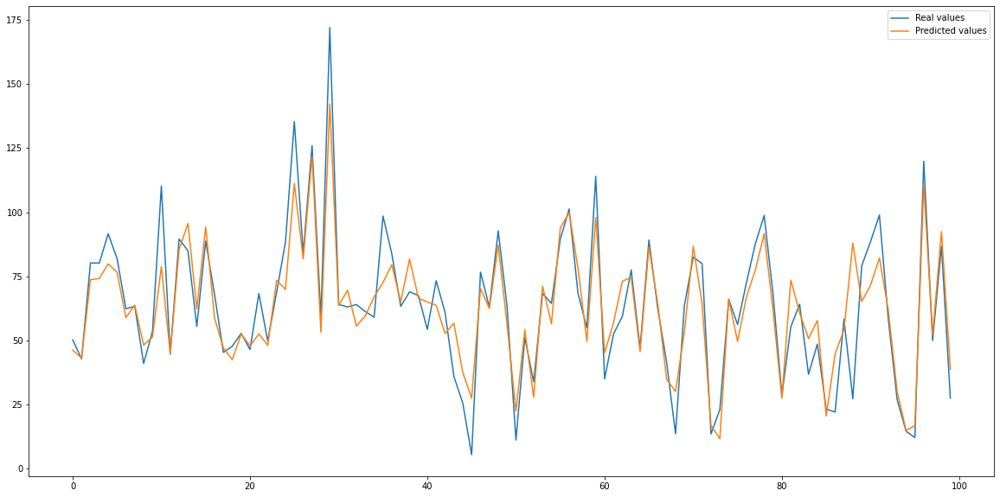

MAE = 1.99 9.51
MSE = 32.97 163.85
RMSE = 5.74 12.8
R2 = 0.96 0.79
AQI accuracy = 0.9710950744202684 0.865127997760428
AQI accuracy+-1 = 0.9999533415244879 0.9995956328346138

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [6, 7, 8, 9, 10, 11]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'month', 'weekday', 'hour', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9', 'PM10-10', 'PM10-11']
4.708907458703703 157.23557199999988


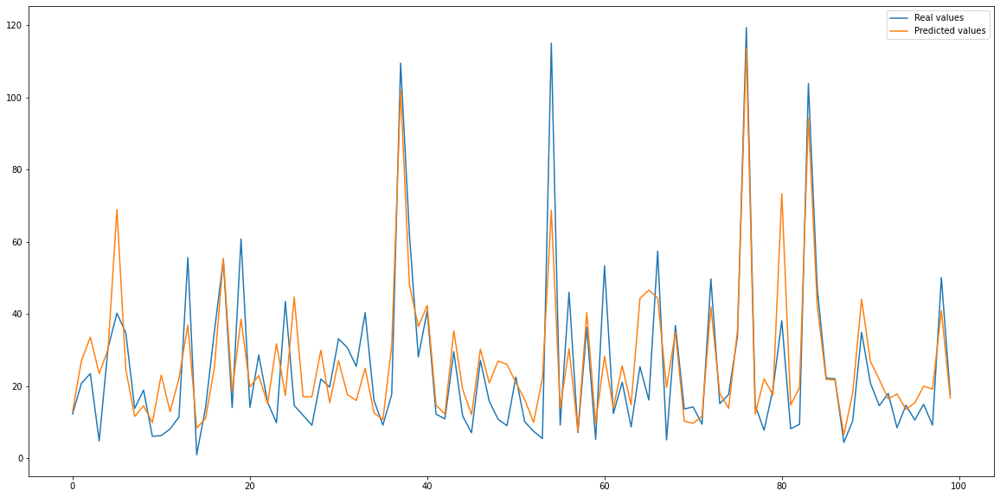

MAE = 2.05 9.86
MSE = 49.63 268.13
RMSE = 7.05 16.37
R2 = 0.92 0.55
AQI accuracy = 0.9317884918260955 0.6747082092103336
AQI accuracy+-1 = 0.9953850098282198 0.9755823606973678

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [6, 7, 8, 9, 10, 11]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'month', 'weekday', 'hour', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9', 'PM25-10', 'PM25-11']
2.894395796956594 118.52587966666641


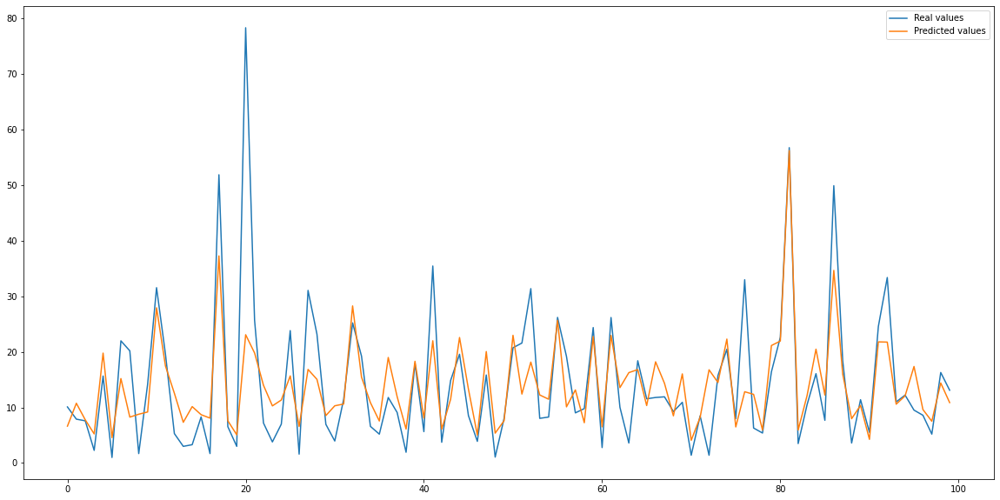

MAE = 0.97 4.86
MSE = 11.02 58.95
RMSE = 3.32 7.68
R2 = 0.94 0.68
AQI accuracy = 0.9514269359718701 0.7617749672917575
AQI accuracy+-1 = 0.998718892250661 0.9922590492804186



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[6,7, 8, 9, 10, 11]], [6, 7, 8, 9, 10, 11], [param], 0.2)

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'month', 'weekday', 'hour', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11', 'NO2-12', 'NO2-13'

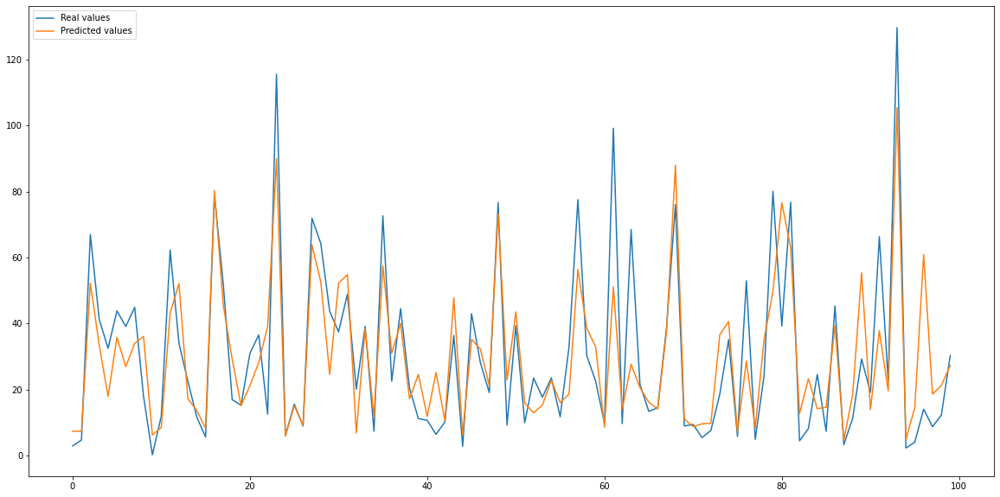

MAE = 2.09 10.18
MSE = 44.05 221.72
RMSE = 6.64 14.89
R2 = 0.95 0.74
AQI accuracy = 0.9703197589024404 0.8523434440140998
AQI accuracy+-1 = 0.9997824029245047 0.9989990861221115

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitat

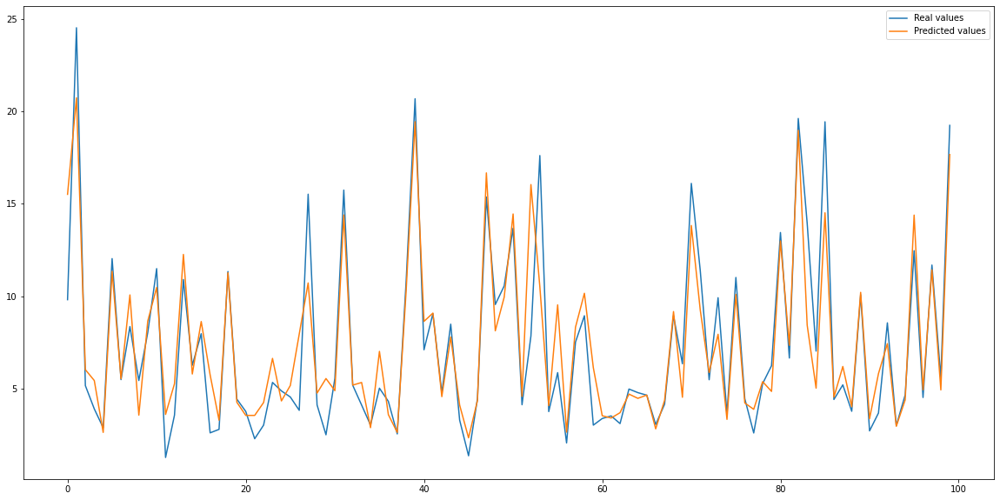

MAE = 0.38 1.89
MSE = 2.26 11.38
RMSE = 1.5 3.37
R2 = 0.94 0.72
AQI accuracy = 0.9994827586206897 0.9974712643678161
AQI accuracy+-1 = 1.0 1.0

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: O3, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'pr

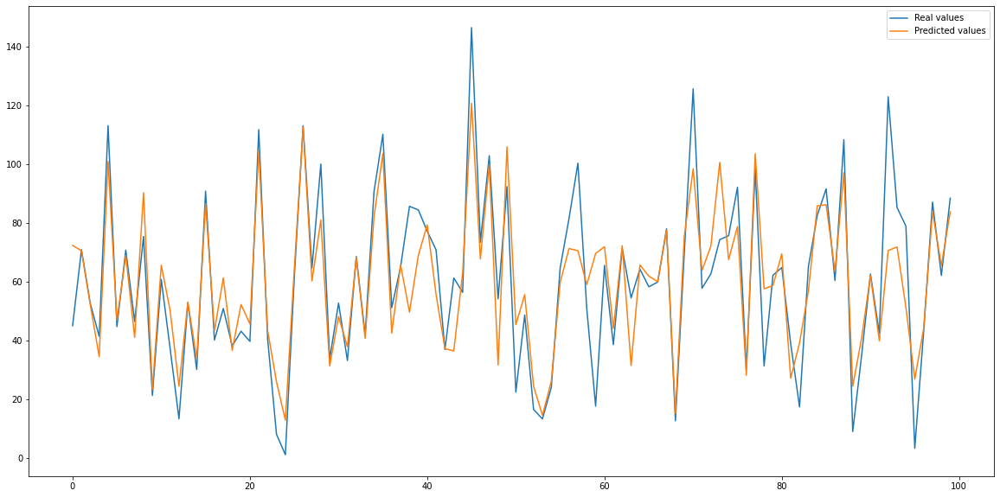

MAE = 1.95 9.32
MSE = 31.64 156.92
RMSE = 5.63 12.53
R2 = 0.96 0.79
AQI accuracy = 0.9723031954812972 0.8697190886971908
AQI accuracy+-1 = 0.9999684006793854 0.9996208171390654

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitat

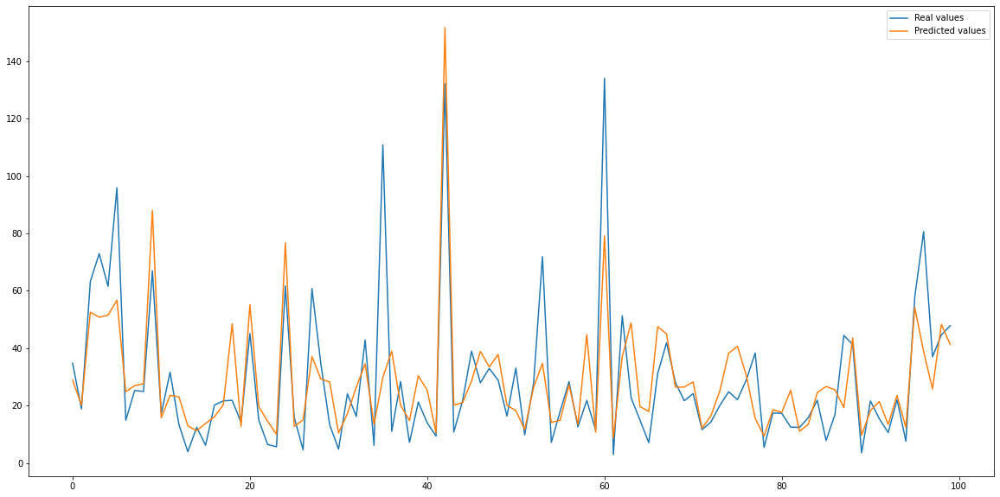

MAE = 2.05 9.75
MSE = 49.48 252.9
RMSE = 7.03 15.9
R2 = 0.92 0.56
AQI accuracy = 0.9312175217968275 0.6723881337434269
AQI accuracy+-1 = 0.995423596383525 0.9760392896120647

RandomForestRegressor(bootstrap=False, max_depth=30, max_features='sqrt',
                      n_estimators=300, n_jobs=1)
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation

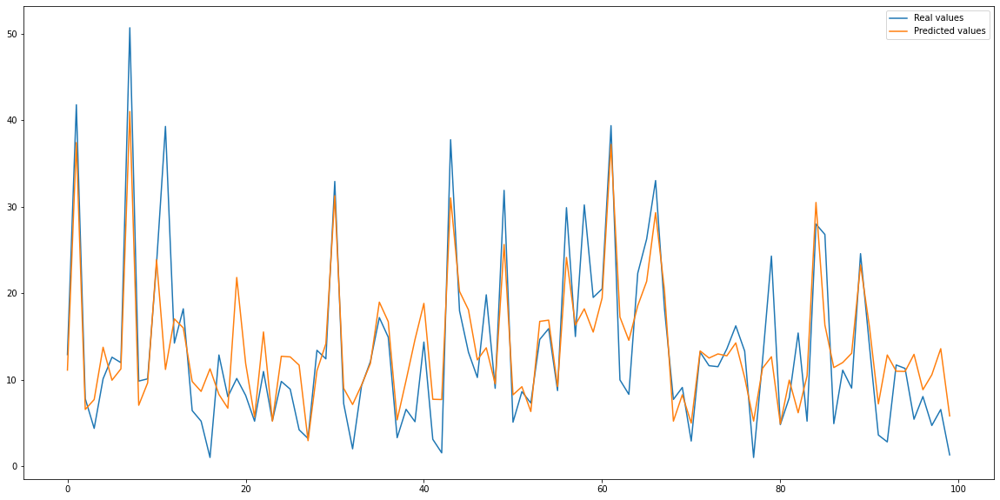

MAE = 0.97 4.72
MSE = 10.49 54.02
RMSE = 3.24 7.35
R2 = 0.94 0.7
AQI accuracy = 0.9518048166580859 0.7607825191625672
AQI accuracy+-1 = 0.9987128882787026 0.9935934103649467



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  forest = RandomForestRegressor(n_estimators=300, bootstrap=False, n_jobs=1, max_depth=30, max_features='sqrt', min_samples_leaf=1)
  testModelForVariousParameters(forest, df, [[6,7, 8, 9, 10, 11, 12, 13, 14, 15, 16]], [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16], [param], 0.2)

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: NO2, history: [1, 2, 3]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'NO2-1', 'NO2-2', 'NO2-3']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


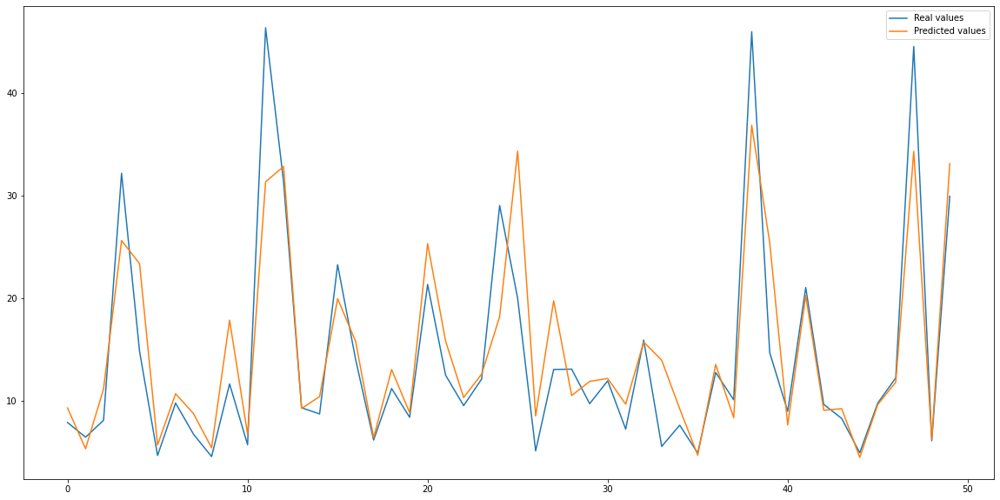

Mean absolute error = 2.85
Mean squared error = 23.97
Mean absolute percentage error = 0.23
R2 score = 0.78

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM10, history: [1, 2, 3]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM10-1', 'PM10-2', 'PM10-3']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


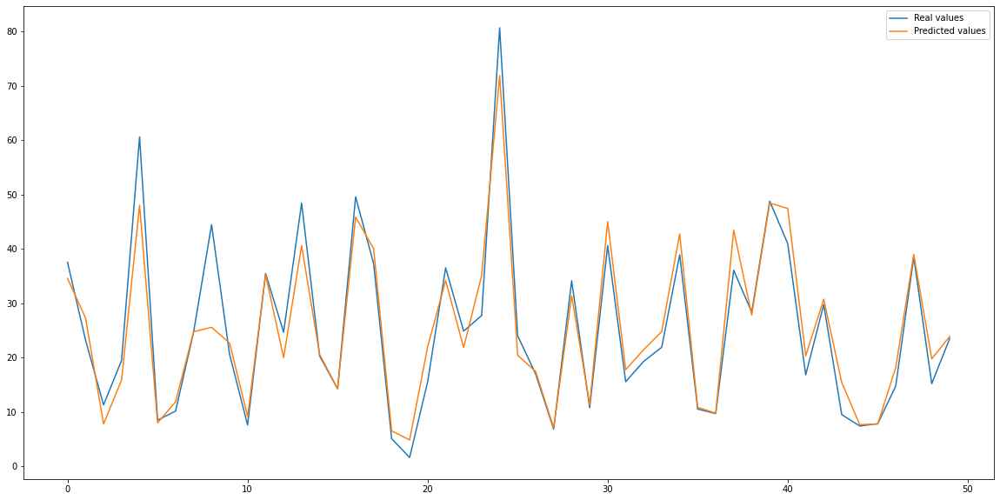

Mean absolute error = 3.76
Mean squared error = 31.36
Mean absolute percentage error = 0.25
R2 score = 0.86

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM25, history: [1, 2, 3]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM25-1', 'PM25-2', 'PM25-3']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


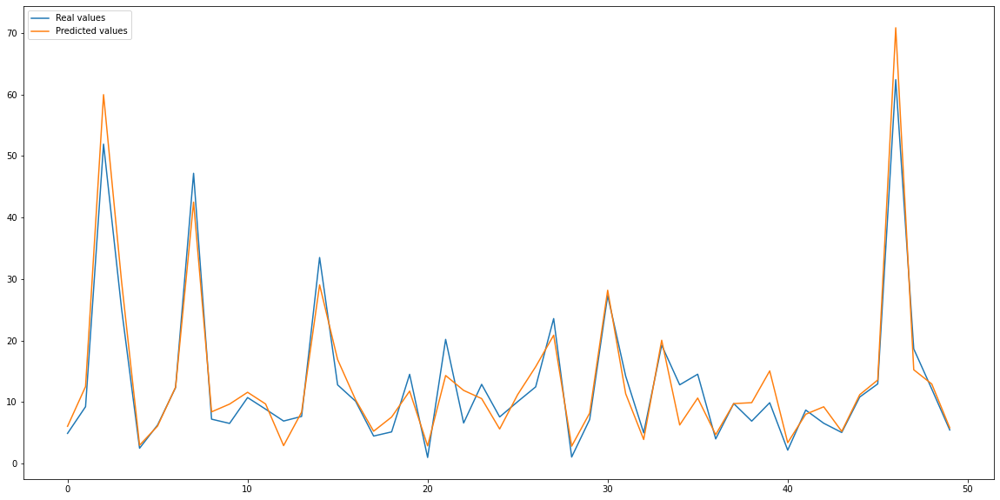

Mean absolute error = 2.79
Mean squared error = 17.78
Mean absolute percentage error = 0.39
R2 score = 0.89

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: O3, history: [1, 2, 3]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'O3-1', 'O3-2', 'O3-3']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


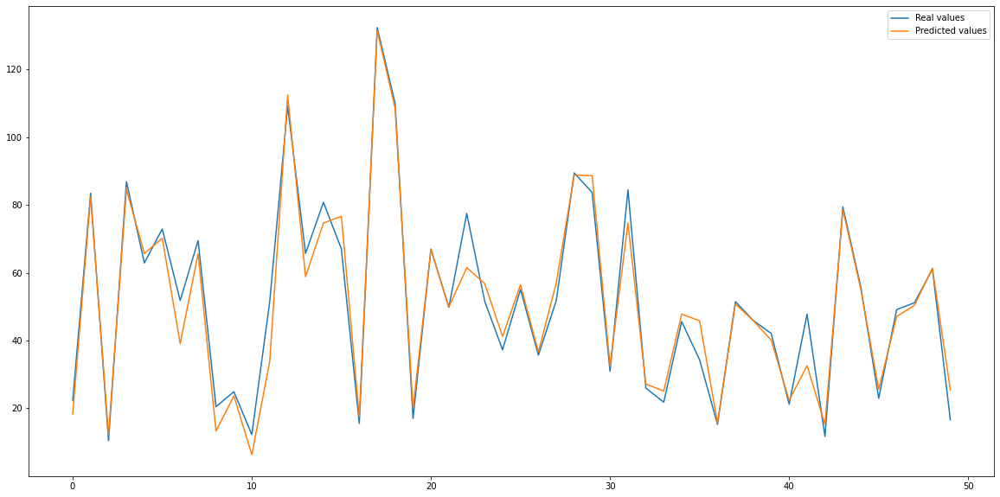

Mean absolute error = 4.43
Mean squared error = 48.2
Mean absolute percentage error = 0.17
R2 score = 0.95

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: SO2, history: [1, 2, 3]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'SO2-1', 'SO2-2', 'SO2-3']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


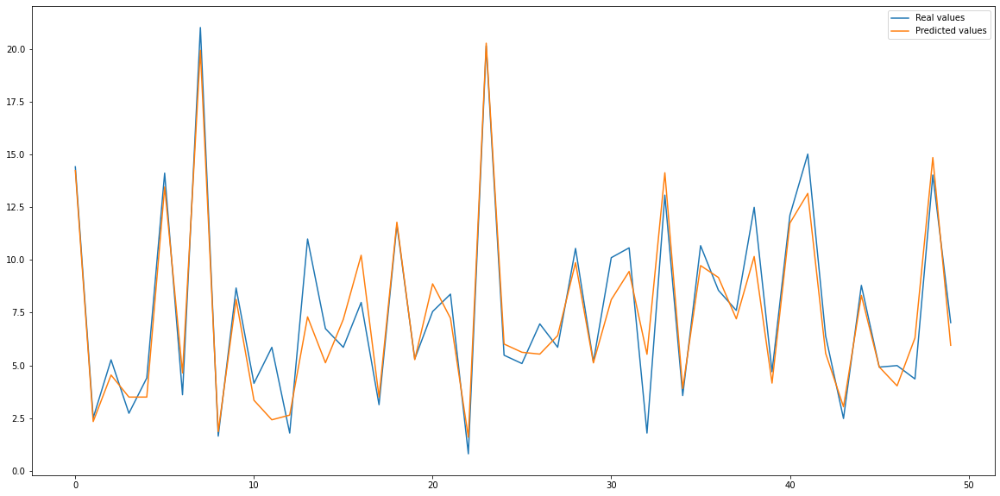

Mean absolute error = 0.87
Mean squared error = 1.57
Mean absolute percentage error = 2418650570909.97
R2 score = 0.89

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: NO2, history: [2, 4, 6]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'NO2-2', 'NO2-4', 'NO2-6']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


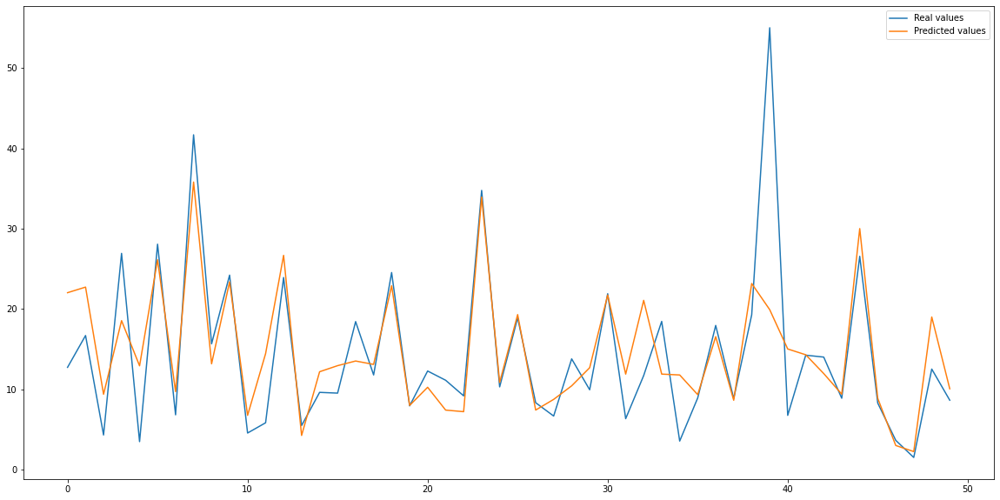

Mean absolute error = 4.17
Mean squared error = 49.28
Mean absolute percentage error = 0.4
R2 score = 0.55

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM10, history: [2, 4, 6]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM10-2', 'PM10-4', 'PM10-6']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


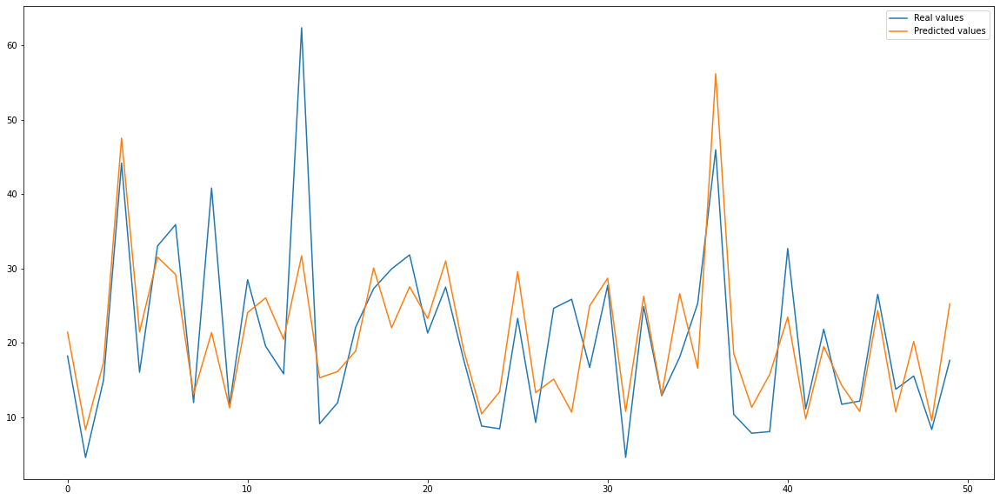

Mean absolute error = 4.93
Mean squared error = 53.32
Mean absolute percentage error = 0.32
R2 score = 0.76

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM25, history: [2, 4, 6]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM25-2', 'PM25-4', 'PM25-6']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


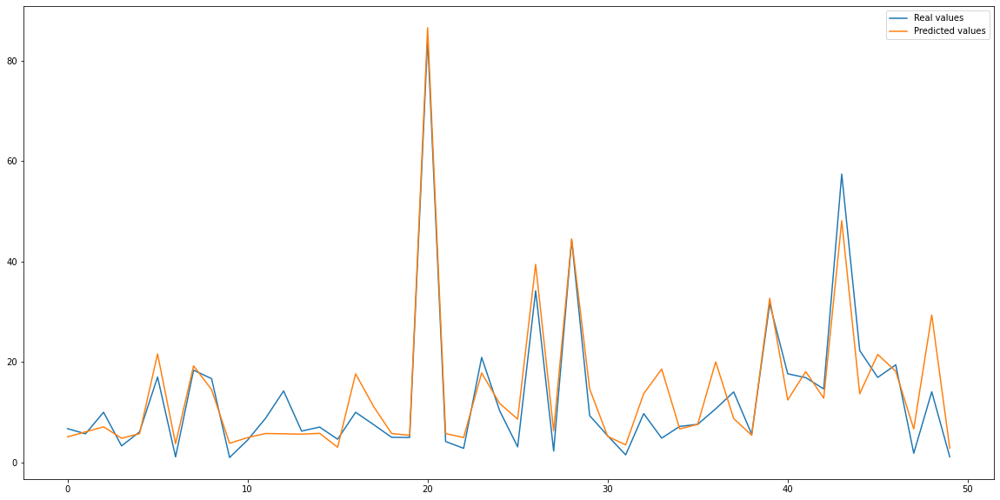

Mean absolute error = 3.65
Mean squared error = 29.59
Mean absolute percentage error = 0.55
R2 score = 0.81

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: O3, history: [2, 4, 6]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'O3-2', 'O3-4', 'O3-6']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


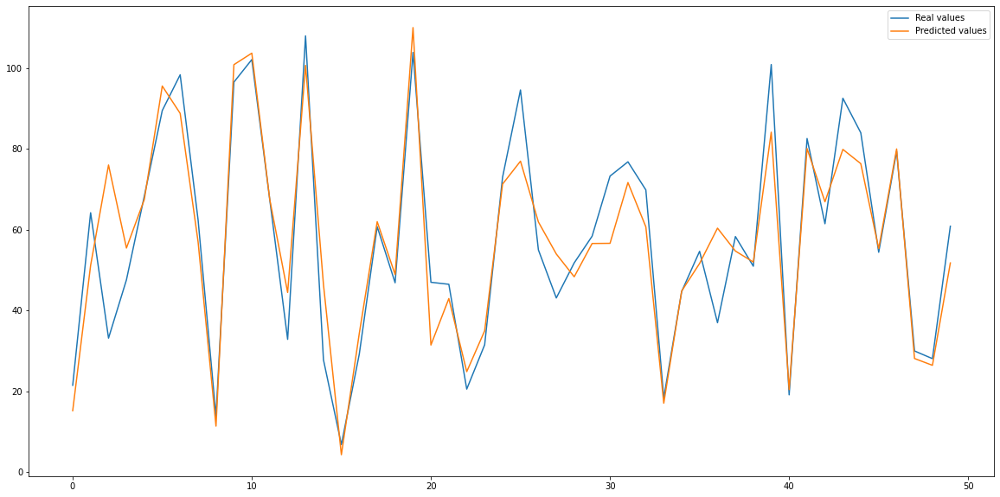

Mean absolute error = 6.63
Mean squared error = 94.85
Mean absolute percentage error = 3187982830446.41
R2 score = 0.89

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: SO2, history: [2, 4, 6]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'SO2-2', 'SO2-4', 'SO2-6']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


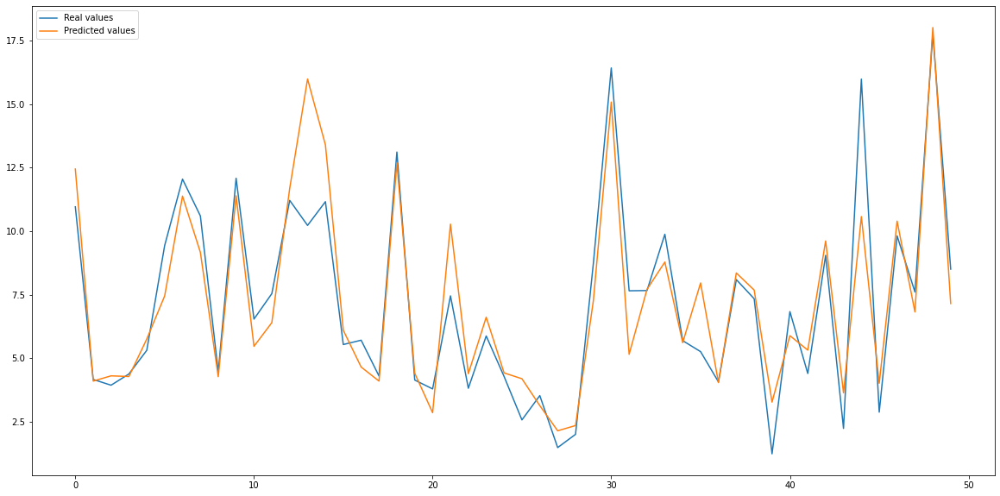

Mean absolute error = 1.05
Mean squared error = 2.58
Mean absolute percentage error = 0.21
R2 score = 0.83

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: NO2, history: [2, 4, 6, 8]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'NO2-2', 'NO2-4', 'NO2-6', 'NO2-8']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


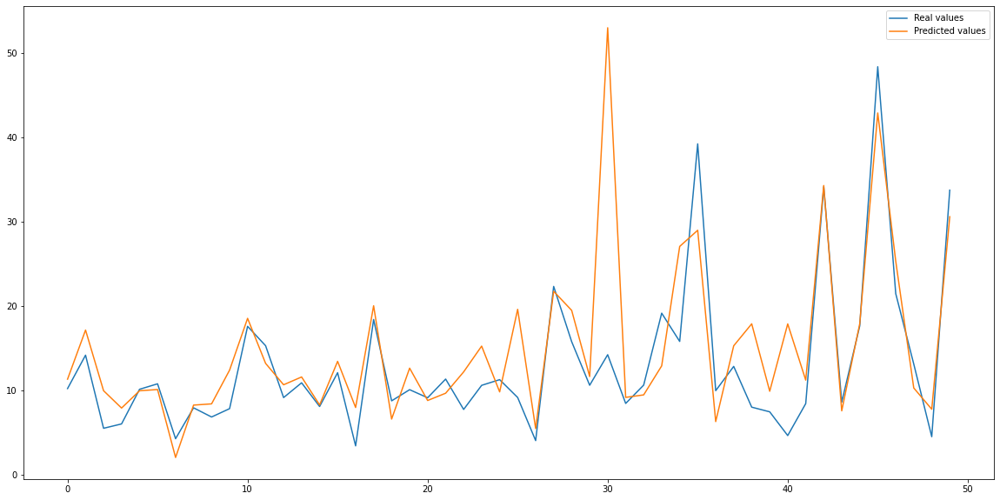

Mean absolute error = 4.15
Mean squared error = 51.87
Mean absolute percentage error = 0.36
R2 score = 0.54

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM10, history: [2, 4, 6, 8]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM10-2', 'PM10-4', 'PM10-6', 'PM10-8']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


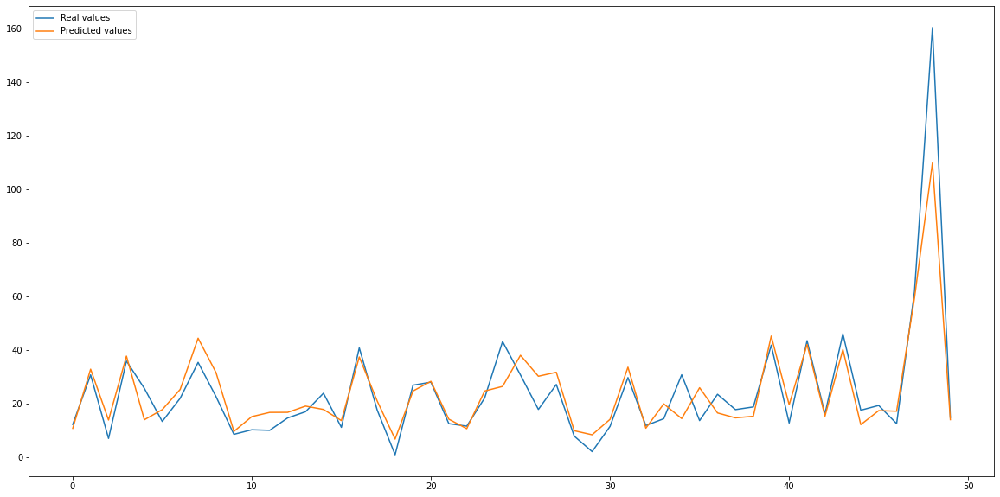

Mean absolute error = 4.83
Mean squared error = 57.14
Mean absolute percentage error = 0.31
R2 score = 0.73

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM25, history: [2, 4, 6, 8]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM25-2', 'PM25-4', 'PM25-6', 'PM25-8']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


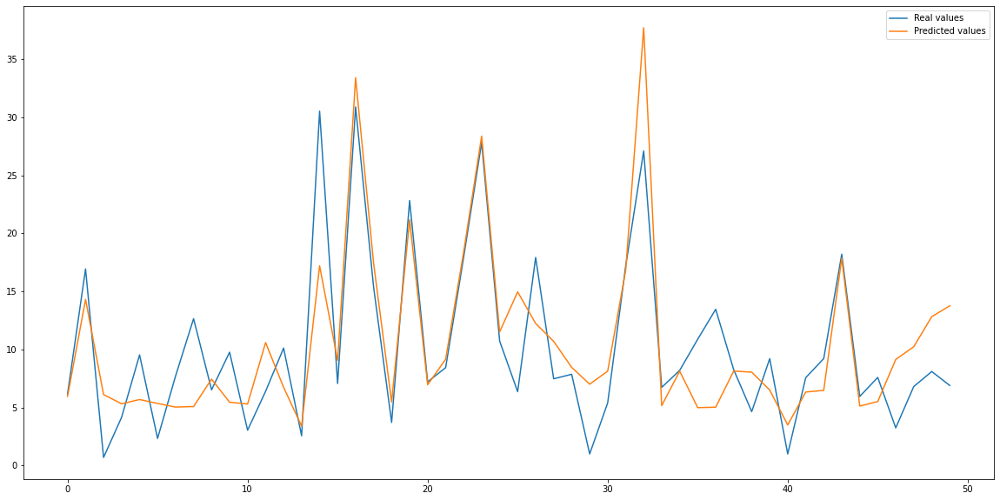

Mean absolute error = 3.59
Mean squared error = 28.25
Mean absolute percentage error = 0.53
R2 score = 0.82

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: O3, history: [2, 4, 6, 8]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'O3-2', 'O3-4', 'O3-6', 'O3-8']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


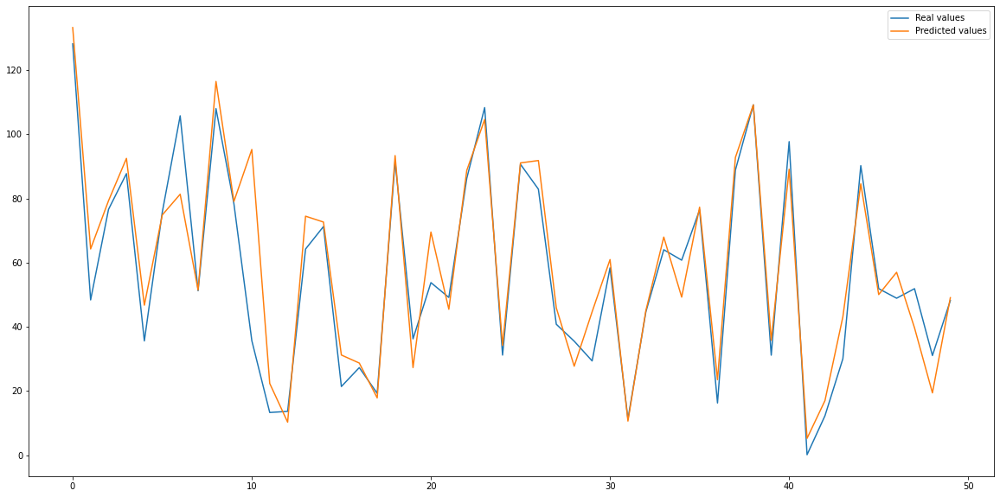

Mean absolute error = 6.71
Mean squared error = 94.41
Mean absolute percentage error = 0.31
R2 score = 0.9

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: SO2, history: [2, 4, 6, 8]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'SO2-2', 'SO2-4', 'SO2-6', 'SO2-8']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


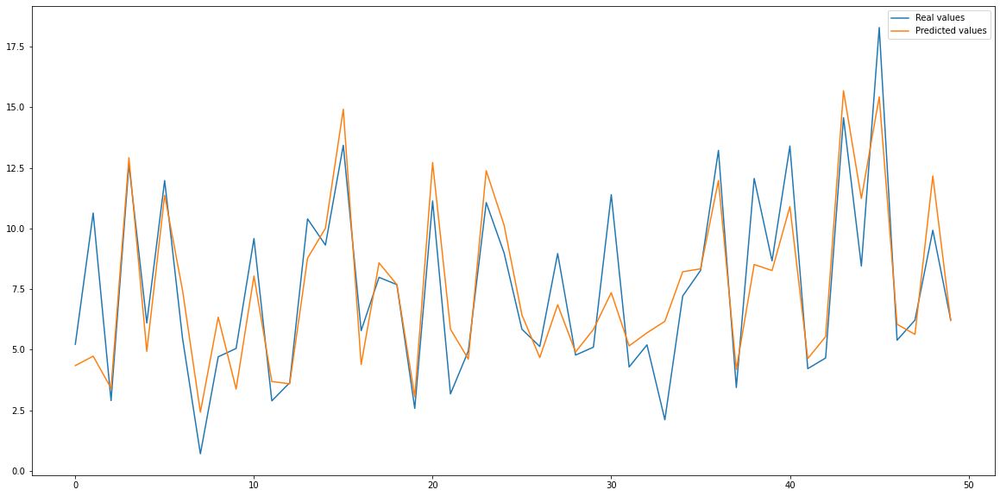

Mean absolute error = 1.03
Mean squared error = 2.41
Mean absolute percentage error = 0.22
R2 score = 0.83

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: NO2, history: [4, 8, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'NO2-4', 'NO2-8', 'NO2-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


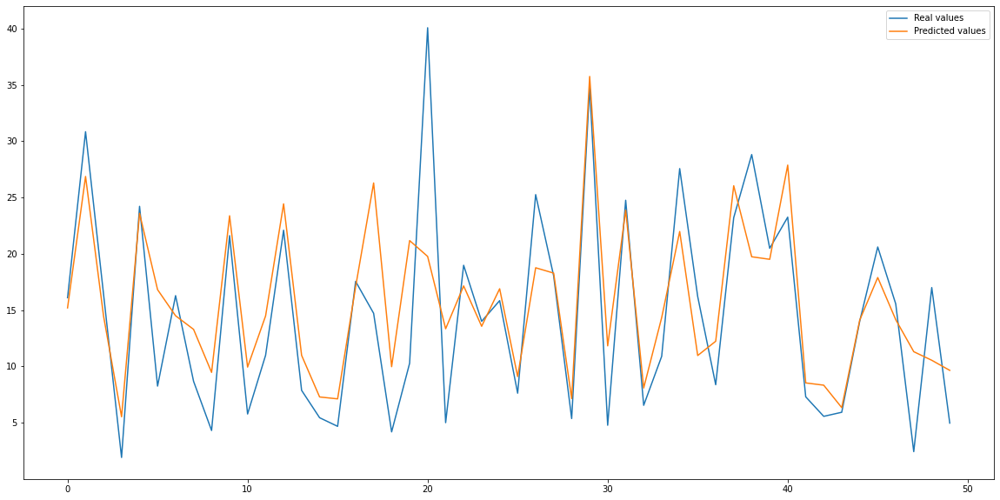

Mean absolute error = 4.74
Mean squared error = 50.45
Mean absolute percentage error = 0.49
R2 score = 0.54

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM10, history: [4, 8, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM10-4', 'PM10-8', 'PM10-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


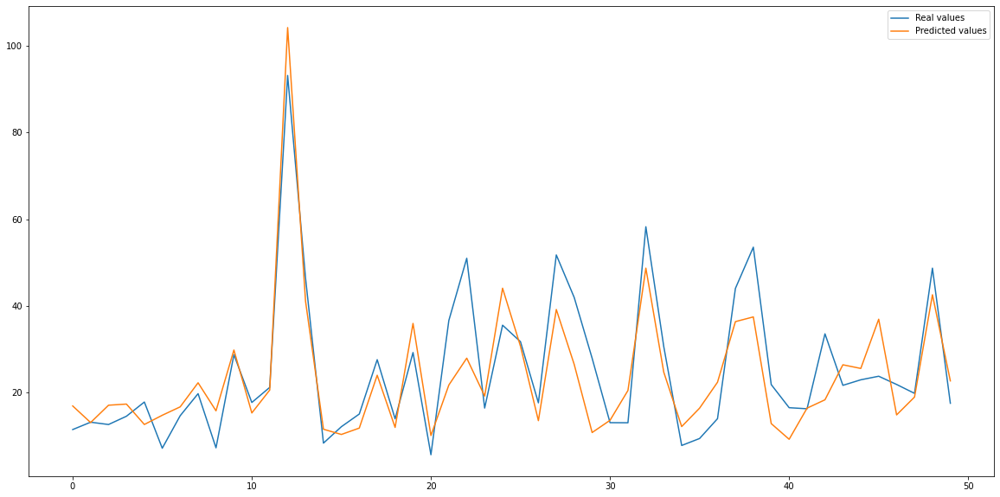

Mean absolute error = 5.62
Mean squared error = 63.52
Mean absolute percentage error = 0.39
R2 score = 0.69

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM25, history: [4, 8, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM25-4', 'PM25-8', 'PM25-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


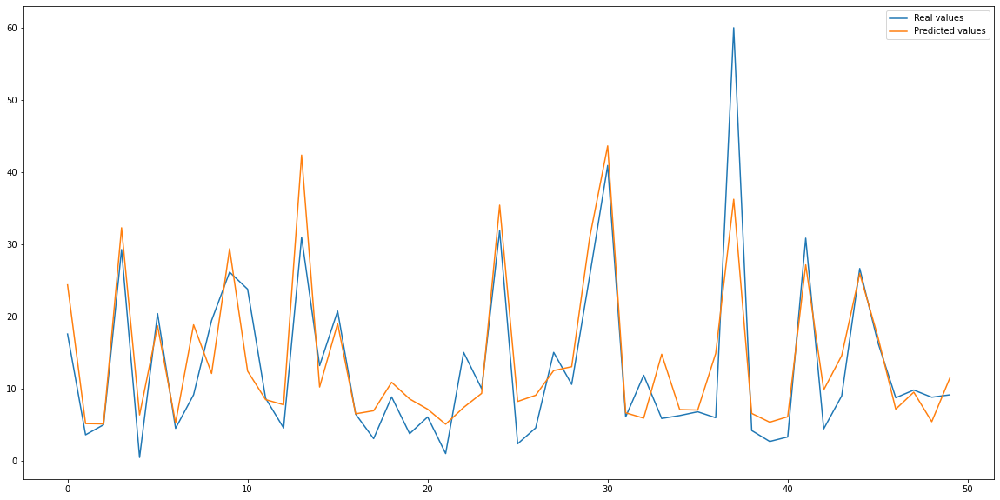

Mean absolute error = 4.13
Mean squared error = 35.29
Mean absolute percentage error = 0.69
R2 score = 0.75

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: O3, history: [4, 8, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'O3-4', 'O3-8', 'O3-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


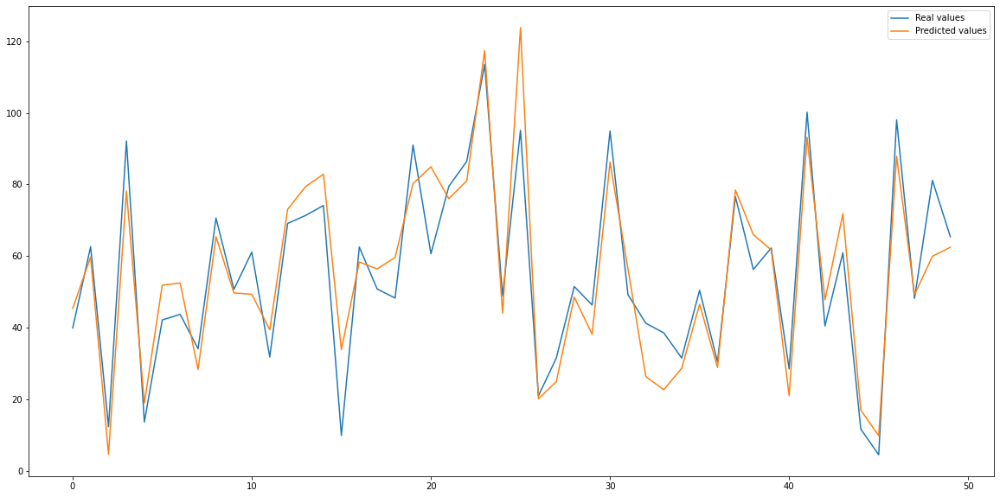

Mean absolute error = 8.11
Mean squared error = 124.69
Mean absolute percentage error = 0.61
R2 score = 0.86

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: SO2, history: [4, 8, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'SO2-4', 'SO2-8', 'SO2-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


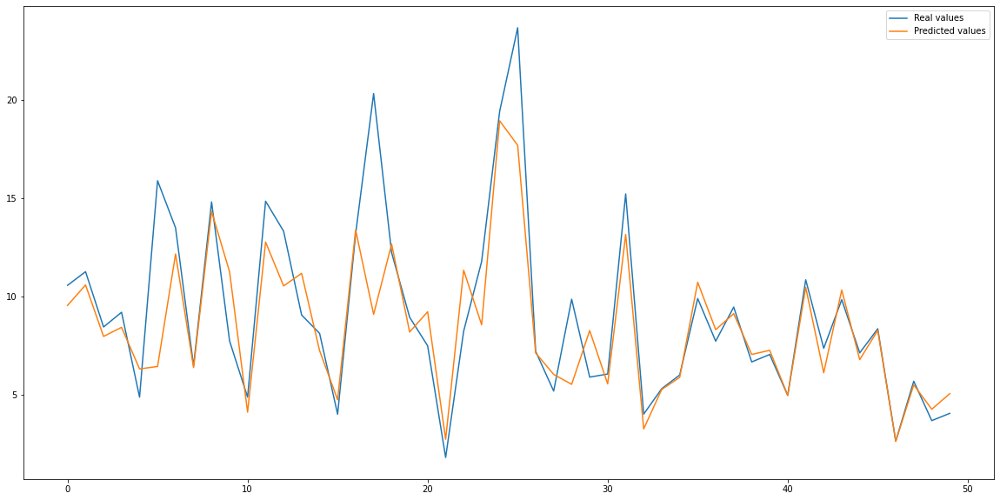

Mean absolute error = 1.19
Mean squared error = 3.0
Mean absolute percentage error = 0.26
R2 score = 0.8

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: NO2, history: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'NO2-1', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11', 'NO2-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


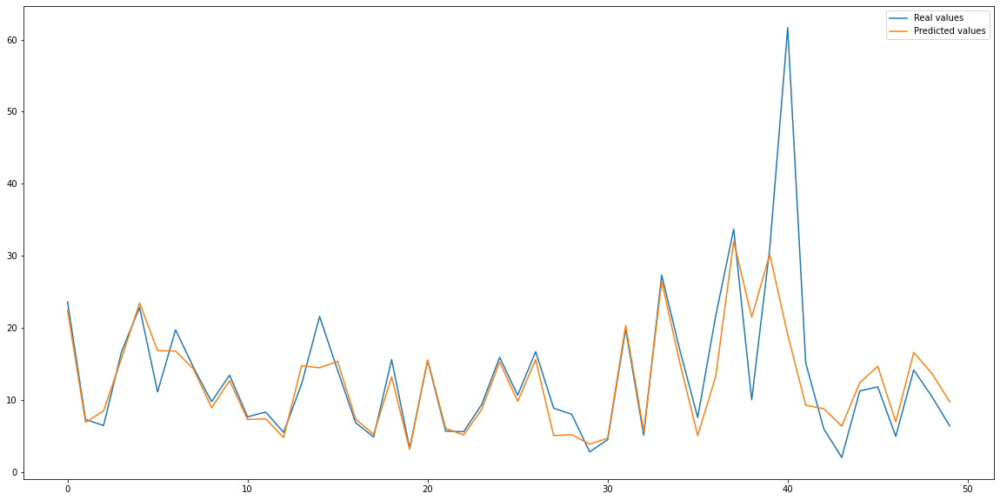

Mean absolute error = 2.89
Mean squared error = 25.42
Mean absolute percentage error = 0.23
R2 score = 0.79

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM10, history: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM10-1', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9', 'PM10-10', 'PM10-11', 'PM10-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


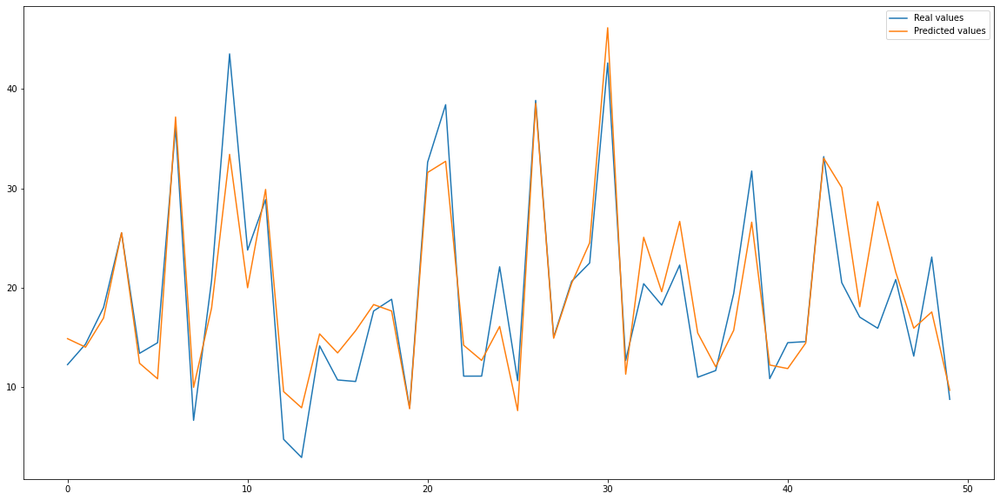

Mean absolute error = 3.64
Mean squared error = 30.63
Mean absolute percentage error = 0.24
R2 score = 0.85

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: PM25, history: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'PM25-1', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9', 'PM25-10', 'PM25-11', 'PM25-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


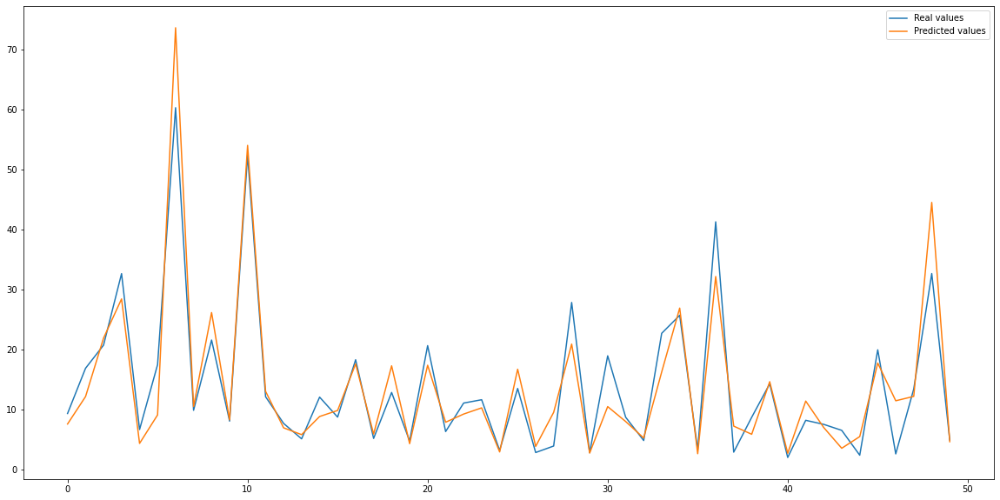

Mean absolute error = 2.8
Mean squared error = 18.37
Mean absolute percentage error = 0.4
R2 score = 0.88

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: O3, history: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'O3-1', 'O3-2', 'O3-3', 'O3-4', 'O3-5', 'O3-6', 'O3-7', 'O3-8', 'O3-9', 'O3-10', 'O3-11', 'O3-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


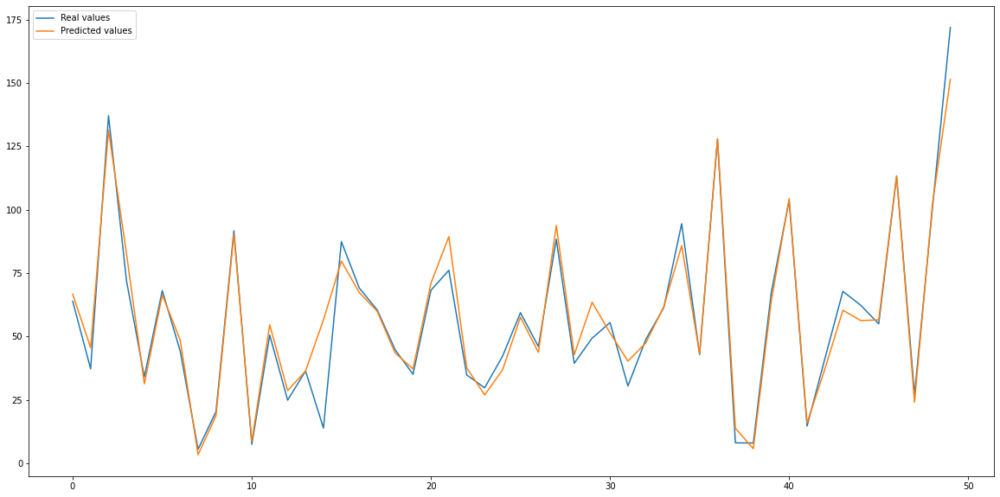

Mean absolute error = 4.48
Mean squared error = 48.67
Mean absolute percentage error = 0.24
R2 score = 0.95

GridSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': (10, 20, 30, 50),
                         'min_samples_leaf': (1, 2, 3, 4),
                         'n_estimators': (100, 200, 500)},
             verbose=2)
Param: SO2, history: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]:
['month', 'weekday', 'temperature', 'precipitation_1', 'humidity', 'wind', 'SO2-1', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9', 'SO2-10', 'SO2-11', 'SO2-12']
Fitting 5 folds for each of 48 candidates, totalling 240 fits


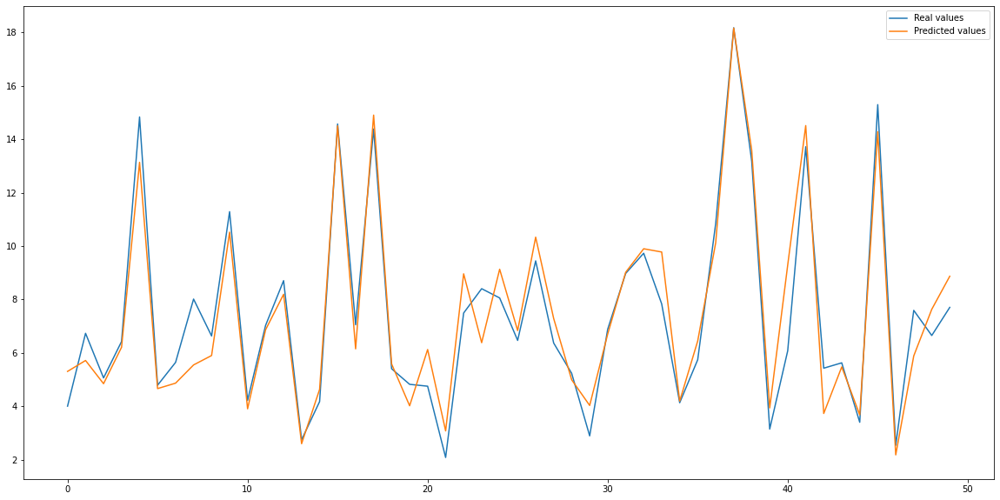

Mean absolute error = 0.85
Mean squared error = 1.48
Mean absolute percentage error = 0.16
R2 score = 0.89



In [ ]:
for hour in [[1,2,3], [2, 4, 6], [2, 4, 6, 8], [4, 8, 12], [1,2,3,4,5,6,7,8,9,10,11,12]]:
    for param in ['NO2', 'PM10', 'PM25', 'O3', 'SO2']:
        gsc = GridSearchCV(estimator=RandomForestRegressor(),
                param_grid={
                    'max_depth': (10, 20, 30, 50),
                    'n_estimators': (100, 200, 500),
                    'min_samples_leaf': (1, 2, 3, 4),
                },
                cv=5,
                n_jobs=-1,
                verbose=2)
        testModelForVariousParameters(gsc, df, [hour], [*conditions, 'NO2', 'PM10', 'PM25', 'O3', 'SO2'], [], [param], 0.2)

In [ ]:
!wget https://developer.nvidia.com/compute/cuda/9.0/Prod/local_installers/cuda-repo-ubuntu1704-9-0-local_9.0.176-1_amd64-deb

!ls # Check if required cuda 9.0 amd64-deb file is downloaded

!dpkg -i cuda-repo-ubuntu1704-9-0-local_9.0.176-1_amd64-deb

!ls /var/cuda-repo-9-0-local | grep .pub

!apt-key add /var/cuda-repo-9-0-local/7fa2af80.pub

!apt-get update

!sudo apt-get install cuda-9.0

--2022-06-17 17:26:55--  https://developer.nvidia.com/compute/cuda/9.0/Prod/local_installers/cuda-repo-ubuntu1704-9-0-local_9.0.176-1_amd64-deb
Resolving developer.nvidia.com (developer.nvidia.com)... 152.195.19.142
Connecting to developer.nvidia.com (developer.nvidia.com)|152.195.19.142|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://developer.nvidia.com/compute/cuda/9.0/prod/local_installers/cuda-repo-ubuntu1704-9-0-local_9.0.176-1_amd64-deb [following]
--2022-06-17 17:26:56--  https://developer.nvidia.com/compute/cuda/9.0/prod/local_installers/cuda-repo-ubuntu1704-9-0-local_9.0.176-1_amd64-deb
Reusing existing connection to developer.nvidia.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://developer.download.nvidia.com/compute/cuda/9.0/secure/Prod/local_installers/cuda-repo-ubuntu1704-9-0-local_9.0.176-1_amd64.deb?lzQhtgcMLmsG66cvnCcmJUw5KobDN3lvgRyqxhrXvLsps4j55hNpSUdMEEddTbRqNovmUhov2Q-jY5X5RJzBy7exuxl-M

In [ ]:
!pip install thundersvm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 507 kB 5.4 MB/s 


In [ ]:
!git clone https://github.com/Xtra-Computing/thundersvm.git
!cd thundersvm && git submodule update --init src/test/googletest

Cloning into 'thundersvm'...
remote: Enumerating objects: 7101, done.
remote: Counting objects: 100% (110/110), done.
remote: Compressing objects: 100% (62/62), done.
remote: Total 7101 (delta 46), reused 105 (delta 46), pack-reused 6991
Receiving objects: 100% (7101/7101), 4.80 MiB | 14.94 MiB/s, done.
Resolving deltas: 100% (4776/4776), done.
Submodule 'src/test/googletest' (https://github.com/google/googletest.git) registered for path 'src/test/googletest'
Cloning into '/content/thundersvm/src/test/googletest'...
Submodule path 'src/test/googletest': checked out 'a325ad2db5deb623eab740527e559b81c0f39d65'


In [ ]:
!pip install thundersvm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 507 kB 5.0 MB/s 


In [ ]:
from thundersvm import SVR as SVR2

SVR()
Param: NO2, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'NO2-2']
-1.1185873 3.6348863


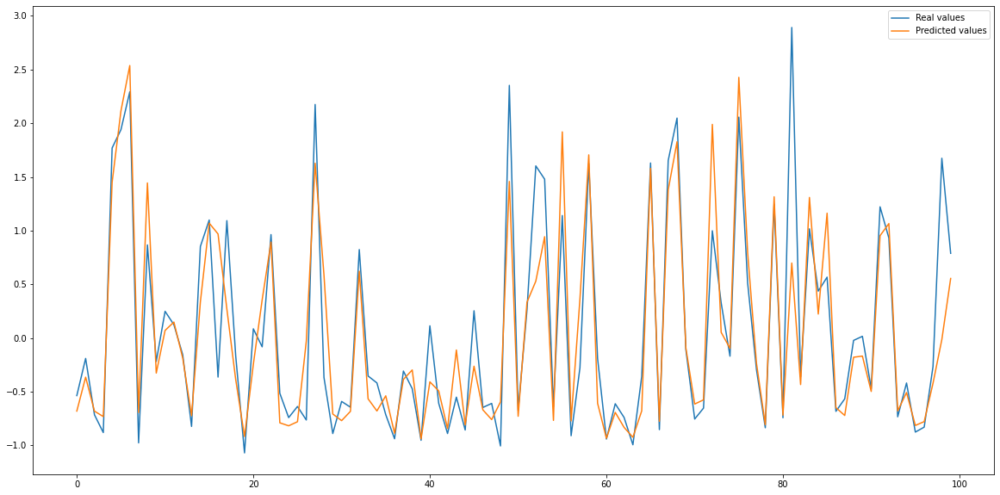

MAE = 0.27 0.29
MSE = 0.19 0.22
RMSE = 0.44 0.47
R2 = 0.81 0.78
AQI accuracy = 0.8922051199289908 0.8802953280077463
AQI accuracy+-1 = 0.9984063262794779 0.9980634229000243

SVR()
Param: SO2, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'SO2-2']
-1.1156061 7.1239076


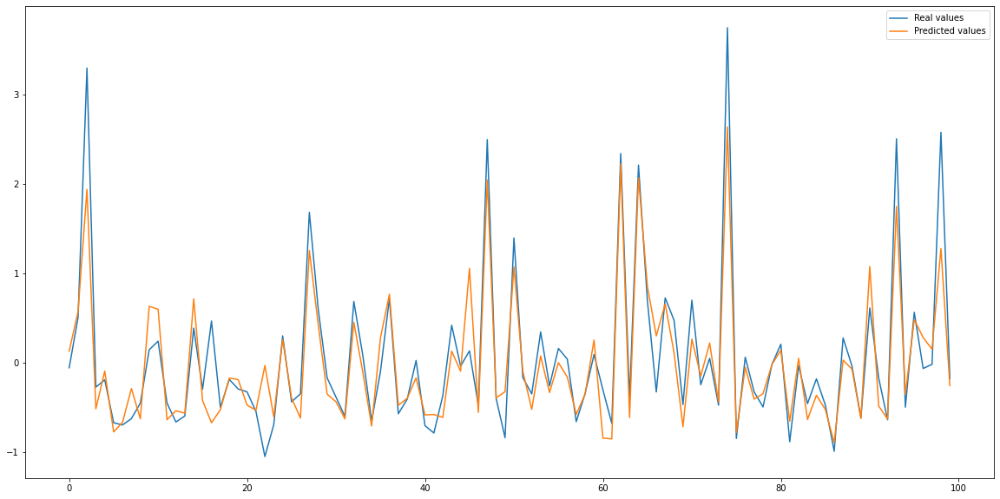

MAE = 0.22 0.25
MSE = 0.2 0.21
RMSE = 0.45 0.46
R2 = 0.8 0.78
AQI accuracy = 0.9977397066755709 0.9985617423464146
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'O3-2']
-2.09398 3.8335001


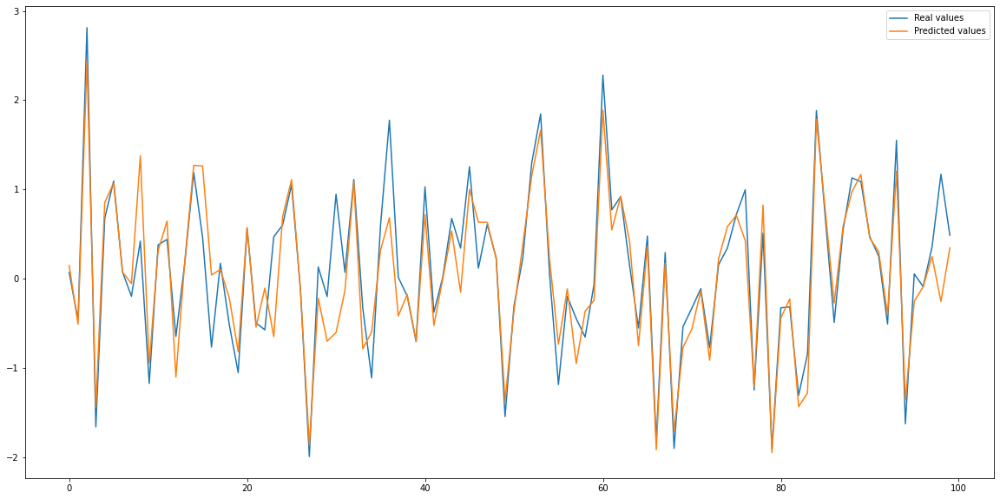

MAE = 0.23 0.25
MSE = 0.11 0.13
RMSE = 0.34 0.36
R2 = 0.89 0.87
AQI accuracy = 0.9093299899085655 0.8987186936179322
AQI accuracy+-1 = 0.9998776795816642 0.9999388397908321

SVR()
Param: PM10, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'PM10-2']
-1.1365833 5.743545


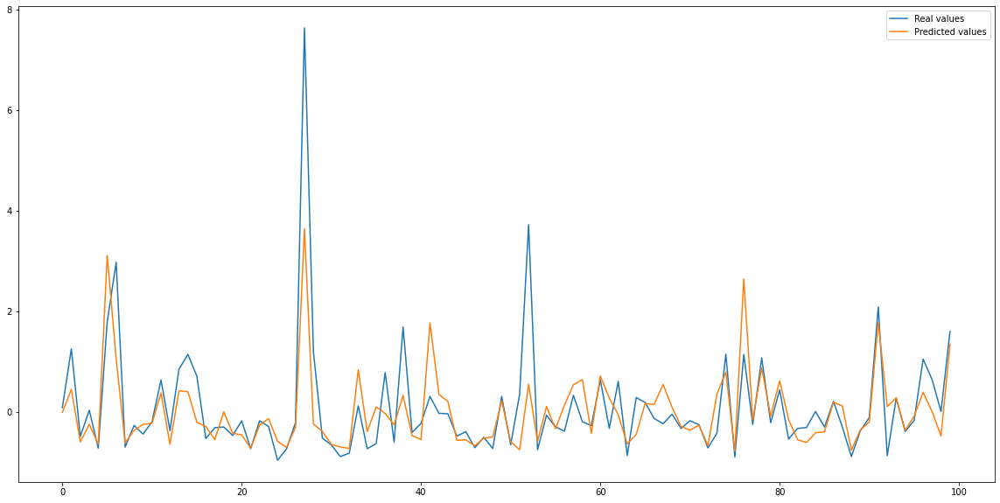

MAE = 0.3 0.34
MSE = 0.31 0.39
RMSE = 0.56 0.63
R2 = 0.68 0.63
AQI accuracy = 0.765096820463782 0.7464977289027014
AQI accuracy+-1 = 0.9827516136743963 0.9792971551518049

SVR()
Param: PM25, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'PM25-2']
-1.1428176 7.128891


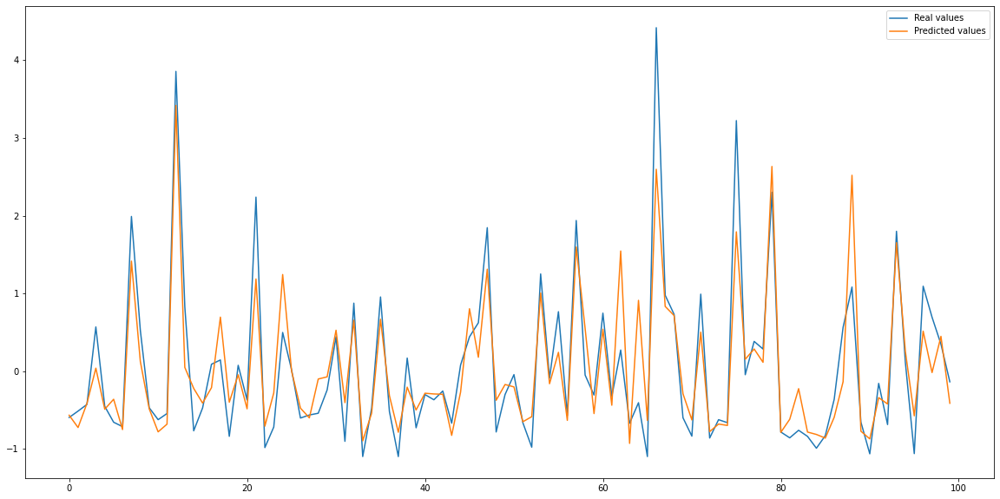

MAE = 0.27 0.31
MSE = 0.22 0.25
RMSE = 0.47 0.5
R2 = 0.78 0.75
AQI accuracy = 0.8255704029229157 0.798978027593255
AQI accuracy+-1 = 0.9947367076317739 0.9944813490035769



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  svr = SVR2()
  testModelForVariousParameters(svr, df, [[2]], [2], [param], 0.2)

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5', 'NO2-6', 'NO2-7']
-1.2327735 2.9906743


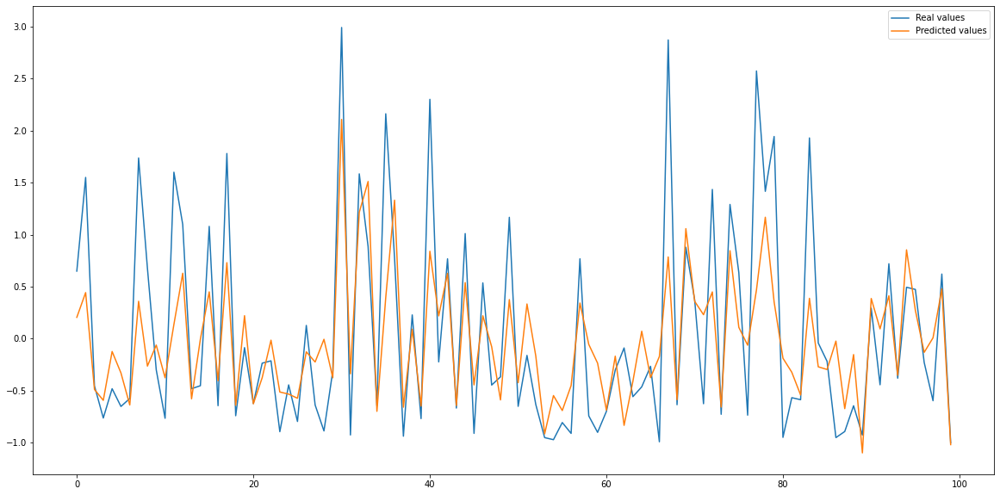

MAE = 0.24 0.48
MSE = 0.18 0.48
RMSE = 0.43 0.7
R2 = 0.82 0.52
AQI accuracy = 0.9217976493244162 0.8398710595721522
AQI accuracy+-1 = 0.9975823416747779 0.9913341985180224

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5', 'SO2-6', 'SO2-7']
-1.0145013 5.2440715


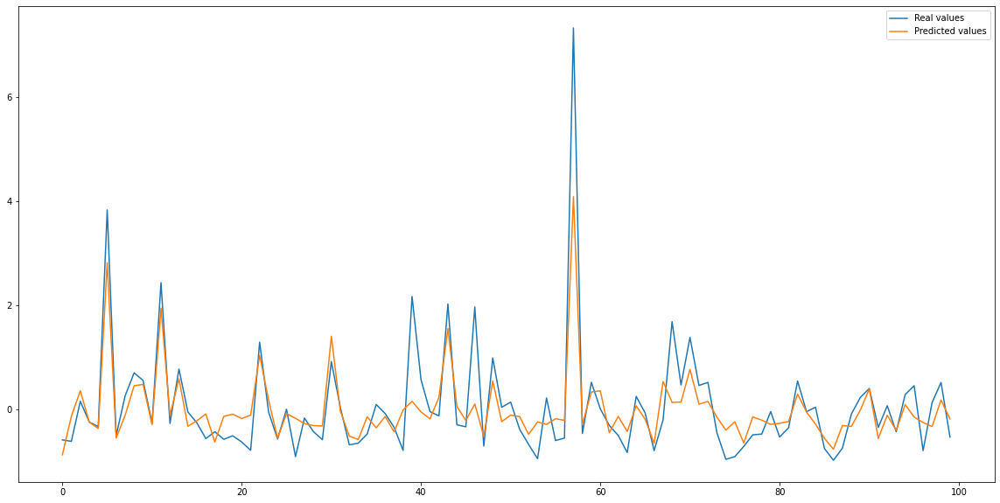

MAE = 0.21 0.4
MSE = 0.26 0.54
RMSE = 0.51 0.74
R2 = 0.74 0.5
AQI accuracy = 0.9980742629309176 0.9965285311347364
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'O3-2', 'O3-3', 'O3-4', 'O3-5', 'O3-6', 'O3-7']
-2.2755787 2.7653472


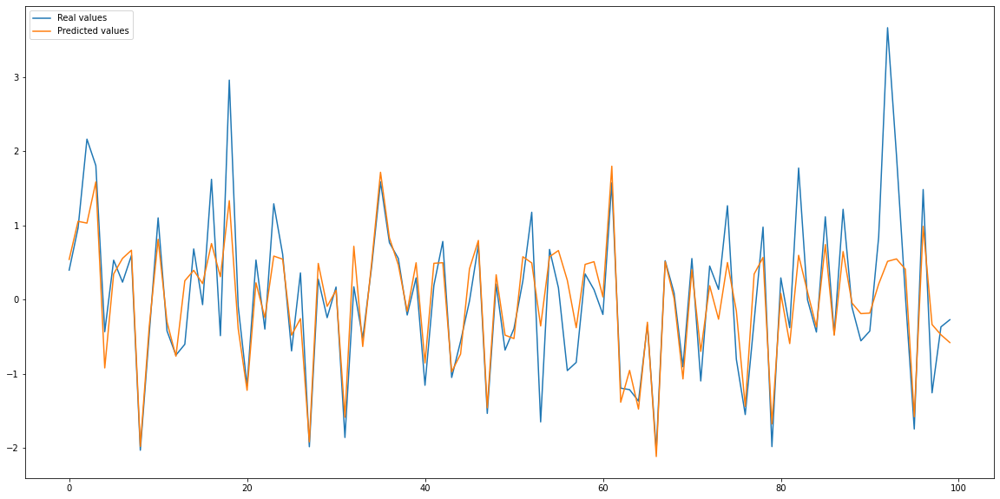

MAE = 0.18 0.37
MSE = 0.09 0.28
RMSE = 0.3 0.53
R2 = 0.91 0.72
AQI accuracy = 0.9305741091677281 0.8458168939699897
AQI accuracy+-1 = 0.9990835378545466 0.9991612041380595

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5', 'PM10-6', 'PM10-7']
-1.1109136 5.0092473


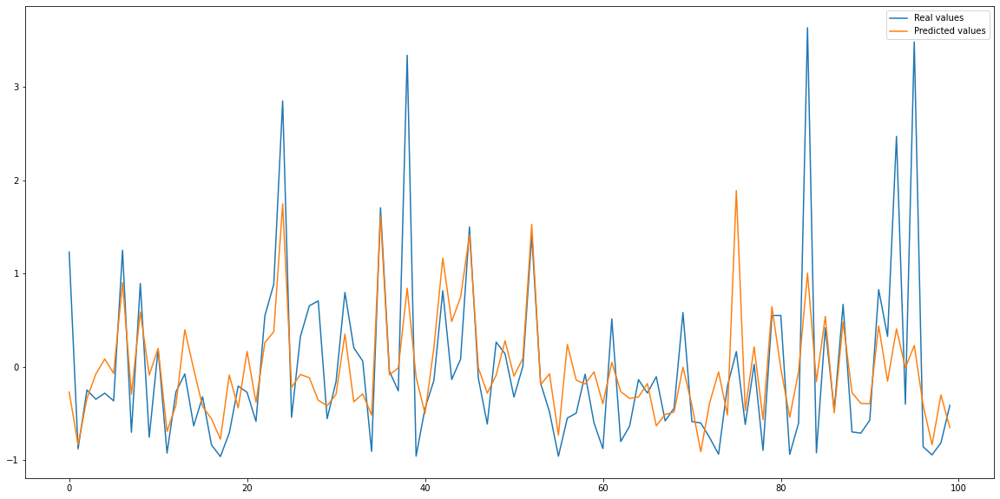

MAE = 0.24 0.43
MSE = 0.33 0.54
RMSE = 0.57 0.74
R2 = 0.67 0.44
AQI accuracy = 0.8140785439680763 0.6272992700729927
AQI accuracy+-1 = 0.9822984086816877 0.9722627737226277

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5', 'PM25-6', 'PM25-7']
-1.1882069 4.462228


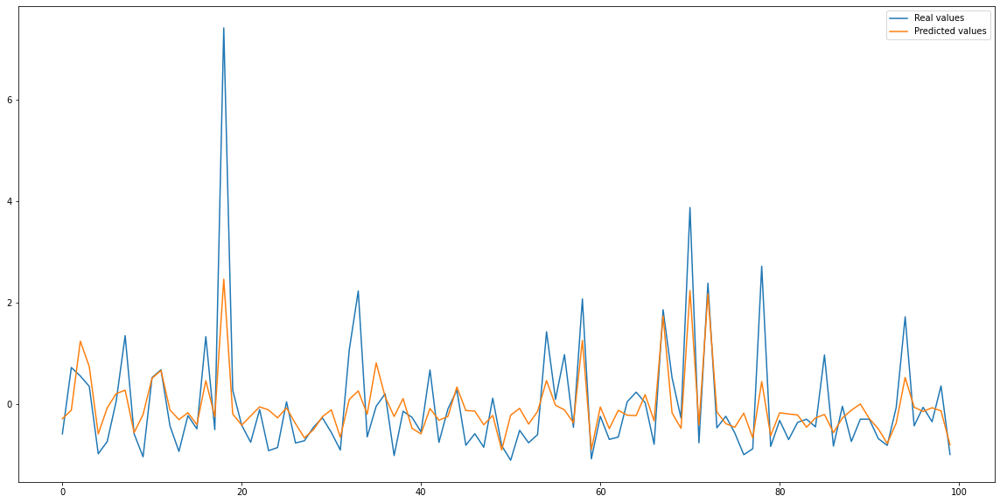

MAE = 0.23 0.43
MSE = 0.26 0.51
RMSE = 0.51 0.72
R2 = 0.74 0.5
AQI accuracy = 0.8667956261250369 0.729959166129379
AQI accuracy+-1 = 0.9896026436688966 0.9874274661508704

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5', 'NO2-6', 'NO2-7']
-1.2327735 2.9906743


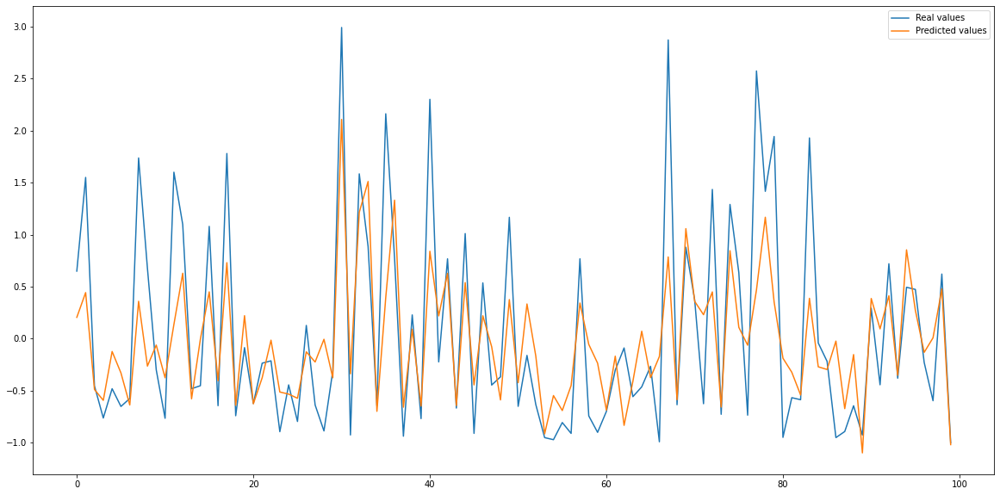

MAE = 0.24 0.48
MSE = 0.18 0.48
RMSE = 0.43 0.7
R2 = 0.82 0.52
AQI accuracy = 0.9217976493244162 0.8398710595721522
AQI accuracy+-1 = 0.9975823416747779 0.9913341985180224

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5', 'SO2-6', 'SO2-7']
-1.0145013 5.2440715


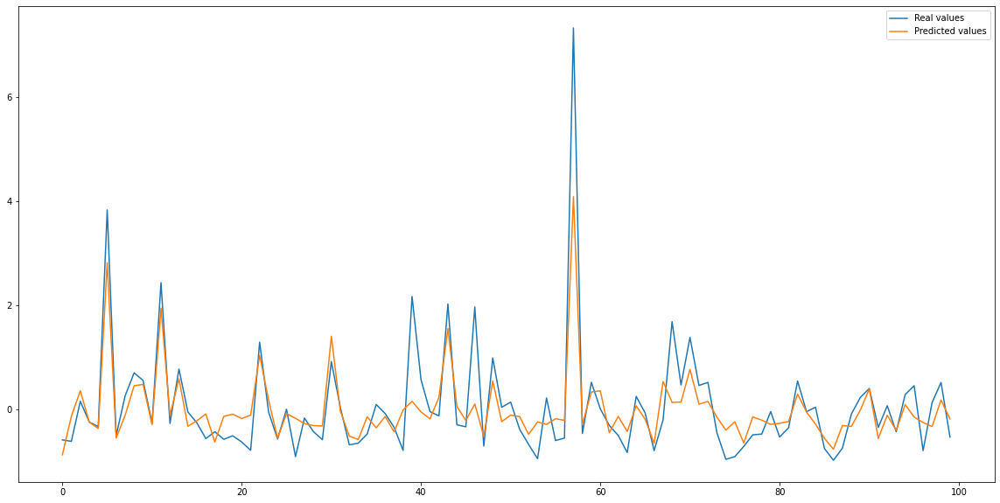

MAE = 0.21 0.4
MSE = 0.26 0.54
RMSE = 0.51 0.74
R2 = 0.74 0.5
AQI accuracy = 0.9980742629309176 0.9965285311347364
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'O3-2', 'O3-3', 'O3-4', 'O3-5', 'O3-6', 'O3-7']
-2.2755787 2.7653472


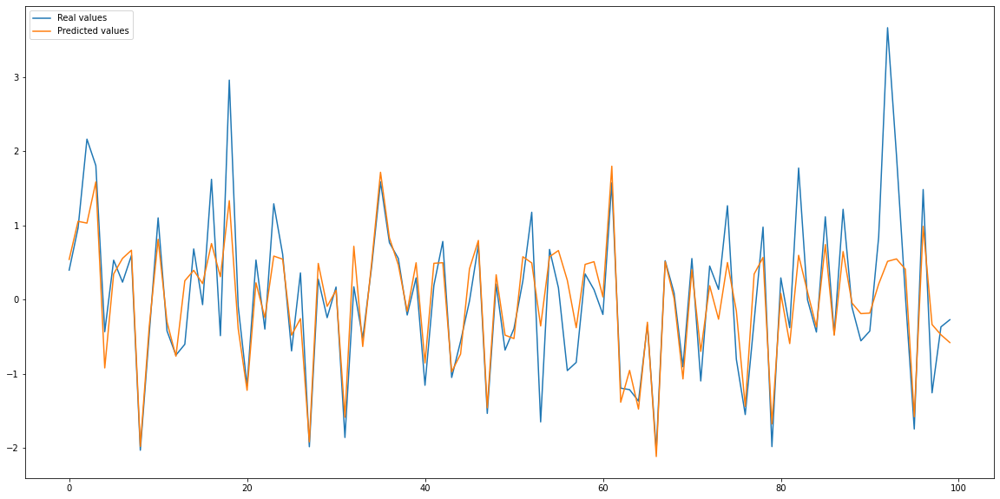

MAE = 0.18 0.37
MSE = 0.09 0.28
RMSE = 0.3 0.53
R2 = 0.91 0.72
AQI accuracy = 0.9305741091677281 0.8458168939699897
AQI accuracy+-1 = 0.9990835378545466 0.9991612041380595

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5', 'PM10-6', 'PM10-7']
-1.1109136 5.0092473


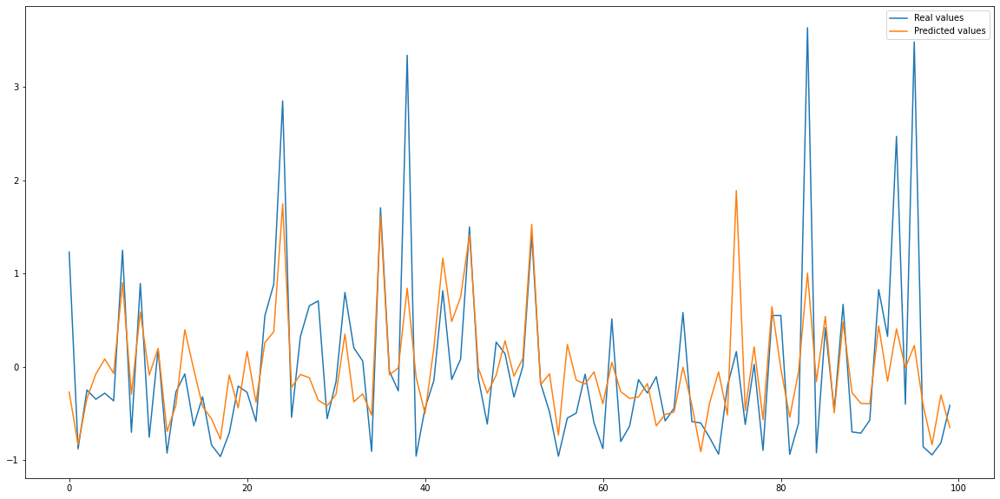

MAE = 0.24 0.43
MSE = 0.33 0.54
RMSE = 0.57 0.74
R2 = 0.67 0.44
AQI accuracy = 0.8140785439680763 0.6272992700729927
AQI accuracy+-1 = 0.9822984086816877 0.9722627737226277

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5', 'PM25-6', 'PM25-7']
-1.1882069 4.462228


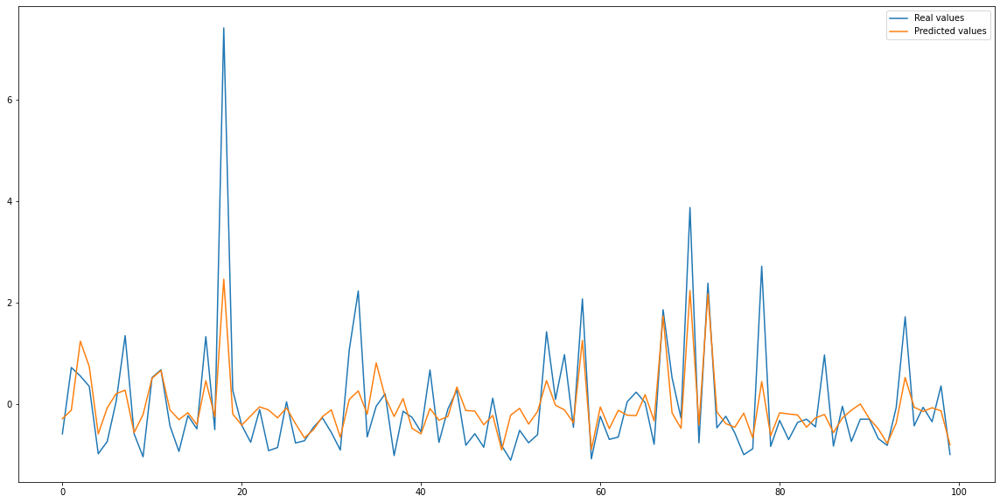

MAE = 0.23 0.43
MSE = 0.26 0.51
RMSE = 0.51 0.72
R2 = 0.74 0.5
AQI accuracy = 0.8667956261250369 0.729959166129379
AQI accuracy+-1 = 0.9896026436688966 0.9874274661508704

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5', 'NO2-6', 'NO2-7']
-1.2327735 2.9906743


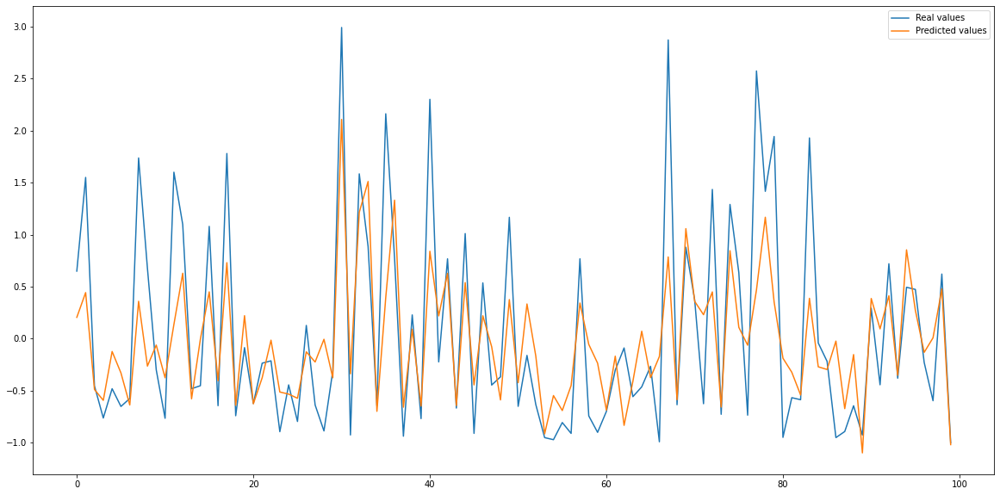

MAE = 0.24 0.48
MSE = 0.18 0.48
RMSE = 0.43 0.7
R2 = 0.82 0.52
AQI accuracy = 0.9217976493244162 0.8398710595721522
AQI accuracy+-1 = 0.9975823416747779 0.9913341985180224

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5', 'SO2-6', 'SO2-7']
-1.0145013 5.2440715


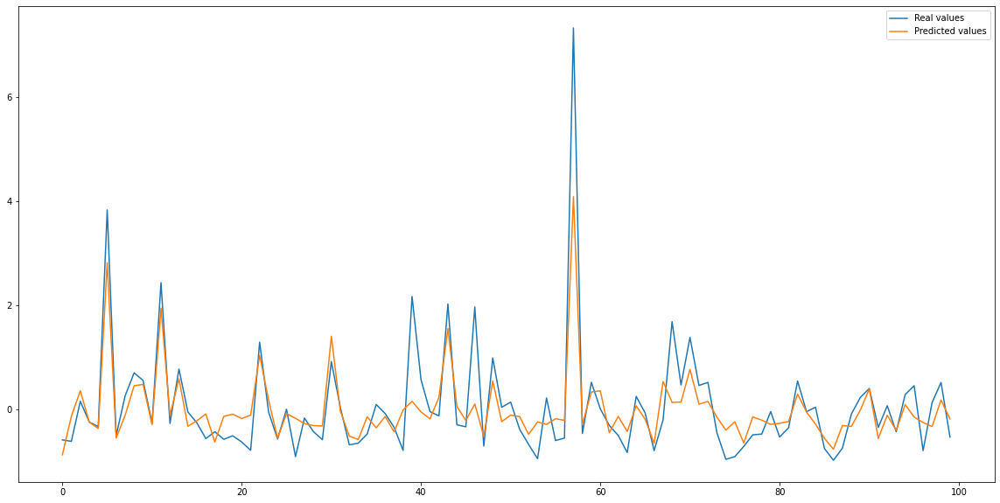

MAE = 0.21 0.4
MSE = 0.26 0.54
RMSE = 0.51 0.74
R2 = 0.74 0.5
AQI accuracy = 0.9980742629309176 0.9965285311347364
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'O3-2', 'O3-3', 'O3-4', 'O3-5', 'O3-6', 'O3-7']
-2.2755787 2.7653472


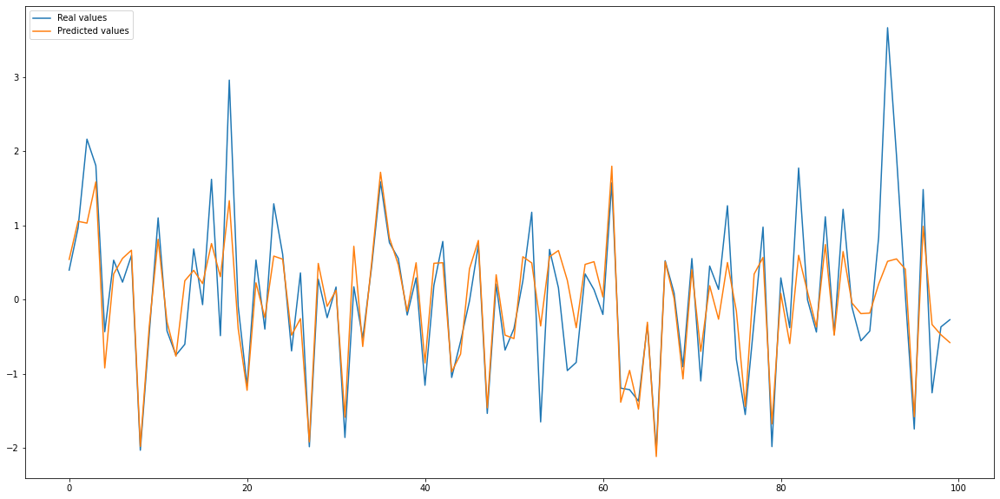

MAE = 0.18 0.37
MSE = 0.09 0.28
RMSE = 0.3 0.53
R2 = 0.91 0.72
AQI accuracy = 0.9305741091677281 0.8458168939699897
AQI accuracy+-1 = 0.9990835378545466 0.9991612041380595

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5', 'PM10-6', 'PM10-7']
-1.1109136 5.0092473


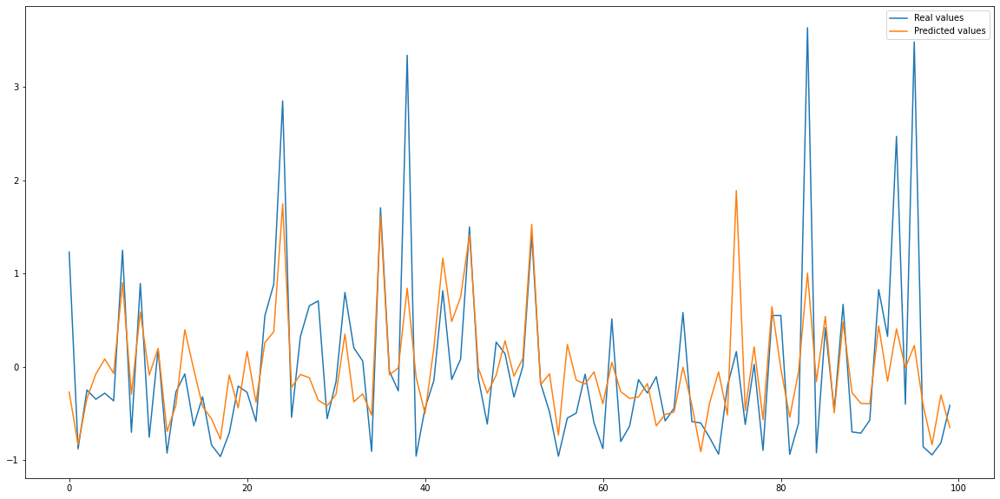

MAE = 0.24 0.43
MSE = 0.33 0.54
RMSE = 0.57 0.74
R2 = 0.67 0.44
AQI accuracy = 0.8140785439680763 0.6272992700729927
AQI accuracy+-1 = 0.9822984086816877 0.9722627737226277

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5', 'PM25-6', 'PM25-7']
-1.1882069 4.462228


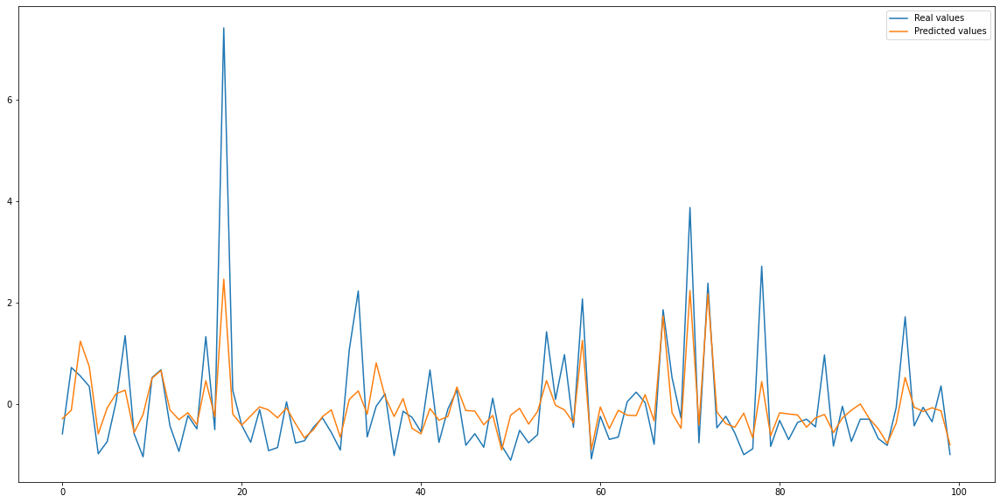

MAE = 0.23 0.43
MSE = 0.26 0.51
RMSE = 0.51 0.72
R2 = 0.74 0.5
AQI accuracy = 0.8667956261250369 0.729959166129379
AQI accuracy+-1 = 0.9896026436688966 0.9874274661508704

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5', 'NO2-6', 'NO2-7']
-1.2327735 2.9906743


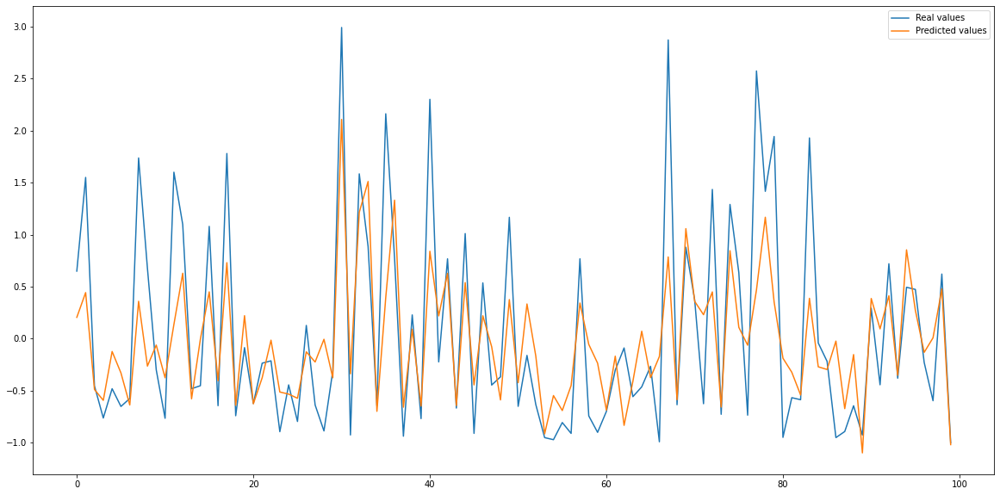

MAE = 0.24 0.48
MSE = 0.18 0.48
RMSE = 0.43 0.7
R2 = 0.82 0.52
AQI accuracy = 0.9217976493244162 0.8398710595721522
AQI accuracy+-1 = 0.9975823416747779 0.9913341985180224

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5', 'SO2-6', 'SO2-7']
-1.0145013 5.2440715


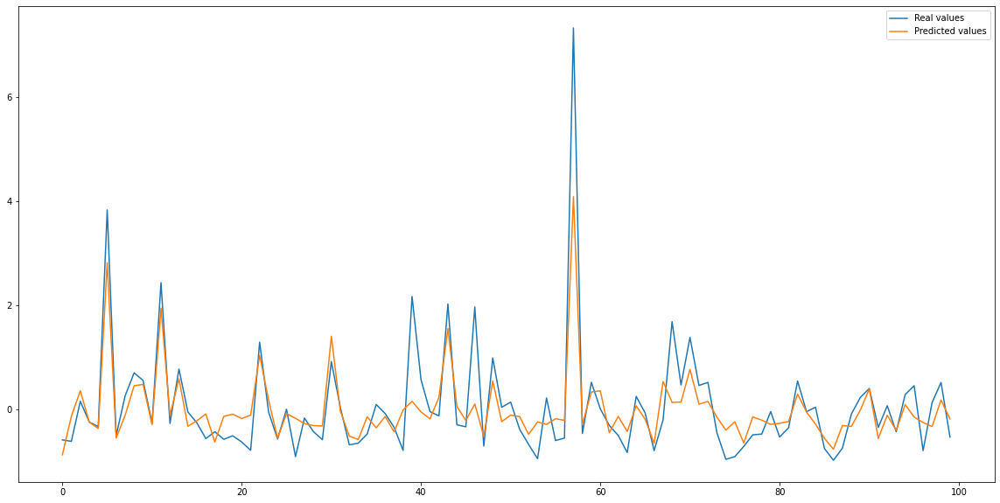

MAE = 0.21 0.4
MSE = 0.26 0.54
RMSE = 0.51 0.74
R2 = 0.74 0.5
AQI accuracy = 0.9980742629309176 0.9965285311347364
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'O3-2', 'O3-3', 'O3-4', 'O3-5', 'O3-6', 'O3-7']
-2.2755787 2.7653472


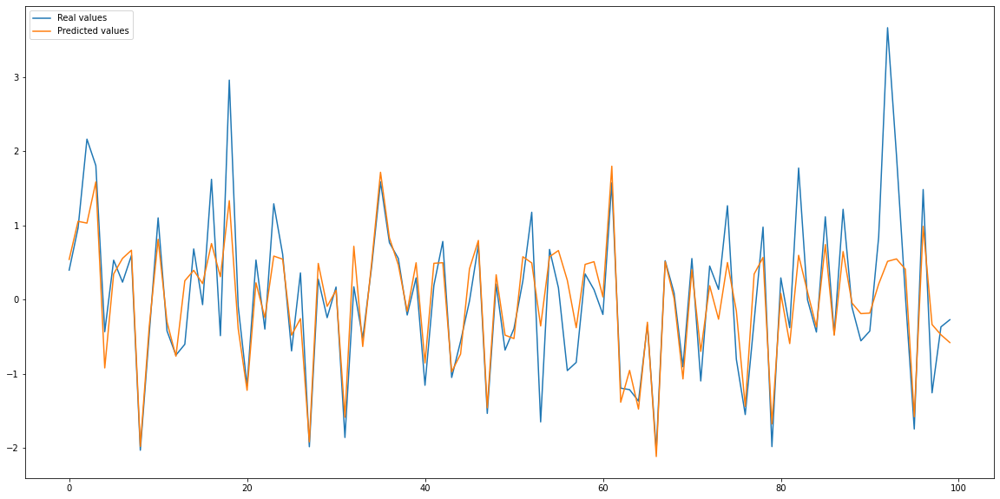

MAE = 0.18 0.37
MSE = 0.09 0.28
RMSE = 0.3 0.53
R2 = 0.91 0.72
AQI accuracy = 0.9305741091677281 0.8458168939699897
AQI accuracy+-1 = 0.9990835378545466 0.9991612041380595

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5', 'PM10-6', 'PM10-7']
-1.1109136 5.0092473


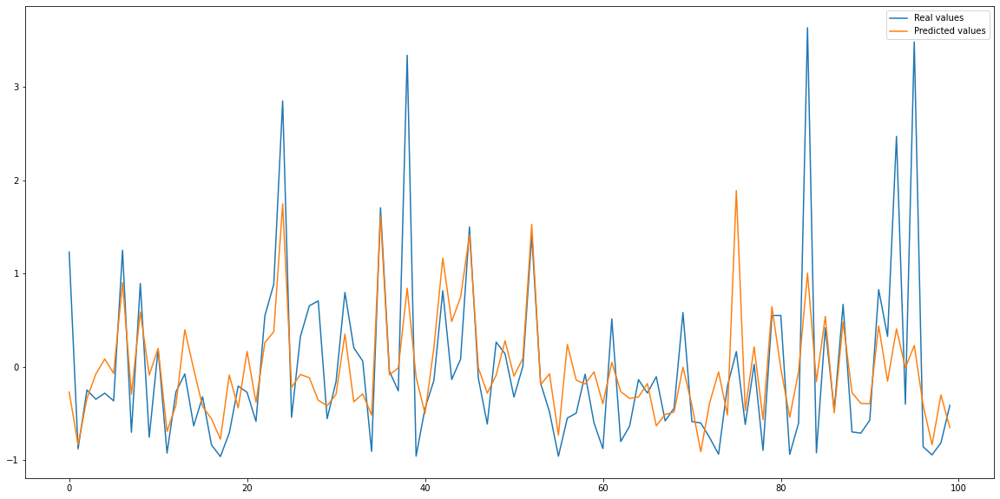

MAE = 0.24 0.43
MSE = 0.33 0.54
RMSE = 0.57 0.74
R2 = 0.67 0.44
AQI accuracy = 0.8140785439680763 0.6272992700729927
AQI accuracy+-1 = 0.9822984086816877 0.9722627737226277

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5', 'PM25-6', 'PM25-7']
-1.1882069 4.462228


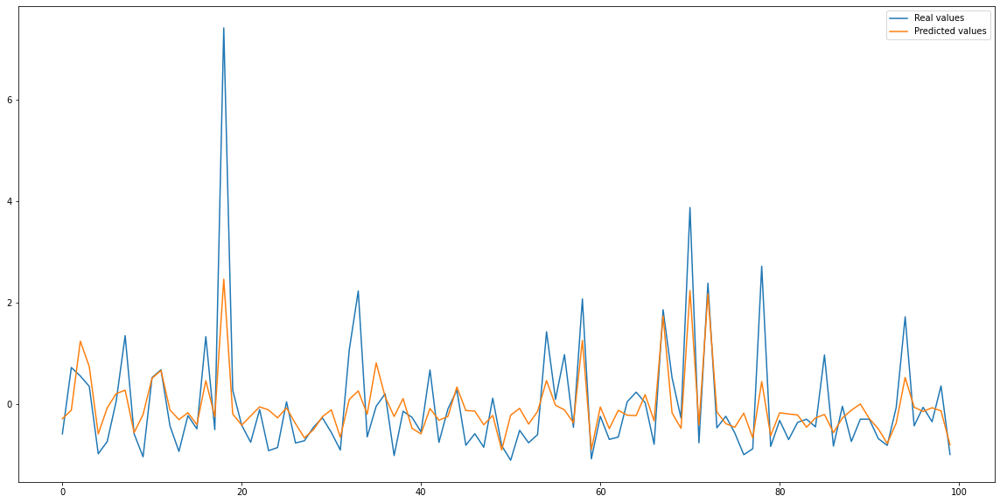

MAE = 0.23 0.43
MSE = 0.26 0.51
RMSE = 0.51 0.72
R2 = 0.74 0.5
AQI accuracy = 0.8667956261250369 0.729959166129379
AQI accuracy+-1 = 0.9896026436688966 0.9874274661508704

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'NO2-2', 'NO2-3', 'NO2-4', 'NO2-5', 'NO2-6', 'NO2-7']
-1.2327735 2.9906743


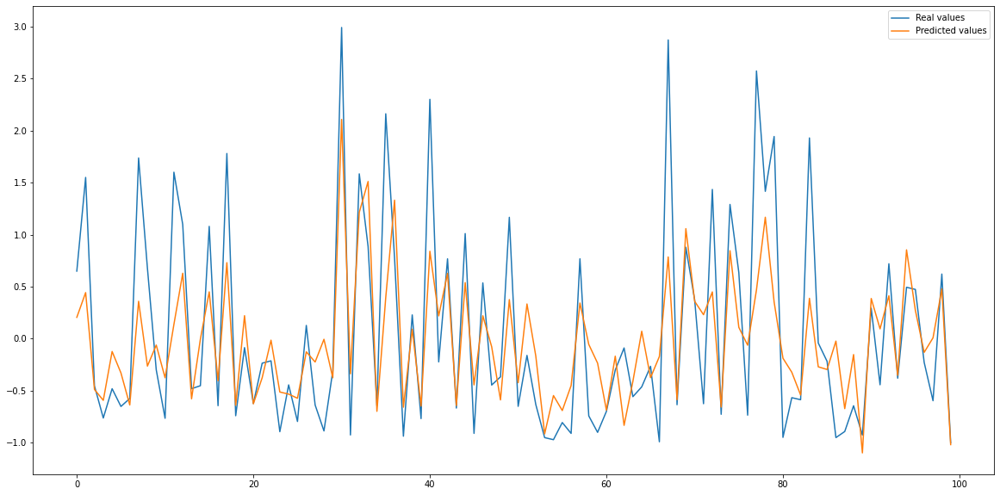

MAE = 0.24 0.48
MSE = 0.18 0.48
RMSE = 0.43 0.7
R2 = 0.82 0.52
AQI accuracy = 0.9217976493244162 0.8398710595721522
AQI accuracy+-1 = 0.9975823416747779 0.9913341985180224

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'SO2-2', 'SO2-3', 'SO2-4', 'SO2-5', 'SO2-6', 'SO2-7']
-1.0145013 5.2440715


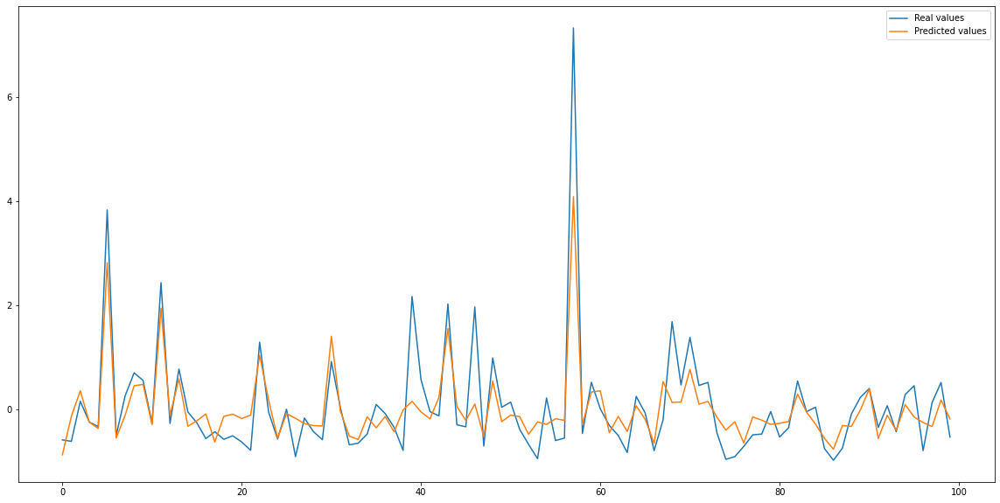

MAE = 0.21 0.4
MSE = 0.26 0.54
RMSE = 0.51 0.74
R2 = 0.74 0.5
AQI accuracy = 0.9980742629309176 0.9965285311347364
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'O3-2', 'O3-3', 'O3-4', 'O3-5', 'O3-6', 'O3-7']
-2.2755787 2.7653472


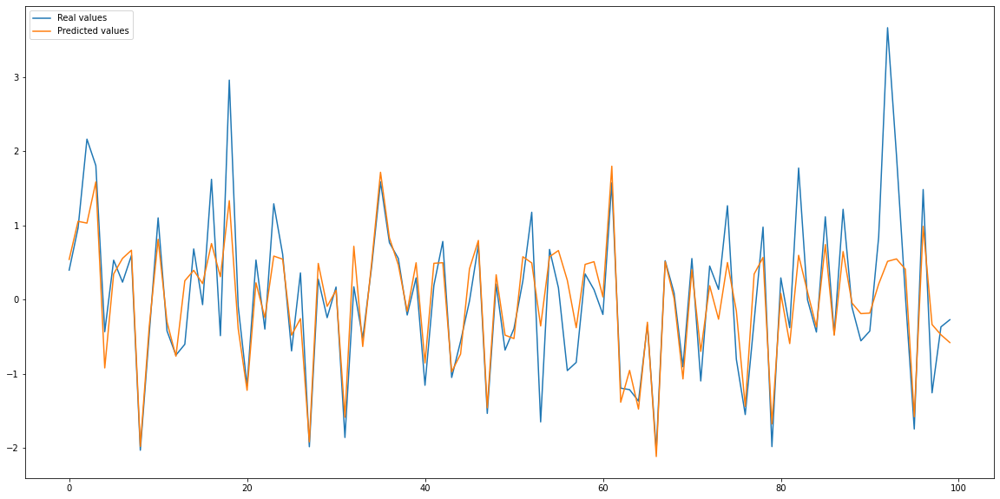

MAE = 0.18 0.37
MSE = 0.09 0.28
RMSE = 0.3 0.53
R2 = 0.91 0.72
AQI accuracy = 0.9305741091677281 0.8458168939699897
AQI accuracy+-1 = 0.9990835378545466 0.9991612041380595

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM10-2', 'PM10-3', 'PM10-4', 'PM10-5', 'PM10-6', 'PM10-7']
-1.1109136 5.0092473


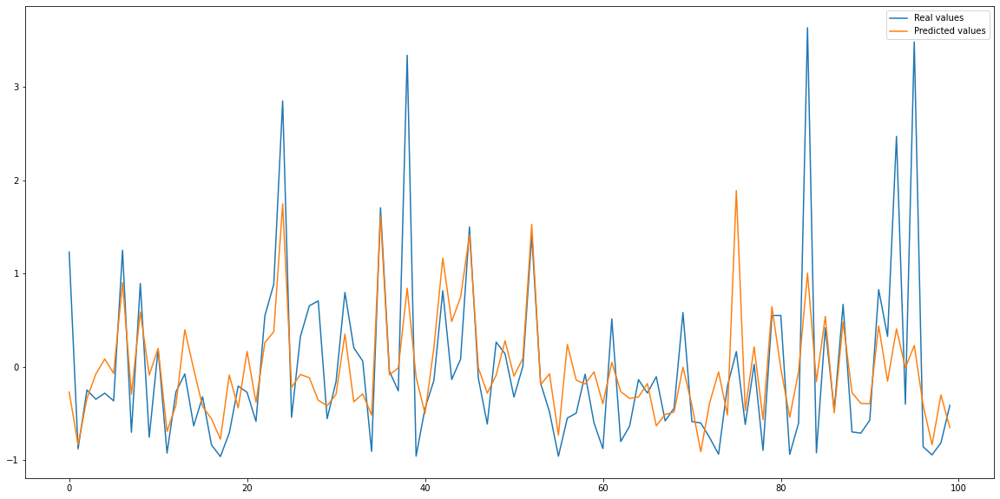

MAE = 0.24 0.43
MSE = 0.33 0.54
RMSE = 0.57 0.74
R2 = 0.67 0.44
AQI accuracy = 0.8140785439680763 0.6272992700729927
AQI accuracy+-1 = 0.9822984086816877 0.9722627737226277

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'month', 'weekday', 'hour', 'PM25-2', 'PM25-3', 'PM25-4', 'PM25-5', 'PM25-6', 'PM25-7']
-1.1882069 4.462228


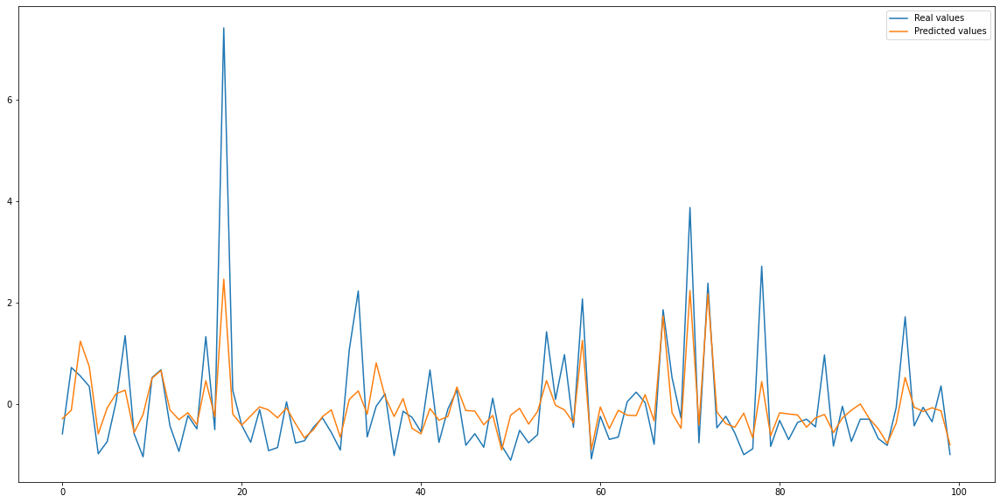

MAE = 0.23 0.43
MSE = 0.26 0.51
RMSE = 0.51 0.72
R2 = 0.74 0.5
AQI accuracy = 0.8667956261250369 0.729959166129379
AQI accuracy+-1 = 0.9896026436688966 0.9874274661508704

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

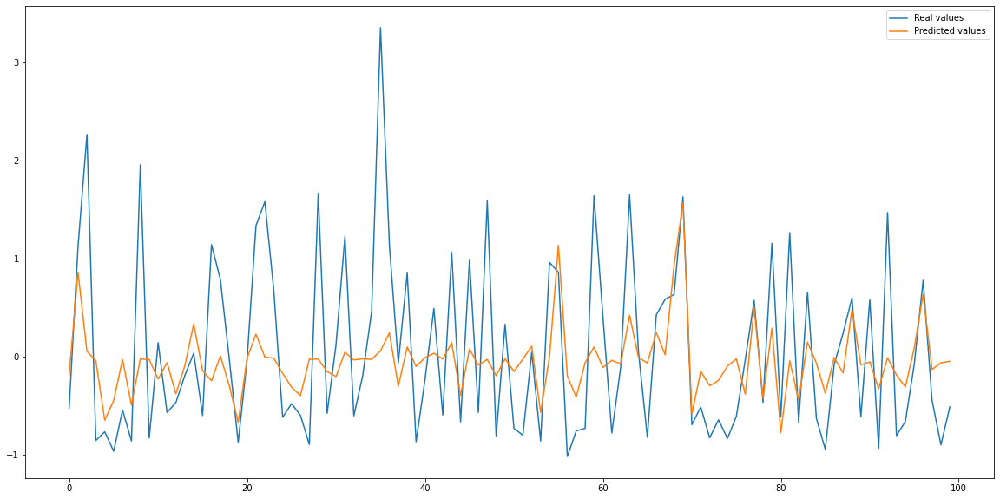

MAE = 0.29 0.64
MSE = 0.28 0.76
RMSE = 0.53 0.87
R2 = 0.72 0.25
AQI accuracy = 0.910621619846292 0.7522771063233491
AQI accuracy+-1 = 0.9944384839394802 0.9734191627255211

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13

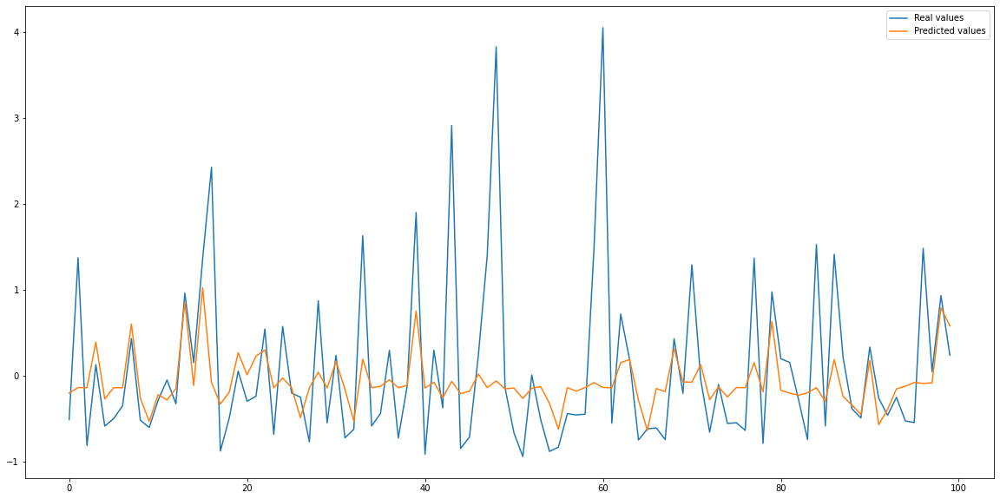

MAE = 0.25 0.49
MSE = 0.39 0.76
RMSE = 0.63 0.87
R2 = 0.61 0.25
AQI accuracy = 0.9977071542591787 0.9976781982818668
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'month', 'weekday', 'hour',

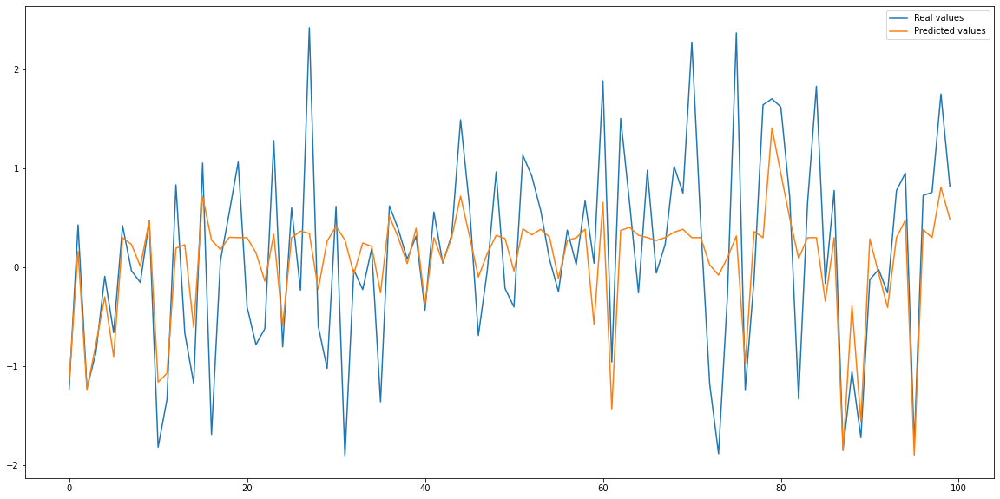

MAE = 0.23 0.52
MSE = 0.16 0.51
RMSE = 0.4 0.71
R2 = 0.84 0.49
AQI accuracy = 0.9049066400715535 0.7302200411587779
AQI accuracy+-1 = 0.997205930077015 0.991198353648884

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

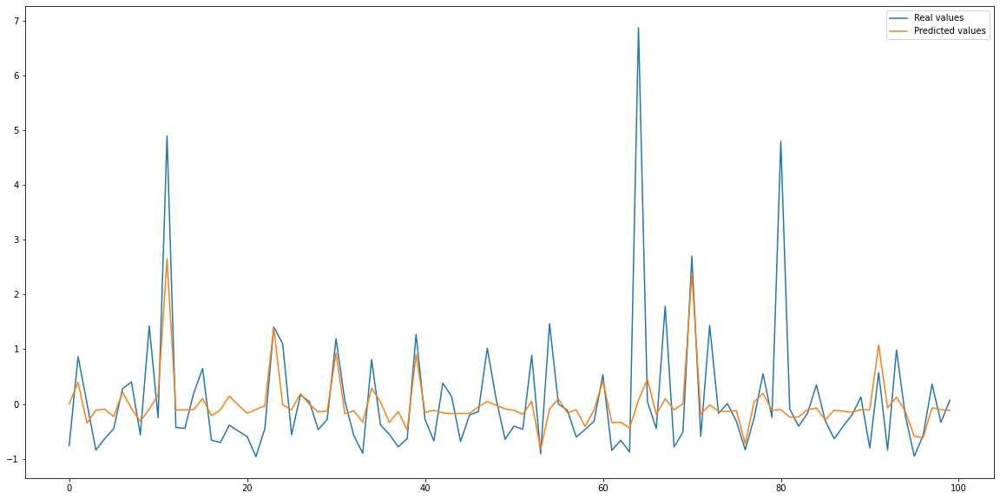

MAE = 0.26 0.51
MSE = 0.41 0.78
RMSE = 0.64 0.88
R2 = 0.58 0.24
AQI accuracy = 0.7901522288887787 0.5143296310987703
AQI accuracy+-1 = 0.9763227054098279 0.9672253074176914

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-

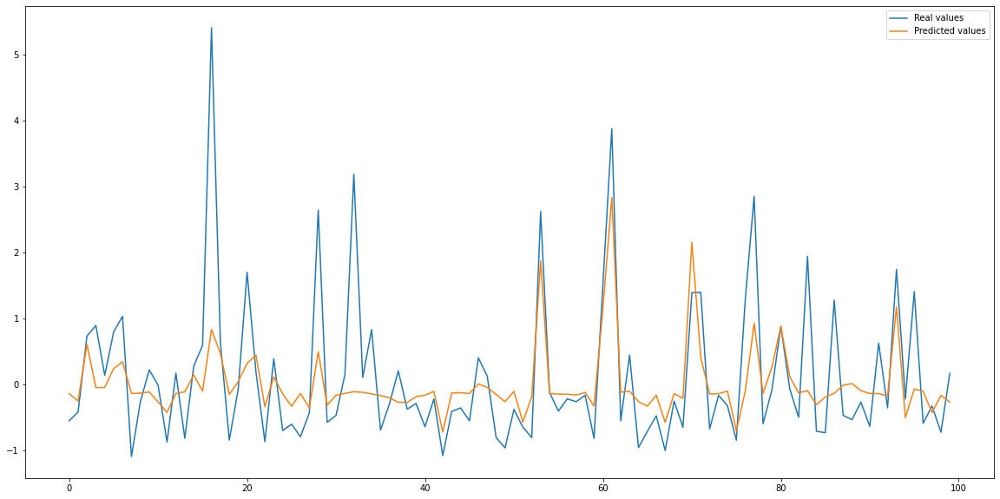

MAE = 0.25 0.51
MSE = 0.36 0.73
RMSE = 0.6 0.85
R2 = 0.65 0.3
AQI accuracy = 0.8650933728080163 0.7253473012981098
AQI accuracy+-1 = 0.9842006376679572 0.9765429287178319

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

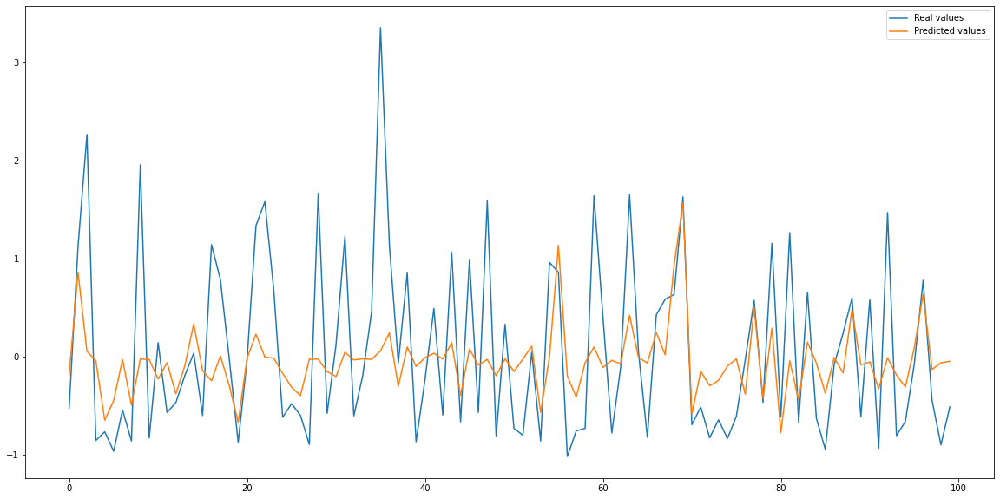

MAE = 0.29 0.64
MSE = 0.28 0.76
RMSE = 0.53 0.87
R2 = 0.72 0.25
AQI accuracy = 0.910621619846292 0.7522771063233491
AQI accuracy+-1 = 0.9944384839394802 0.9734191627255211

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13

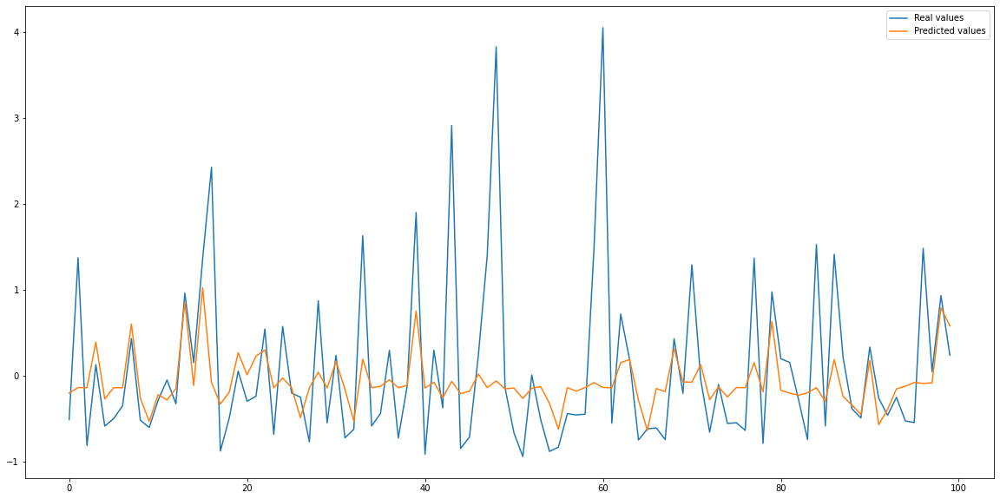

MAE = 0.25 0.49
MSE = 0.39 0.76
RMSE = 0.63 0.87
R2 = 0.61 0.25
AQI accuracy = 0.9977071542591787 0.9976781982818668
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'month', 'weekday', 'hour',

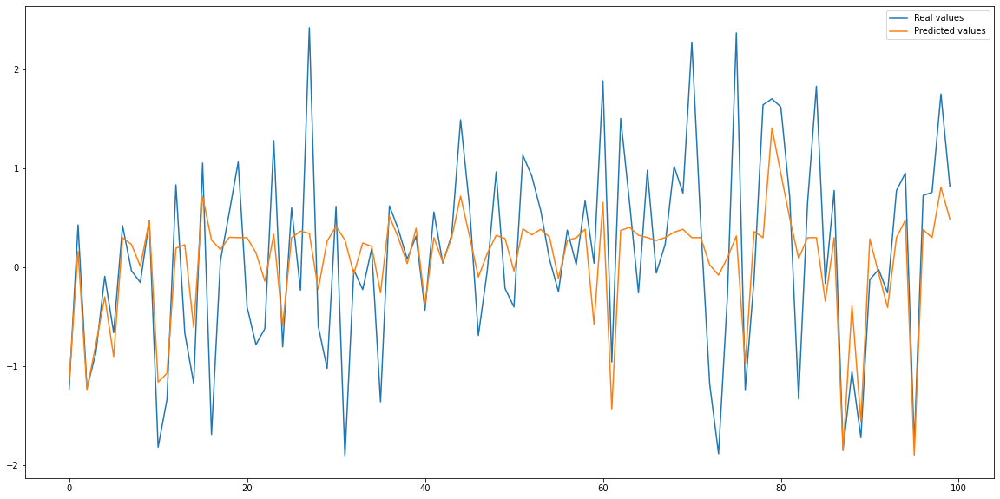

MAE = 0.23 0.52
MSE = 0.16 0.51
RMSE = 0.4 0.71
R2 = 0.84 0.49
AQI accuracy = 0.9049066400715535 0.7302200411587779
AQI accuracy+-1 = 0.997205930077015 0.991198353648884

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

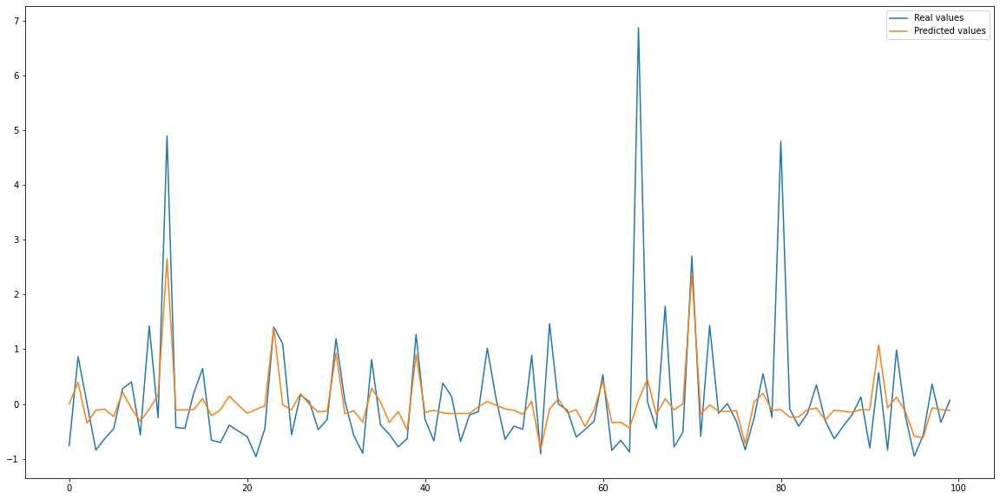

MAE = 0.26 0.51
MSE = 0.41 0.78
RMSE = 0.64 0.88
R2 = 0.58 0.24
AQI accuracy = 0.7901522288887787 0.5143296310987703
AQI accuracy+-1 = 0.9763227054098279 0.9672253074176914

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-

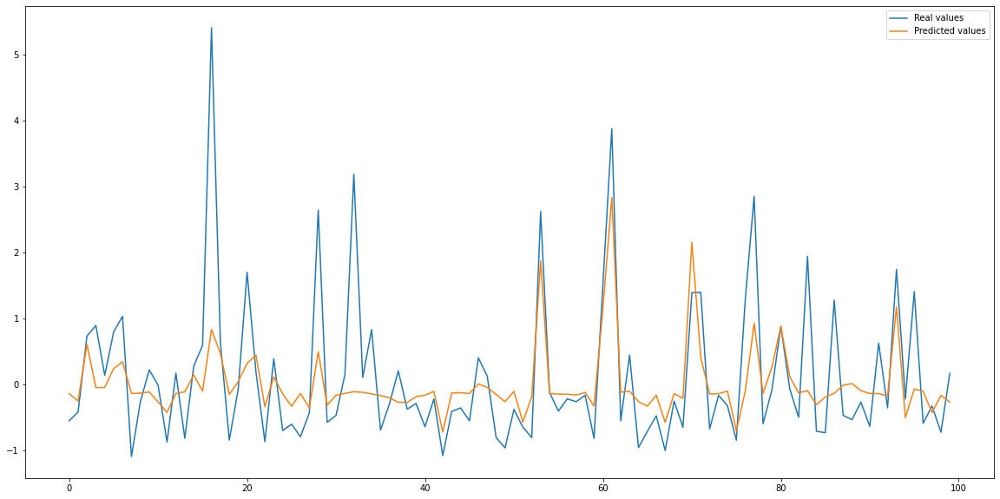

MAE = 0.25 0.51
MSE = 0.36 0.73
RMSE = 0.6 0.85
R2 = 0.65 0.3
AQI accuracy = 0.8650933728080163 0.7253473012981098
AQI accuracy+-1 = 0.9842006376679572 0.9765429287178319

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

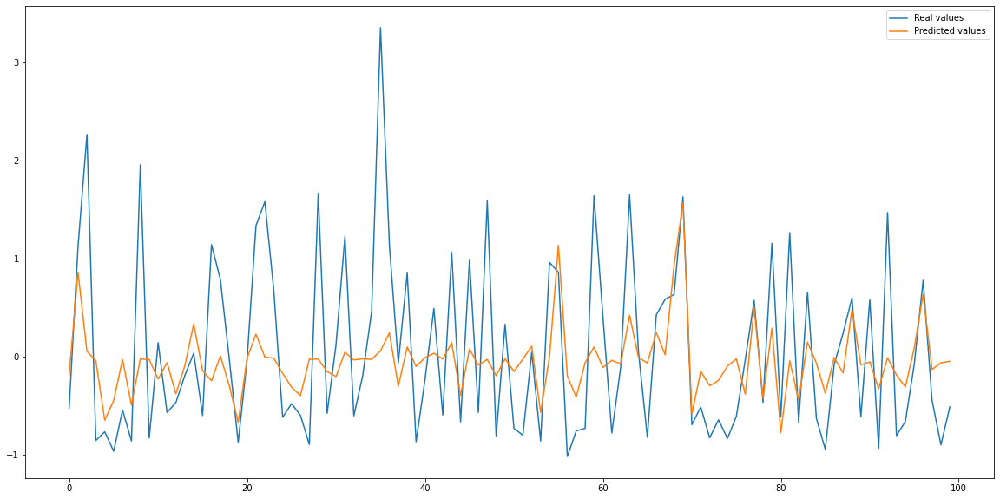

MAE = 0.29 0.64
MSE = 0.28 0.76
RMSE = 0.53 0.87
R2 = 0.72 0.25
AQI accuracy = 0.910621619846292 0.7522771063233491
AQI accuracy+-1 = 0.9944384839394802 0.9734191627255211

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13

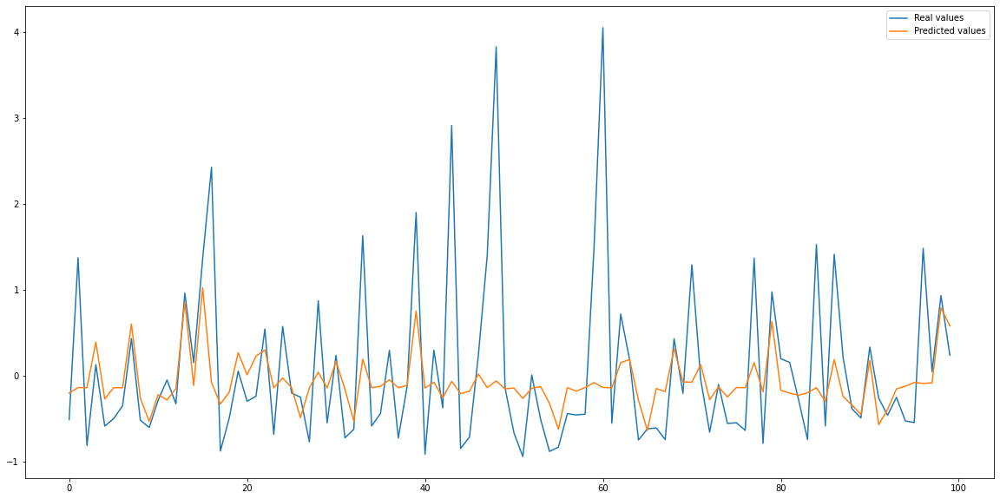

MAE = 0.25 0.49
MSE = 0.39 0.76
RMSE = 0.63 0.87
R2 = 0.61 0.25
AQI accuracy = 0.9977071542591787 0.9976781982818668
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'month', 'weekday', 'hour',

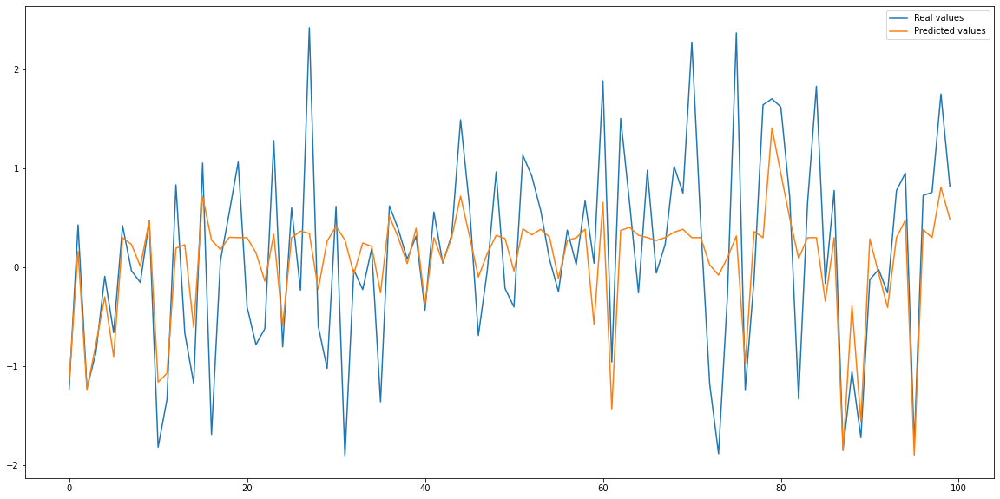

MAE = 0.23 0.52
MSE = 0.16 0.51
RMSE = 0.4 0.71
R2 = 0.84 0.49
AQI accuracy = 0.9049066400715535 0.7302200411587779
AQI accuracy+-1 = 0.997205930077015 0.991198353648884

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

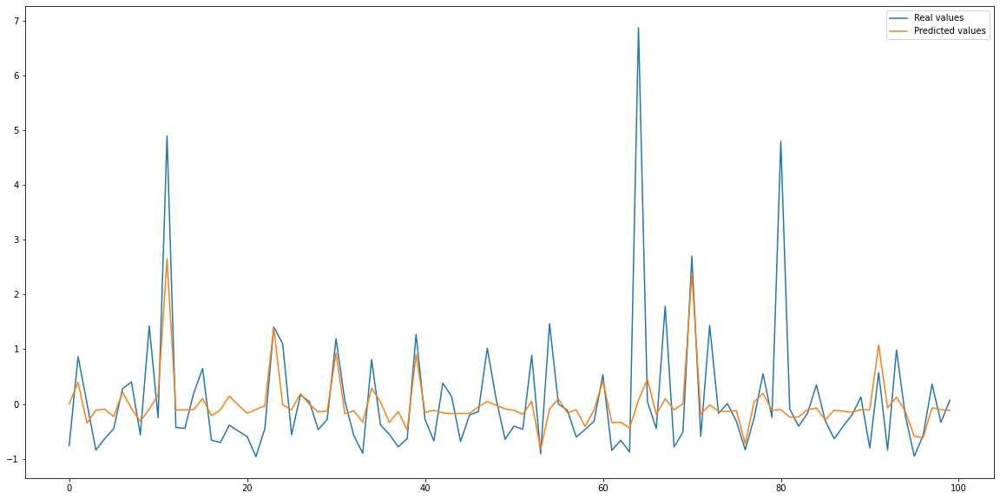

MAE = 0.26 0.51
MSE = 0.41 0.78
RMSE = 0.64 0.88
R2 = 0.58 0.24
AQI accuracy = 0.7901522288887787 0.5143296310987703
AQI accuracy+-1 = 0.9763227054098279 0.9672253074176914

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-

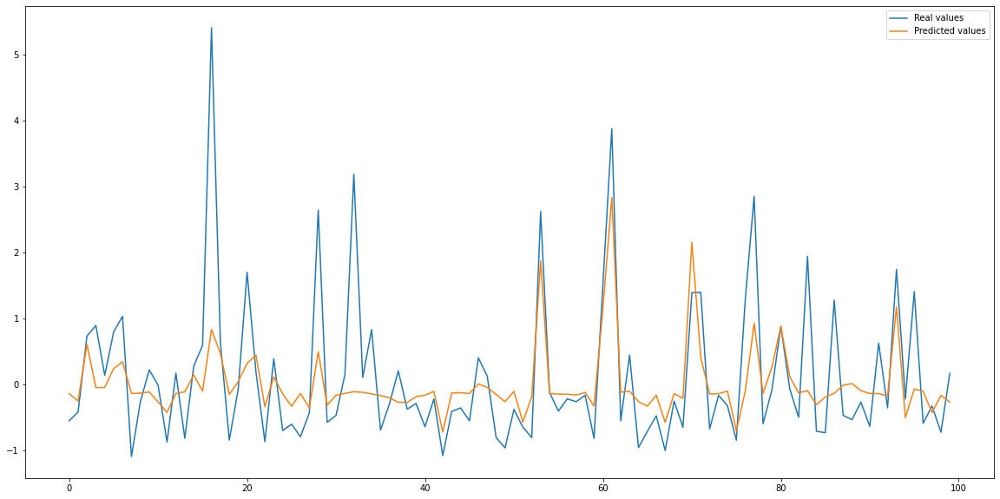

MAE = 0.25 0.51
MSE = 0.36 0.73
RMSE = 0.6 0.85
R2 = 0.65 0.3
AQI accuracy = 0.8650933728080163 0.7253473012981098
AQI accuracy+-1 = 0.9842006376679572 0.9765429287178319

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

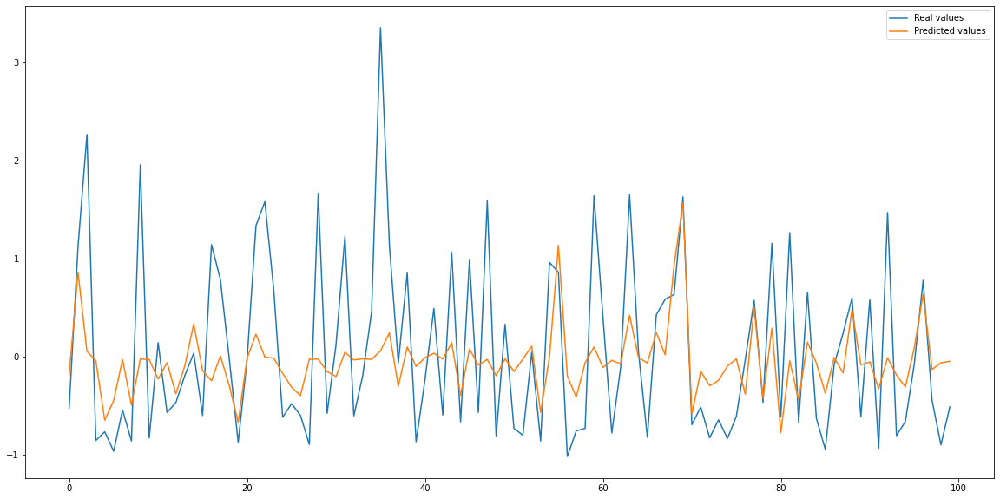

MAE = 0.29 0.64
MSE = 0.28 0.76
RMSE = 0.53 0.87
R2 = 0.72 0.25
AQI accuracy = 0.910621619846292 0.7522771063233491
AQI accuracy+-1 = 0.9944384839394802 0.9734191627255211

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13

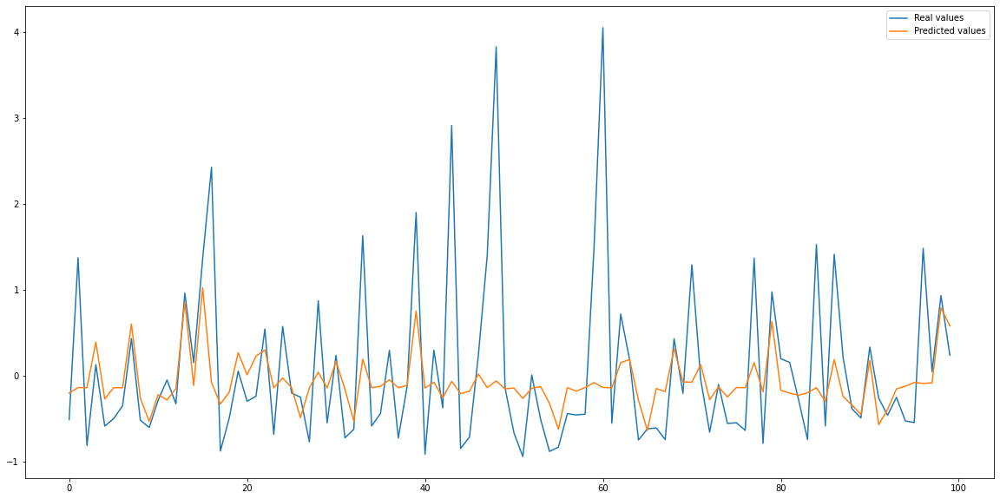

MAE = 0.25 0.49
MSE = 0.39 0.76
RMSE = 0.63 0.87
R2 = 0.61 0.25
AQI accuracy = 0.9977071542591787 0.9976781982818668
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'month', 'weekday', 'hour',

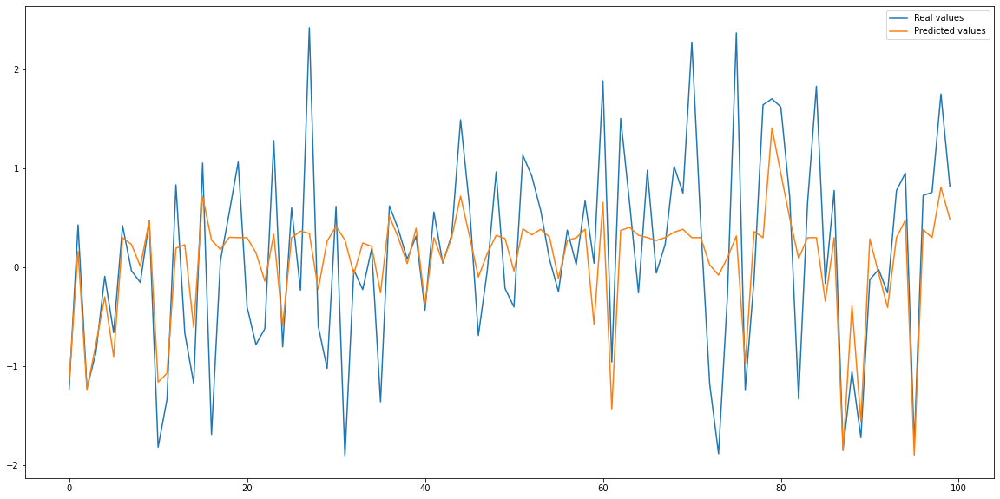

MAE = 0.23 0.52
MSE = 0.16 0.51
RMSE = 0.4 0.71
R2 = 0.84 0.49
AQI accuracy = 0.9049066400715535 0.7302200411587779
AQI accuracy+-1 = 0.997205930077015 0.991198353648884

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

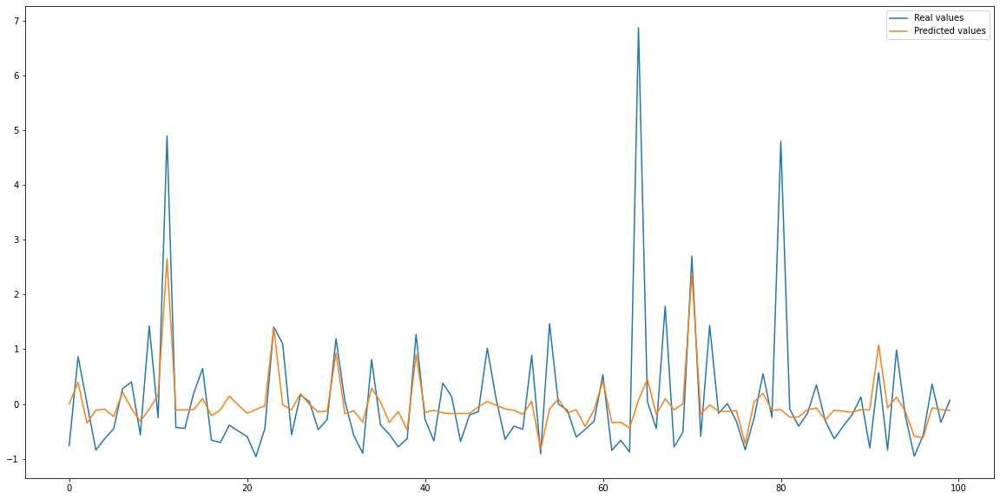

MAE = 0.26 0.51
MSE = 0.41 0.78
RMSE = 0.64 0.88
R2 = 0.58 0.24
AQI accuracy = 0.7901522288887787 0.5143296310987703
AQI accuracy+-1 = 0.9763227054098279 0.9672253074176914

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-

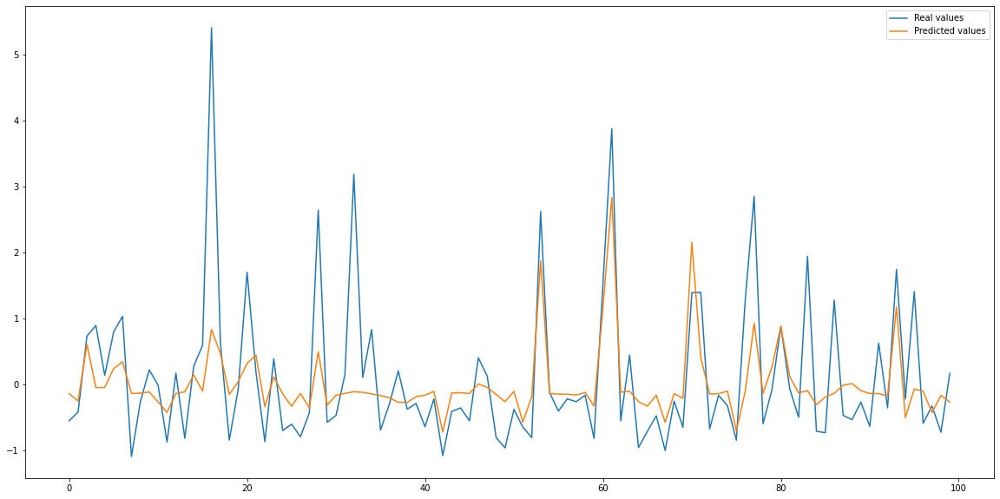

MAE = 0.25 0.51
MSE = 0.36 0.73
RMSE = 0.6 0.85
R2 = 0.65 0.3
AQI accuracy = 0.8650933728080163 0.7253473012981098
AQI accuracy+-1 = 0.9842006376679572 0.9765429287178319

SVR()
Param: NO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

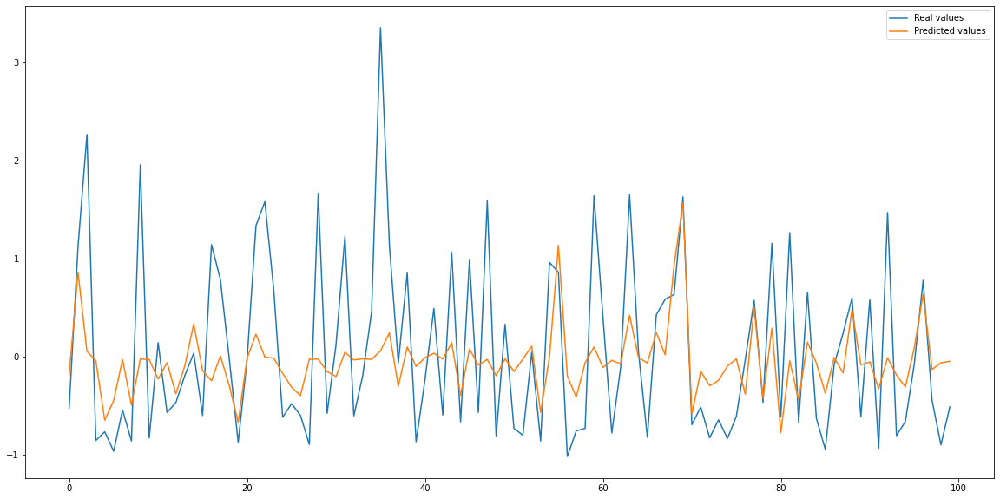

MAE = 0.29 0.64
MSE = 0.28 0.76
RMSE = 0.53 0.87
R2 = 0.72 0.25
AQI accuracy = 0.910621619846292 0.7522771063233491
AQI accuracy+-1 = 0.9944384839394802 0.9734191627255211

SVR()
Param: SO2, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13

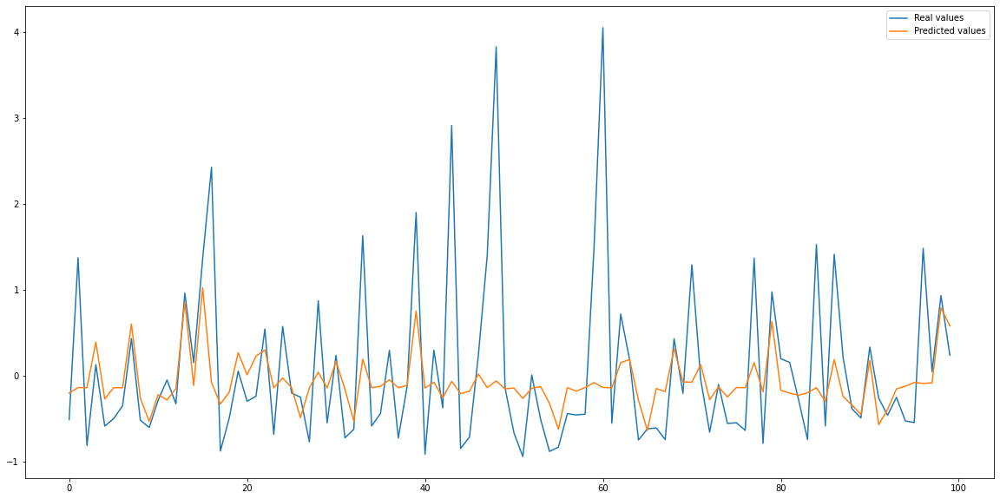

MAE = 0.25 0.49
MSE = 0.39 0.76
RMSE = 0.63 0.87
R2 = 0.61 0.25
AQI accuracy = 0.9977071542591787 0.9976781982818668
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'month', 'weekday', 'hour',

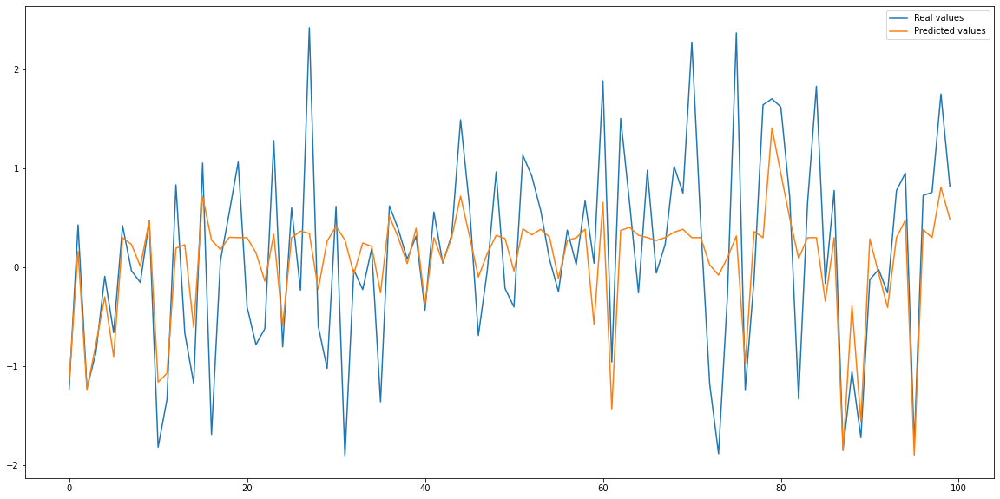

MAE = 0.23 0.52
MSE = 0.16 0.51
RMSE = 0.4 0.71
R2 = 0.84 0.49
AQI accuracy = 0.9049066400715535 0.7302200411587779
AQI accuracy+-1 = 0.997205930077015 0.991198353648884

SVR()
Param: PM10, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13'

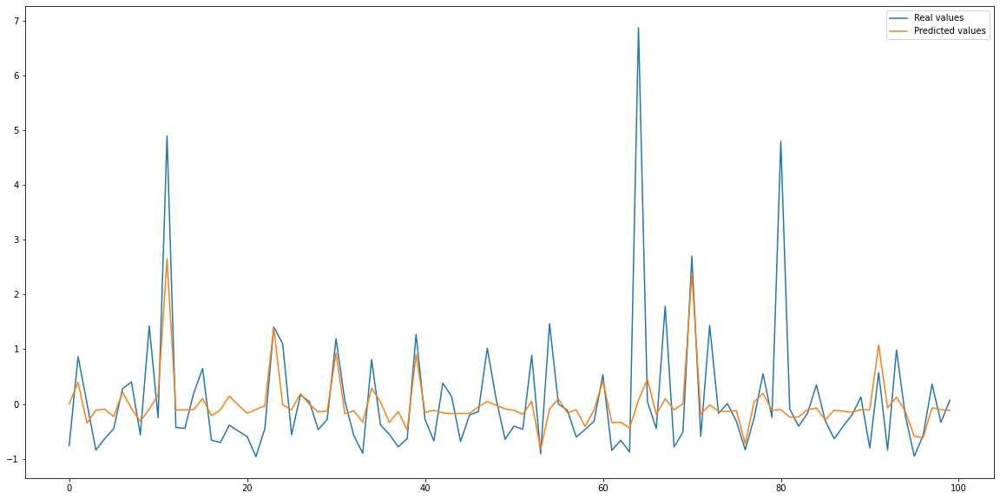

MAE = 0.26 0.51
MSE = 0.41 0.78
RMSE = 0.64 0.88
R2 = 0.58 0.24
AQI accuracy = 0.7901522288887787 0.5143296310987703
AQI accuracy+-1 = 0.9763227054098279 0.9672253074176914

SVR()
Param: PM25, history: [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]:
['temperature-2', 'temperature-3', 'temperature-4', 'temperature-5', 'temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'wind-2', 'wind-3', 'wind-4', 'wind-5', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'humidity-2', 'humidity-3', 'humidity-4', 'humidity-5', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'precipitation_1-2', 'precipitation_1-3', 'precipitation_1-4', 'precipitation_1-5', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-

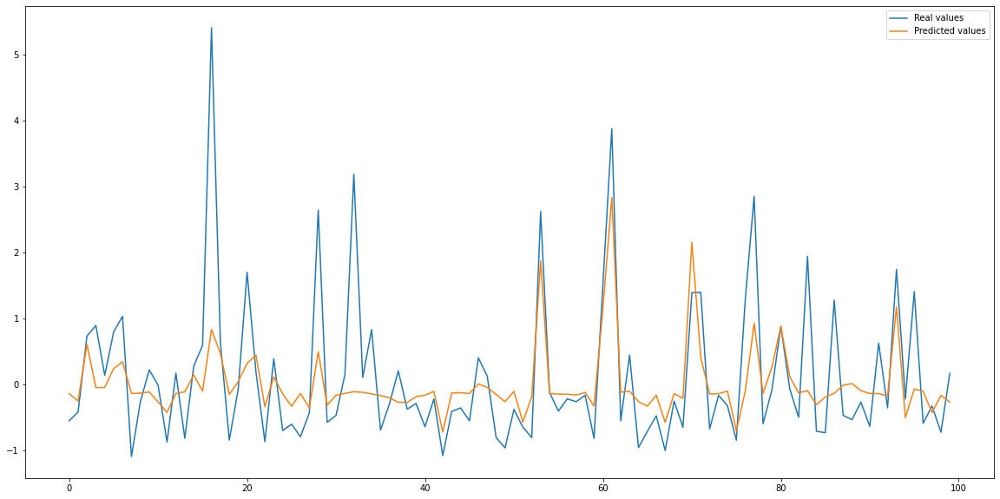

MAE = 0.25 0.51
MSE = 0.36 0.73
RMSE = 0.6 0.85
R2 = 0.65 0.3
AQI accuracy = 0.8650933728080163 0.7253473012981098
AQI accuracy+-1 = 0.9842006376679572 0.9765429287178319



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  svr = SVR2()
  testModelForVariousParameters(svr, df, [[2,3, 4, 5, 6, 7]], [2, 3, 4, 5, 6, 7], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  svr = SVR2()
  testModelForVariousParameters(svr, df, [[2, 3, 4, 5, 6, 7, 8,9, 10, 11, 12, 13]], [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

SVR()
Param: NO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'NO2-6']
-1.1935972 3.5137403


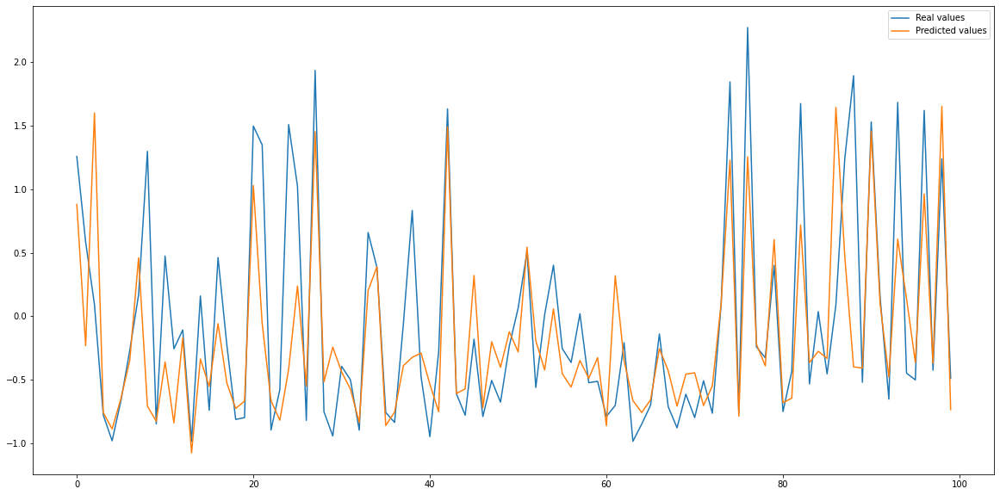

MAE = 0.41 0.44
MSE = 0.39 0.43
RMSE = 0.63 0.66
R2 = 0.61 0.56
AQI accuracy = 0.8353399862631813 0.8255019999191952
AQI accuracy+-1 = 0.9961920730475536 0.9955961375297968

SVR()
Param: SO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'SO2-6']
-1.136708 4.842031


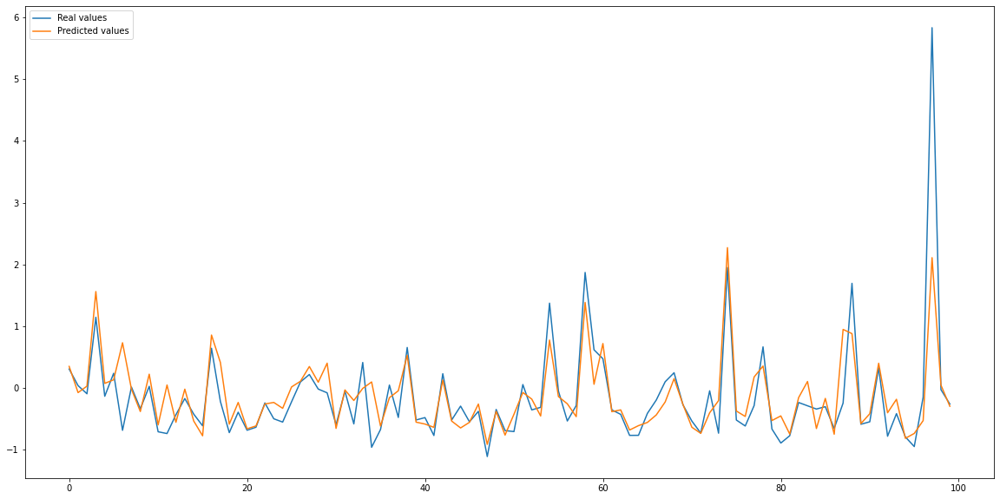

MAE = 0.33 0.37
MSE = 0.44 0.48
RMSE = 0.66 0.69
R2 = 0.56 0.51
AQI accuracy = 0.9976845300882451 0.998456472525211
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'O3-6']
-2.164964 3.992279


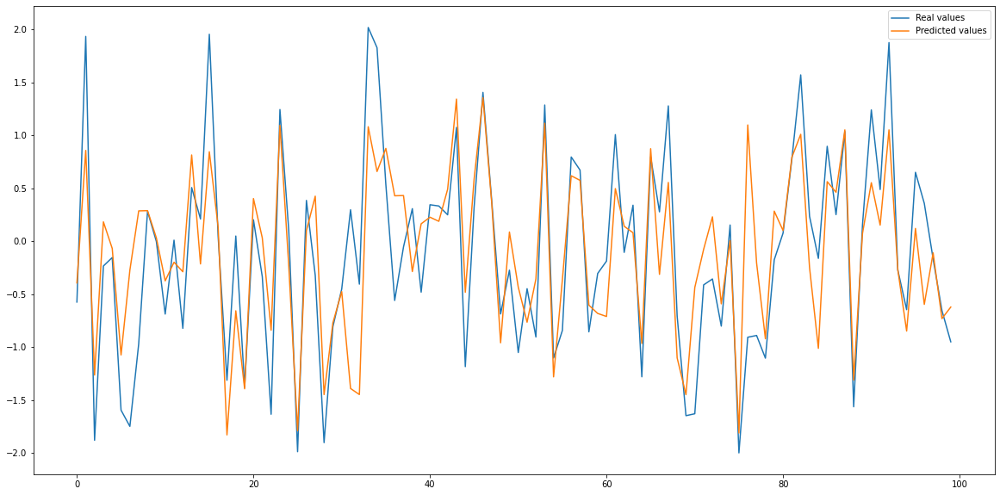

MAE = 0.44 0.47
MSE = 0.37 0.42
RMSE = 0.61 0.64
R2 = 0.63 0.58
AQI accuracy = 0.8256439698396295 0.8042193576043357
AQI accuracy+-1 = 0.9989818961227849 0.9984996478765424

SVR()
Param: PM10, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM10-6']
-1.1217722 4.0788355


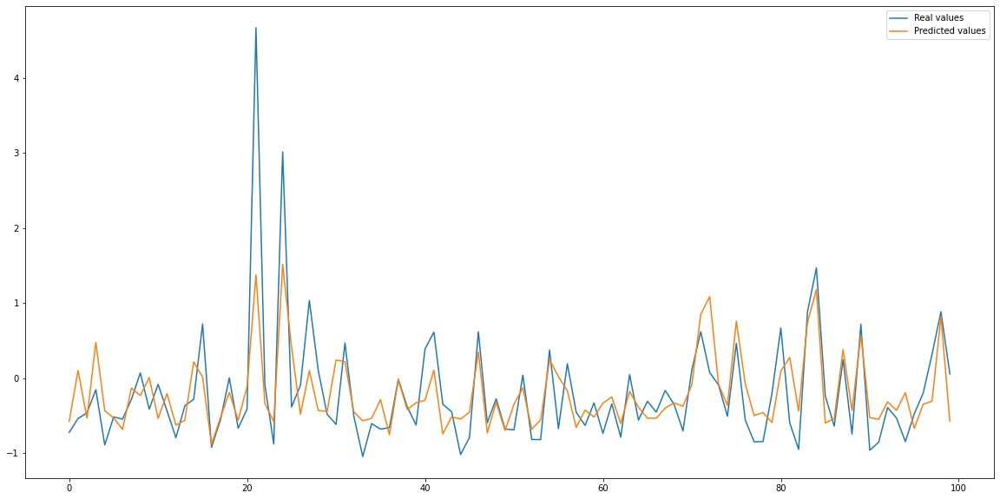

MAE = 0.42 0.45
MSE = 0.61 0.61
RMSE = 0.78 0.78
R2 = 0.4 0.35
AQI accuracy = 0.6758877159309021 0.6535988483685221
AQI accuracy+-1 = 0.9643114203454894 0.962619961612284

SVR()
Param: PM25, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM25-6']
-1.1141064 5.321513


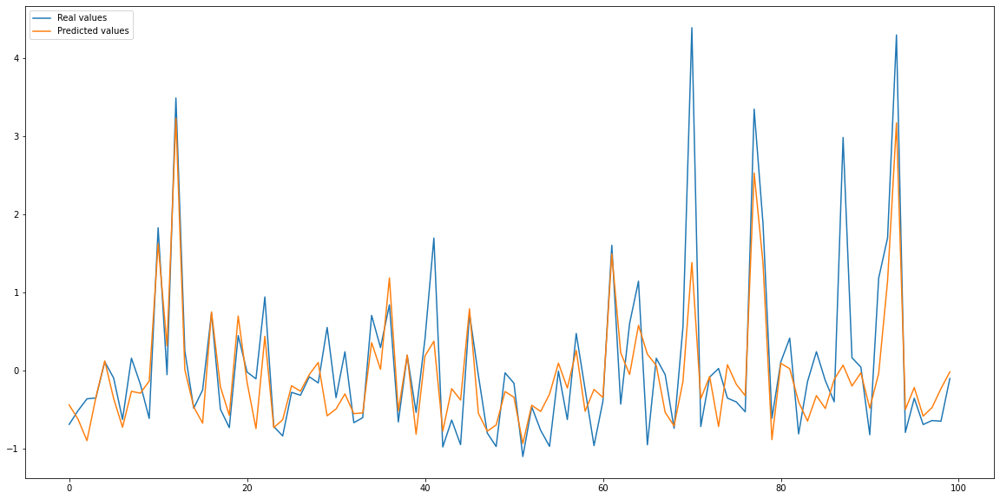

MAE = 0.38 0.44
MSE = 0.41 0.47
RMSE = 0.64 0.69
R2 = 0.59 0.54
AQI accuracy = 0.7538895296680764 0.7193971703916342
AQI accuracy+-1 = 0.9876201460976547 0.9853393479598114

SVR()
Param: NO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'NO2-6']
-1.1935972 3.5137403


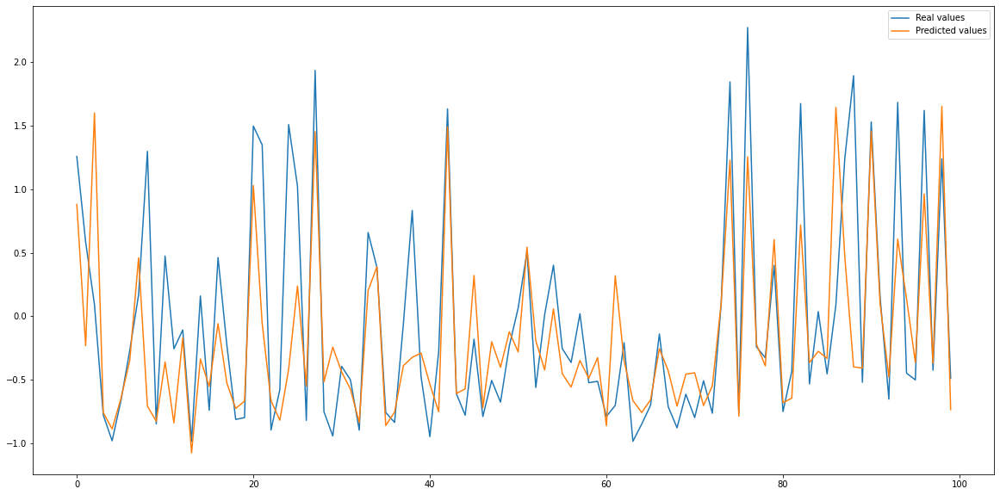

MAE = 0.41 0.44
MSE = 0.39 0.43
RMSE = 0.63 0.66
R2 = 0.61 0.56
AQI accuracy = 0.8353399862631813 0.8255019999191952
AQI accuracy+-1 = 0.9961920730475536 0.9955961375297968

SVR()
Param: SO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'SO2-6']
-1.136708 4.842031


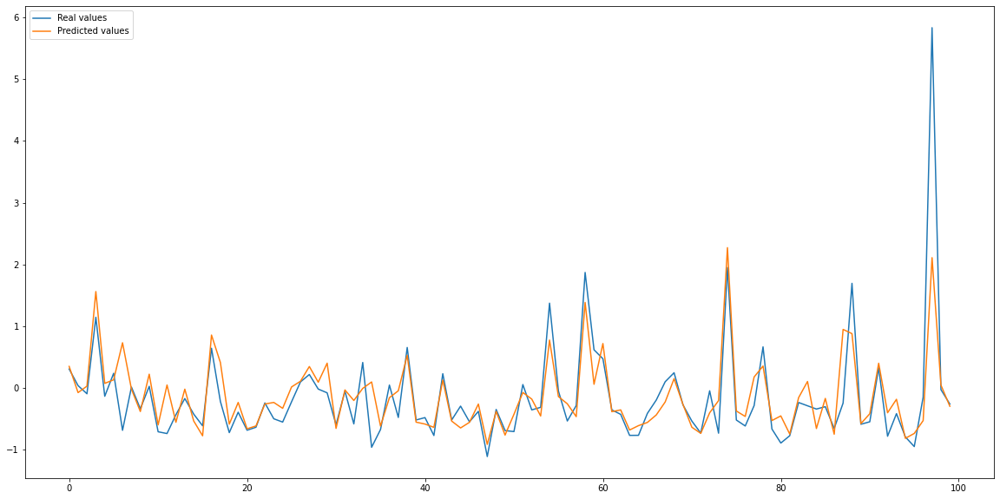

MAE = 0.33 0.37
MSE = 0.44 0.48
RMSE = 0.66 0.69
R2 = 0.56 0.51
AQI accuracy = 0.9976845300882451 0.998456472525211
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'O3-6']
-2.164964 3.992279


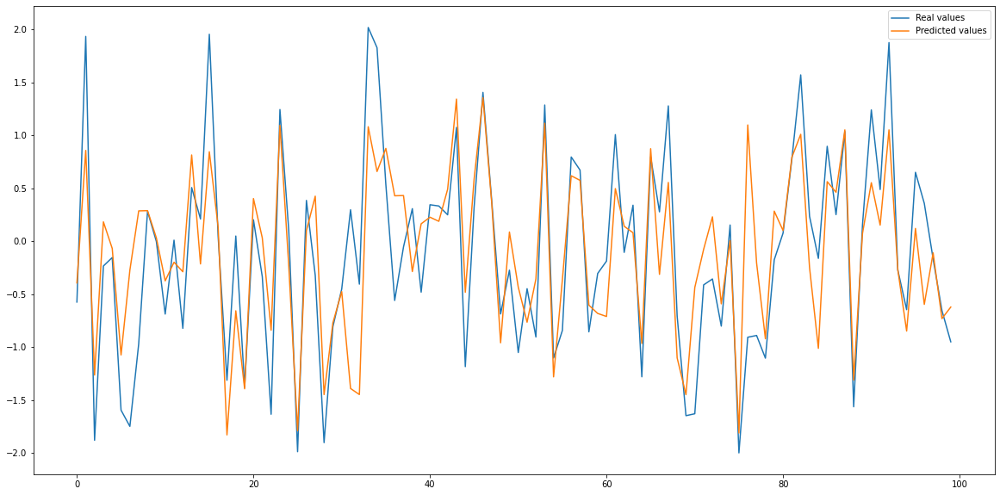

MAE = 0.44 0.47
MSE = 0.37 0.42
RMSE = 0.61 0.64
R2 = 0.63 0.58
AQI accuracy = 0.8256439698396295 0.8042193576043357
AQI accuracy+-1 = 0.9989818961227849 0.9984996478765424

SVR()
Param: PM10, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM10-6']
-1.1217722 4.0788355


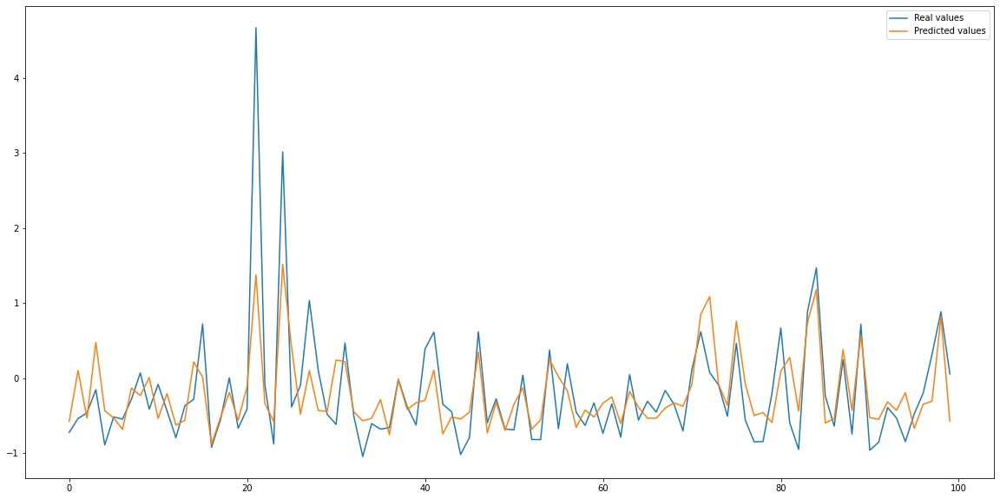

MAE = 0.42 0.45
MSE = 0.61 0.61
RMSE = 0.78 0.78
R2 = 0.4 0.35
AQI accuracy = 0.6758877159309021 0.6535988483685221
AQI accuracy+-1 = 0.9643114203454894 0.962619961612284

SVR()
Param: PM25, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM25-6']
-1.1141064 5.321513


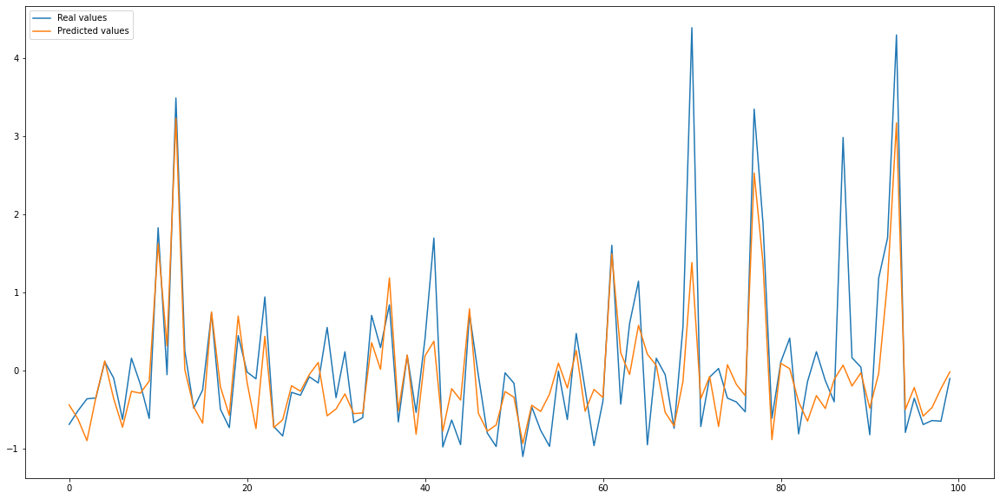

MAE = 0.38 0.44
MSE = 0.41 0.47
RMSE = 0.64 0.69
R2 = 0.59 0.54
AQI accuracy = 0.7538895296680764 0.7193971703916342
AQI accuracy+-1 = 0.9876201460976547 0.9853393479598114

SVR()
Param: NO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'NO2-6']
-1.1935972 3.5137403


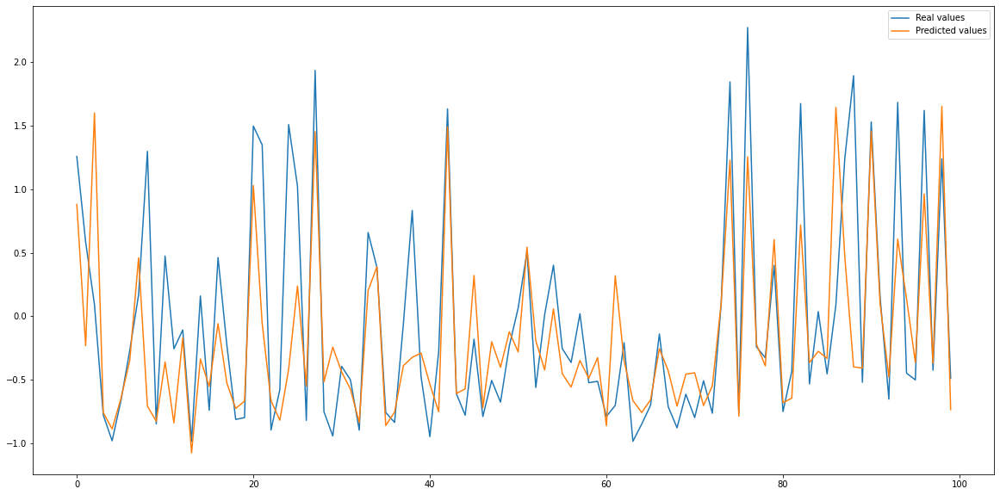

MAE = 0.41 0.44
MSE = 0.39 0.43
RMSE = 0.63 0.66
R2 = 0.61 0.56
AQI accuracy = 0.8353399862631813 0.8255019999191952
AQI accuracy+-1 = 0.9961920730475536 0.9955961375297968

SVR()
Param: SO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'SO2-6']
-1.136708 4.842031


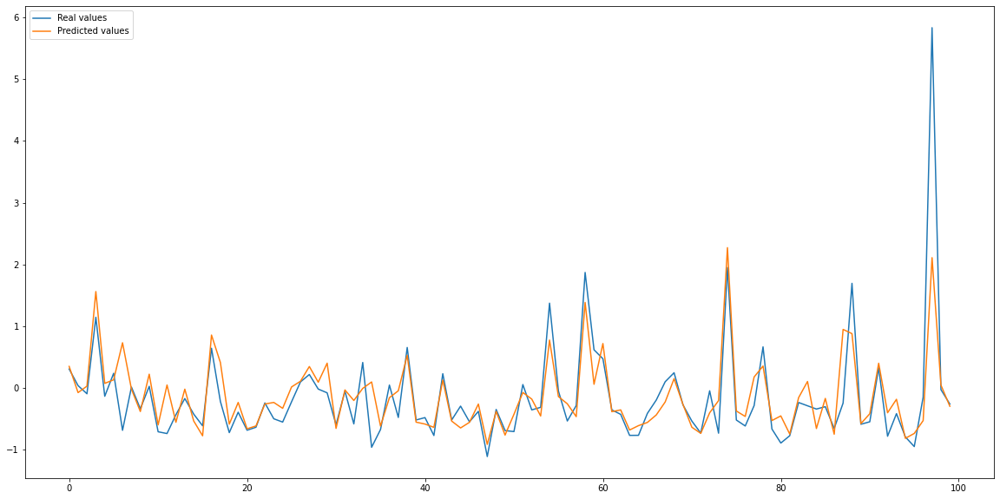

MAE = 0.33 0.37
MSE = 0.44 0.48
RMSE = 0.66 0.69
R2 = 0.56 0.51
AQI accuracy = 0.9976845300882451 0.998456472525211
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'O3-6']
-2.164964 3.992279


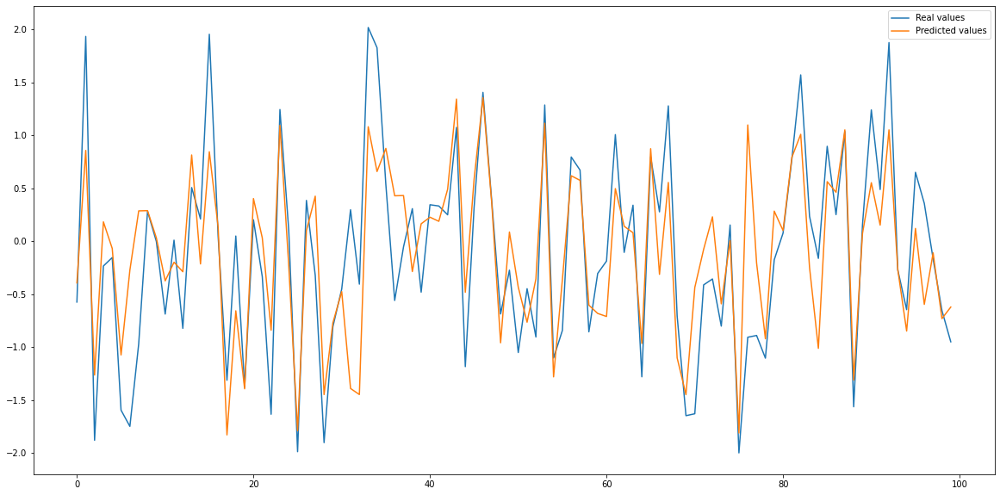

MAE = 0.44 0.47
MSE = 0.37 0.42
RMSE = 0.61 0.64
R2 = 0.63 0.58
AQI accuracy = 0.8256439698396295 0.8042193576043357
AQI accuracy+-1 = 0.9989818961227849 0.9984996478765424

SVR()
Param: PM10, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM10-6']
-1.1217722 4.0788355


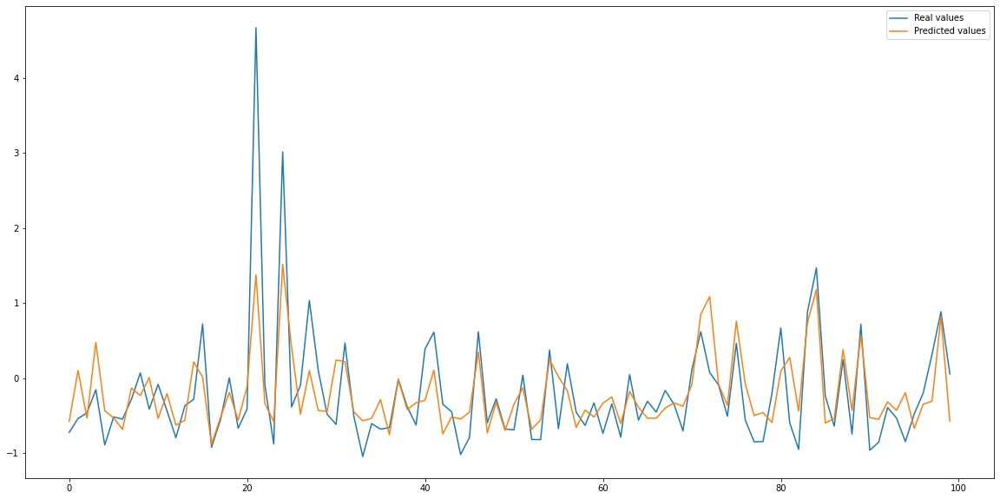

MAE = 0.42 0.45
MSE = 0.61 0.61
RMSE = 0.78 0.78
R2 = 0.4 0.35
AQI accuracy = 0.6758877159309021 0.6535988483685221
AQI accuracy+-1 = 0.9643114203454894 0.962619961612284

SVR()
Param: PM25, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM25-6']
-1.1141064 5.321513


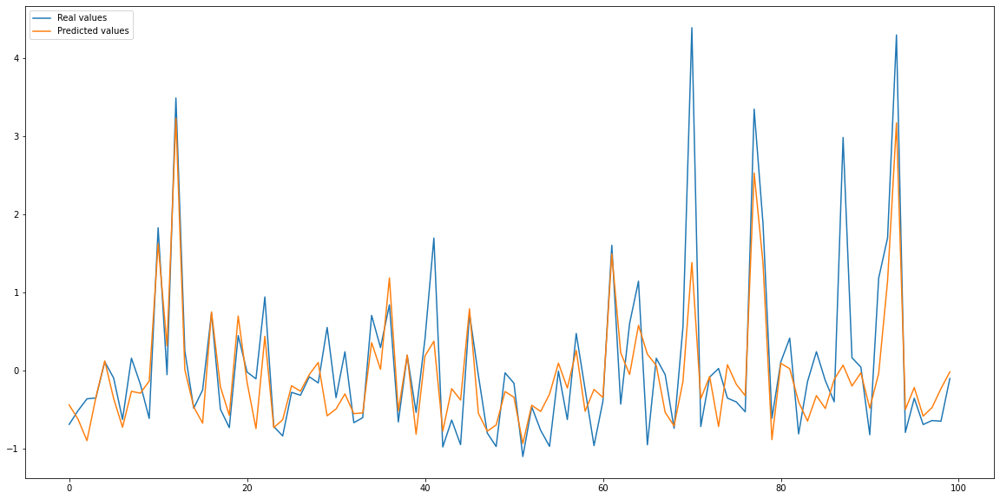

MAE = 0.38 0.44
MSE = 0.41 0.47
RMSE = 0.64 0.69
R2 = 0.59 0.54
AQI accuracy = 0.7538895296680764 0.7193971703916342
AQI accuracy+-1 = 0.9876201460976547 0.9853393479598114

SVR()
Param: NO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'NO2-6']
-1.1935972 3.5137403


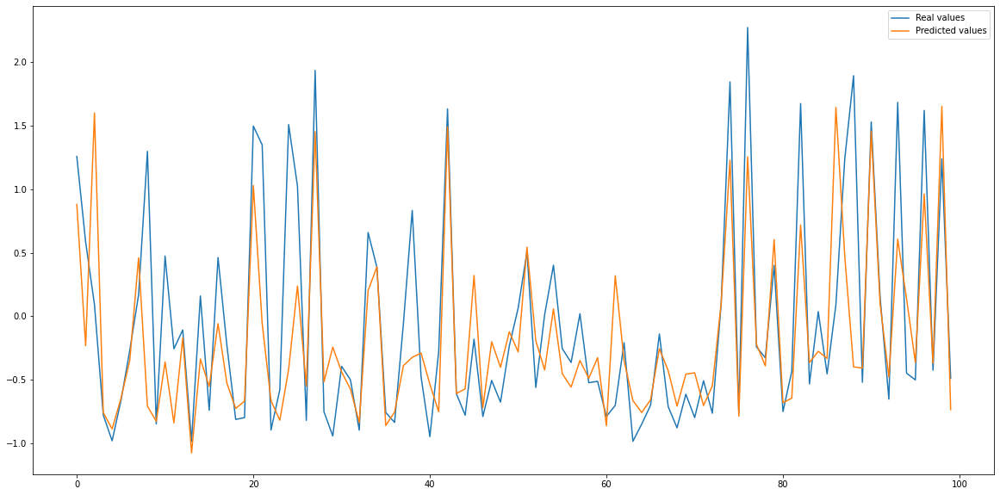

MAE = 0.41 0.44
MSE = 0.39 0.43
RMSE = 0.63 0.66
R2 = 0.61 0.56
AQI accuracy = 0.8353399862631813 0.8255019999191952
AQI accuracy+-1 = 0.9961920730475536 0.9955961375297968

SVR()
Param: SO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'SO2-6']
-1.136708 4.842031


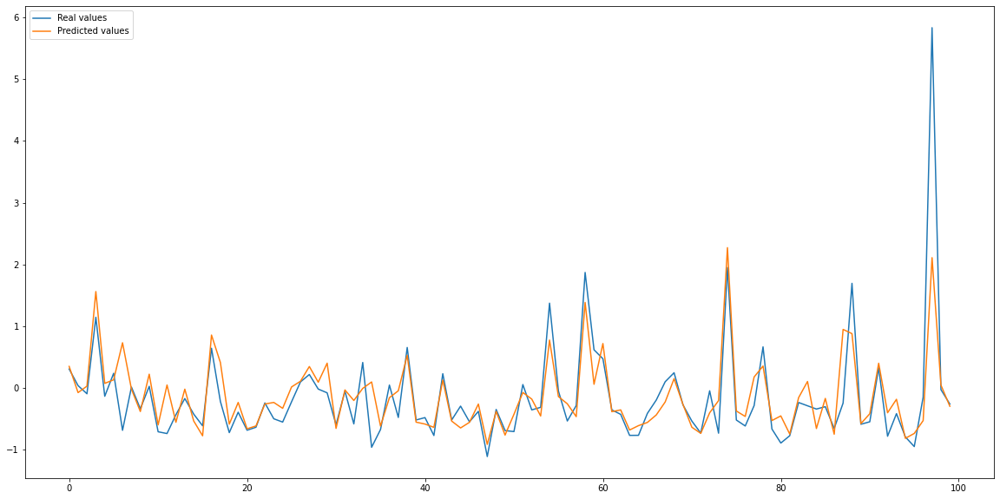

MAE = 0.33 0.37
MSE = 0.44 0.48
RMSE = 0.66 0.69
R2 = 0.56 0.51
AQI accuracy = 0.9976845300882451 0.998456472525211
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'O3-6']
-2.164964 3.992279


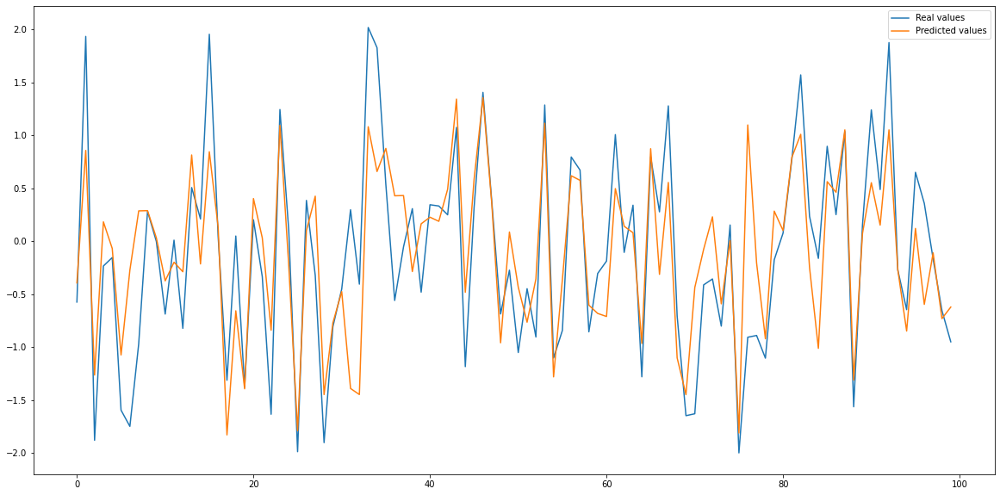

MAE = 0.44 0.47
MSE = 0.37 0.42
RMSE = 0.61 0.64
R2 = 0.63 0.58
AQI accuracy = 0.8256439698396295 0.8042193576043357
AQI accuracy+-1 = 0.9989818961227849 0.9984996478765424

SVR()
Param: PM10, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM10-6']
-1.1217722 4.0788355


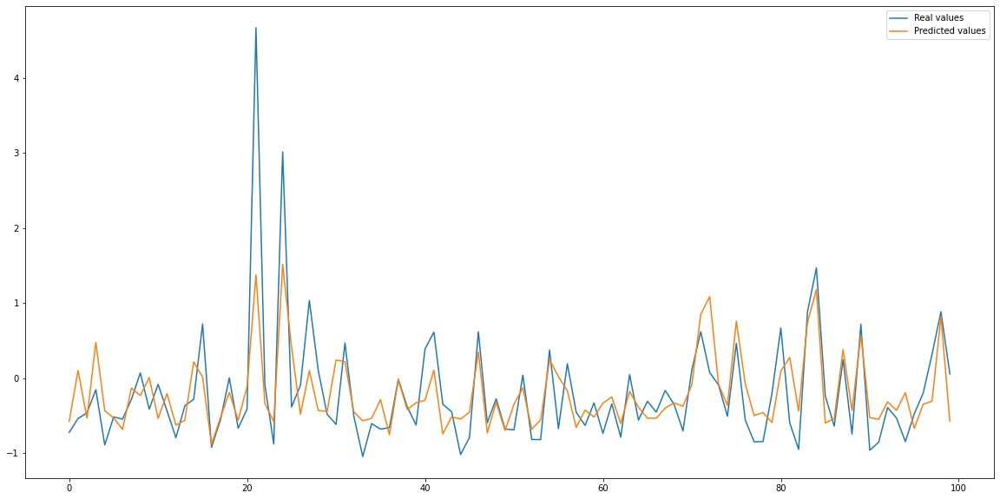

MAE = 0.42 0.45
MSE = 0.61 0.61
RMSE = 0.78 0.78
R2 = 0.4 0.35
AQI accuracy = 0.6758877159309021 0.6535988483685221
AQI accuracy+-1 = 0.9643114203454894 0.962619961612284

SVR()
Param: PM25, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM25-6']
-1.1141064 5.321513


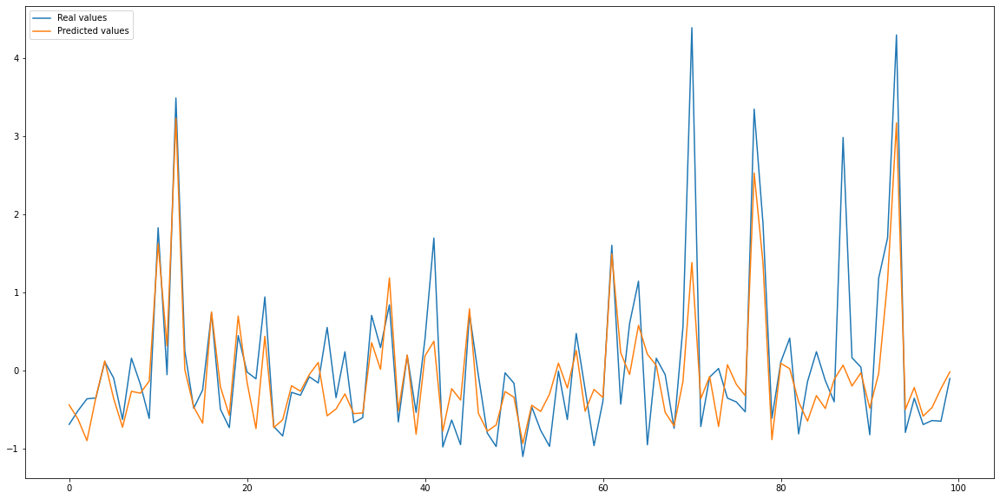

MAE = 0.38 0.44
MSE = 0.41 0.47
RMSE = 0.64 0.69
R2 = 0.59 0.54
AQI accuracy = 0.7538895296680764 0.7193971703916342
AQI accuracy+-1 = 0.9876201460976547 0.9853393479598114

SVR()
Param: NO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'NO2-6']
-1.1935972 3.5137403


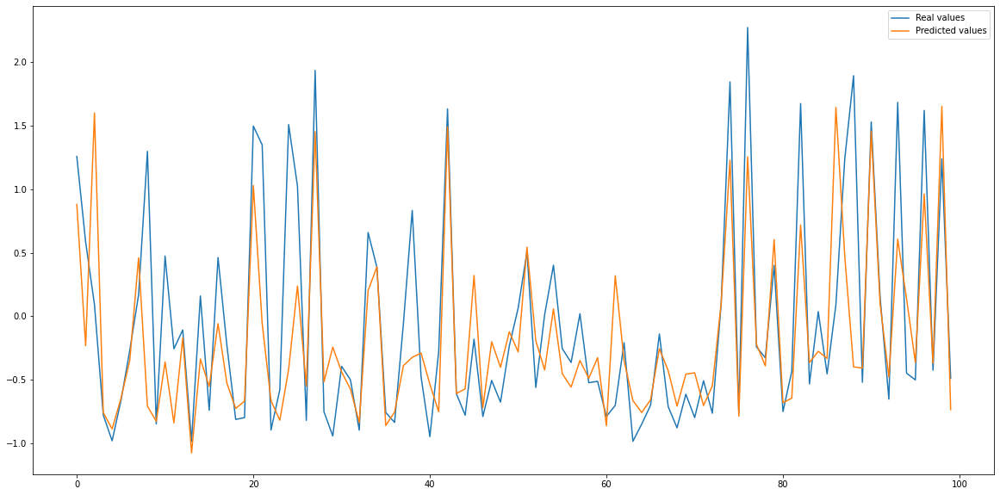

MAE = 0.41 0.44
MSE = 0.39 0.43
RMSE = 0.63 0.66
R2 = 0.61 0.56
AQI accuracy = 0.8353399862631813 0.8255019999191952
AQI accuracy+-1 = 0.9961920730475536 0.9955961375297968

SVR()
Param: SO2, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'SO2-6']
-1.136708 4.842031


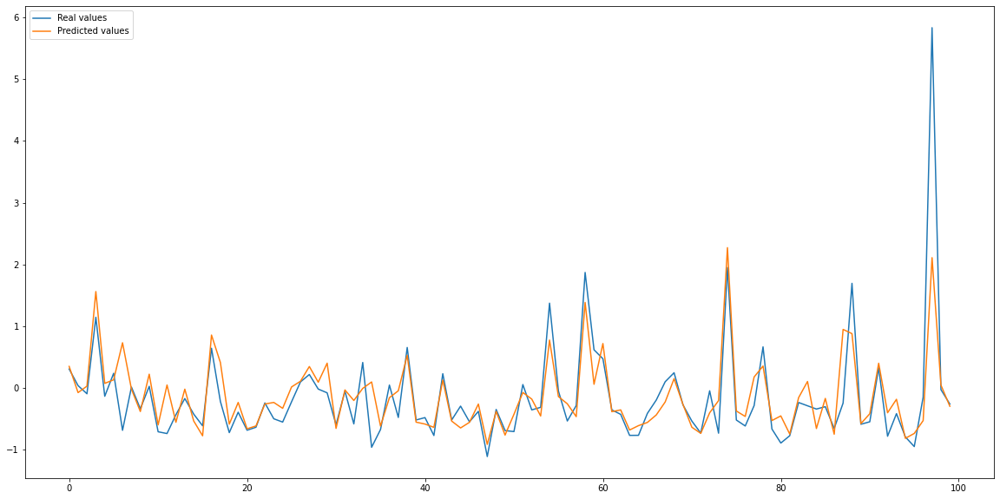

MAE = 0.33 0.37
MSE = 0.44 0.48
RMSE = 0.66 0.69
R2 = 0.56 0.51
AQI accuracy = 0.9976845300882451 0.998456472525211
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'O3-6']
-2.164964 3.992279


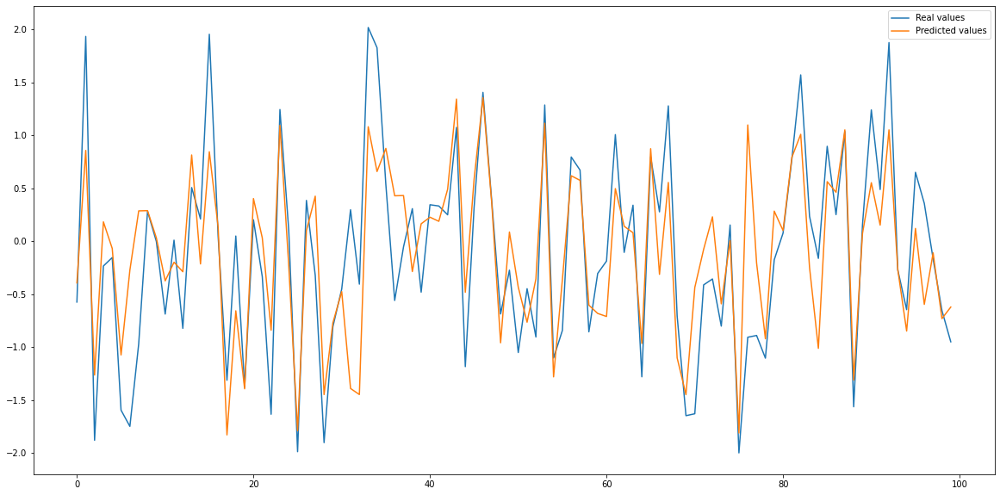

MAE = 0.44 0.47
MSE = 0.37 0.42
RMSE = 0.61 0.64
R2 = 0.63 0.58
AQI accuracy = 0.8256439698396295 0.8042193576043357
AQI accuracy+-1 = 0.9989818961227849 0.9984996478765424

SVR()
Param: PM10, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM10-6']
-1.1217722 4.0788355


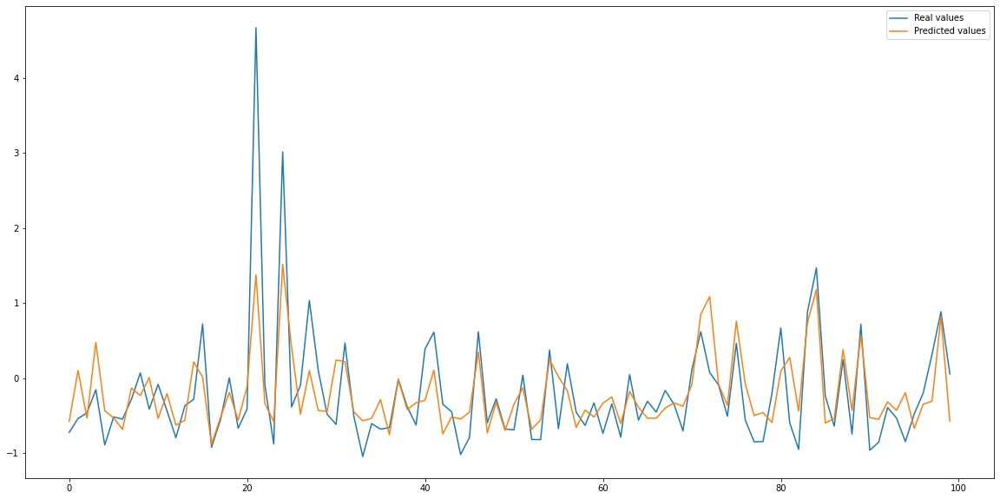

MAE = 0.42 0.45
MSE = 0.61 0.61
RMSE = 0.78 0.78
R2 = 0.4 0.35
AQI accuracy = 0.6758877159309021 0.6535988483685221
AQI accuracy+-1 = 0.9643114203454894 0.962619961612284

SVR()
Param: PM25, history: [6]:
['temperature-6', 'wind-6', 'humidity-6', 'precipitation_1-6', 'month', 'weekday', 'hour', 'PM25-6']
-1.1141064 5.321513


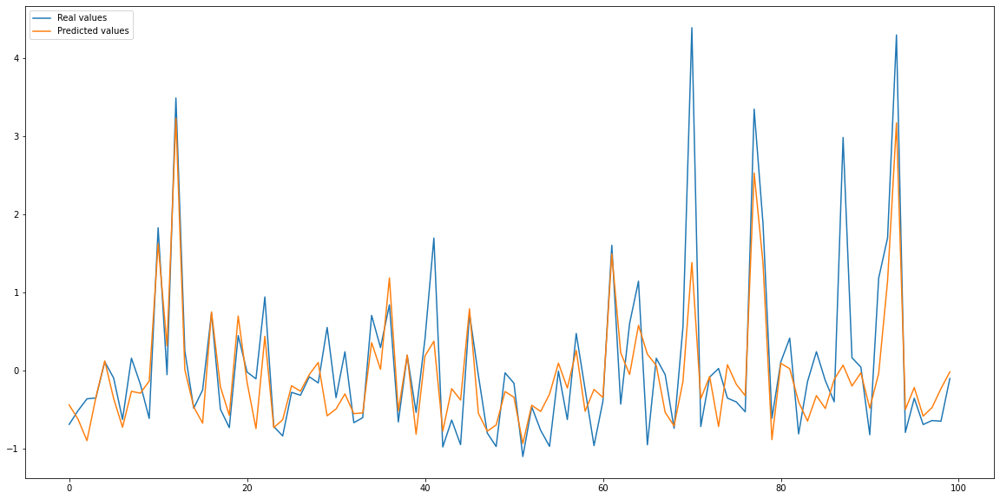

MAE = 0.38 0.44
MSE = 0.41 0.47
RMSE = 0.64 0.69
R2 = 0.59 0.54
AQI accuracy = 0.7538895296680764 0.7193971703916342
AQI accuracy+-1 = 0.9876201460976547 0.9853393479598114

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11', 'NO2-12']
-1.2261401 2.7844775


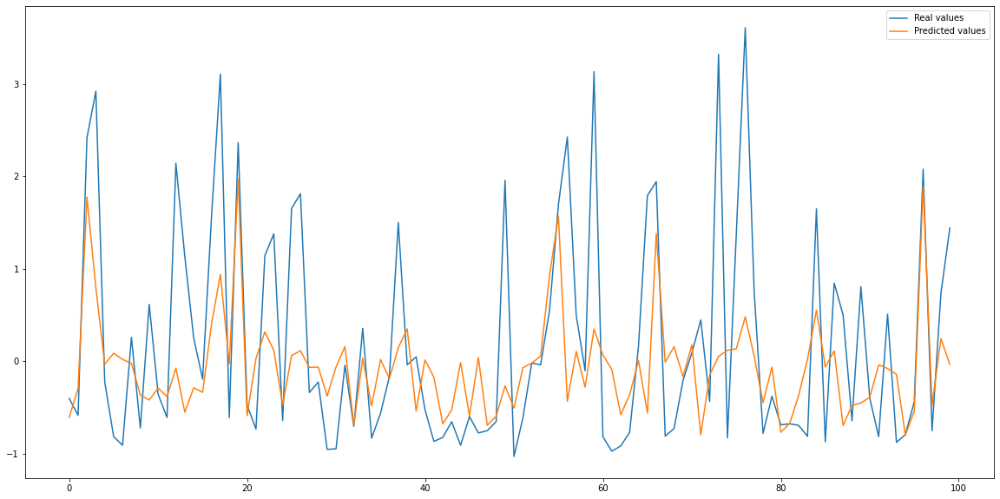

MAE = 0.28 0.57
MSE = 0.25 0.62
RMSE = 0.5 0.79
R2 = 0.75 0.38
AQI accuracy = 0.9034063311722594 0.7854880263546902
AQI accuracy+-1 = 0.9964205013409921 0.9876251214258563

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9', 'SO2-10', 'SO2-11', 'SO2-12']
-0.96582437 3.6978714


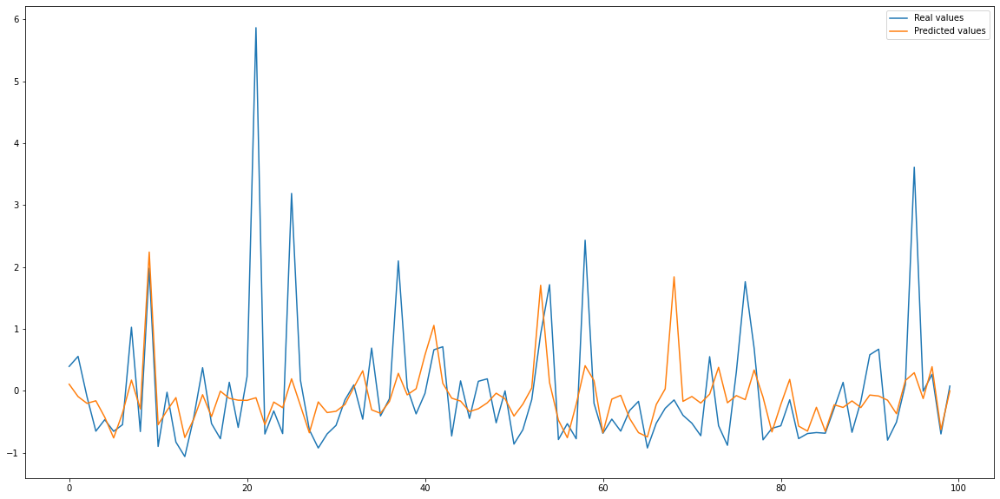

MAE = 0.25 0.46
MSE = 0.39 0.67
RMSE = 0.63 0.82
R2 = 0.61 0.34
AQI accuracy = 0.9977199681344944 0.9979123173277662
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'O3-6', 'O3-7', 'O3-8', 'O3-9', 'O3-10', 'O3-11', 'O3-12']
-2.2851799 2.875587


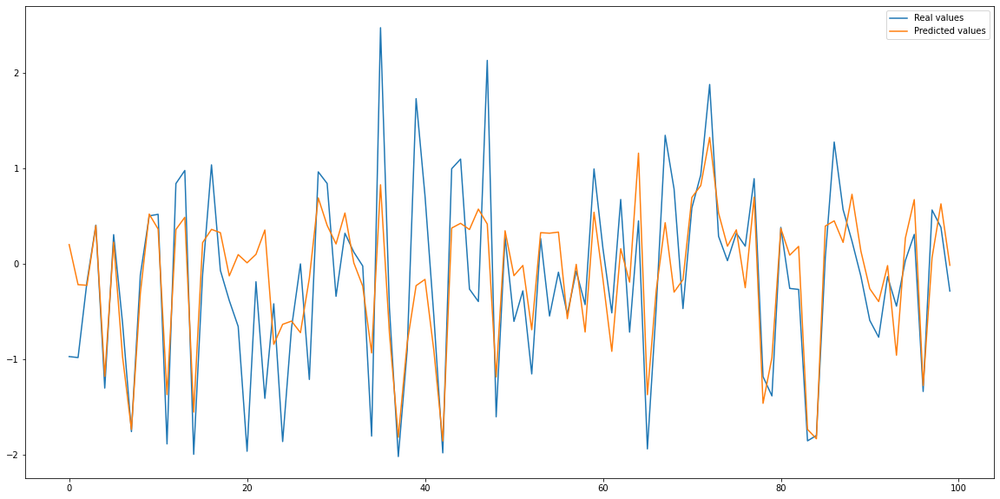

MAE = 0.26 0.53
MSE = 0.18 0.51
RMSE = 0.43 0.71
R2 = 0.82 0.49
AQI accuracy = 0.9025524213679481 0.7610771342985522
AQI accuracy+-1 = 0.9980029955067399 0.9944770344483275

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9', 'PM10-10', 'PM10-11', 'PM10-12']
-1.1433048 3.0272338


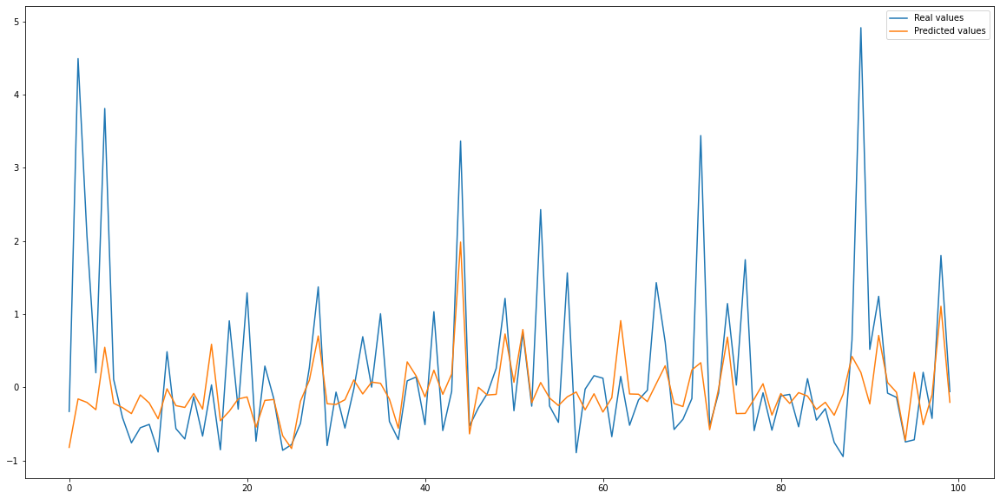

MAE = 0.28 0.51
MSE = 0.44 0.83
RMSE = 0.66 0.91
R2 = 0.55 0.23
AQI accuracy = 0.7847011268985792 0.5508794277595415
AQI accuracy+-1 = 0.9747672709456149 0.961295379942188

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9', 'PM25-10', 'PM25-11', 'PM25-12']
-1.1453916 3.956147


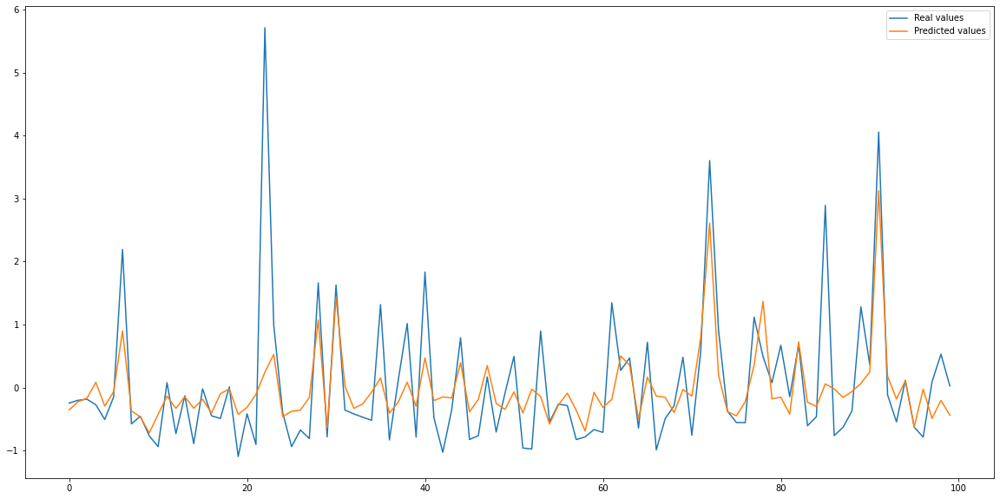

MAE = 0.26 0.5
MSE = 0.34 0.71
RMSE = 0.58 0.84
R2 = 0.66 0.34
AQI accuracy = 0.8488410055501142 0.6968443960826985
AQI accuracy+-1 = 0.9856894112525846 0.9798694232861807

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11', 'NO2-12']
-1.2261401 2.7844775


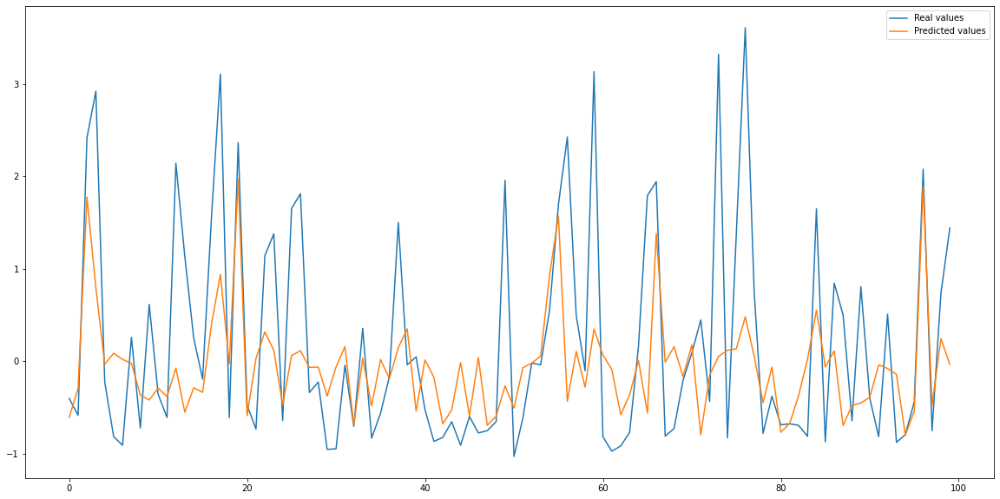

MAE = 0.28 0.57
MSE = 0.25 0.62
RMSE = 0.5 0.79
R2 = 0.75 0.38
AQI accuracy = 0.9034063311722594 0.7854880263546902
AQI accuracy+-1 = 0.9964205013409921 0.9876251214258563

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9', 'SO2-10', 'SO2-11', 'SO2-12']
-0.96582437 3.6978714


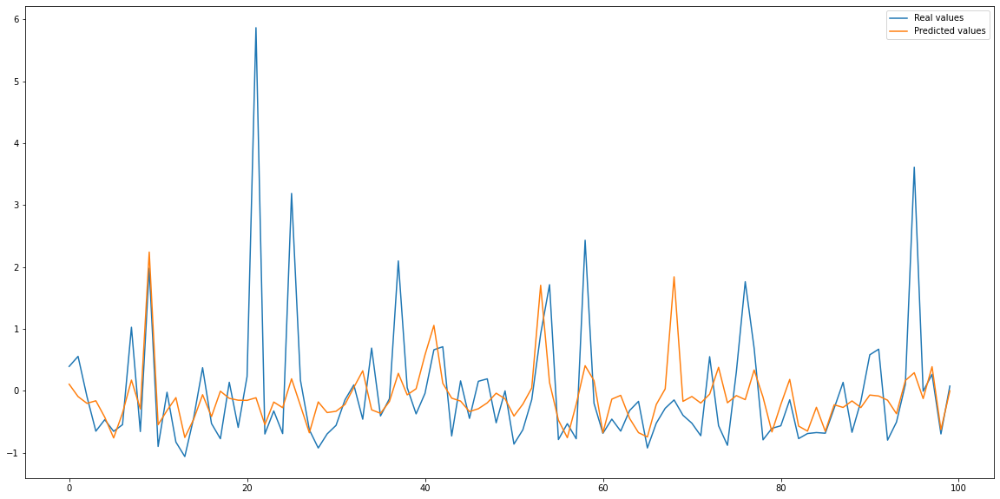

MAE = 0.25 0.46
MSE = 0.39 0.67
RMSE = 0.63 0.82
R2 = 0.61 0.34
AQI accuracy = 0.9977199681344944 0.9979123173277662
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'O3-6', 'O3-7', 'O3-8', 'O3-9', 'O3-10', 'O3-11', 'O3-12']
-2.2851799 2.875587


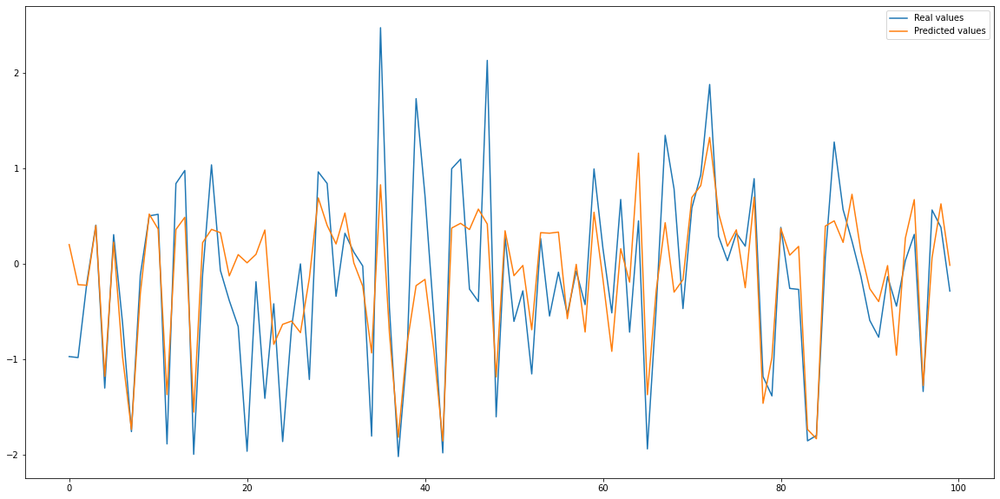

MAE = 0.26 0.53
MSE = 0.18 0.51
RMSE = 0.43 0.71
R2 = 0.82 0.49
AQI accuracy = 0.9025524213679481 0.7610771342985522
AQI accuracy+-1 = 0.9980029955067399 0.9944770344483275

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9', 'PM10-10', 'PM10-11', 'PM10-12']
-1.1433048 3.0272338


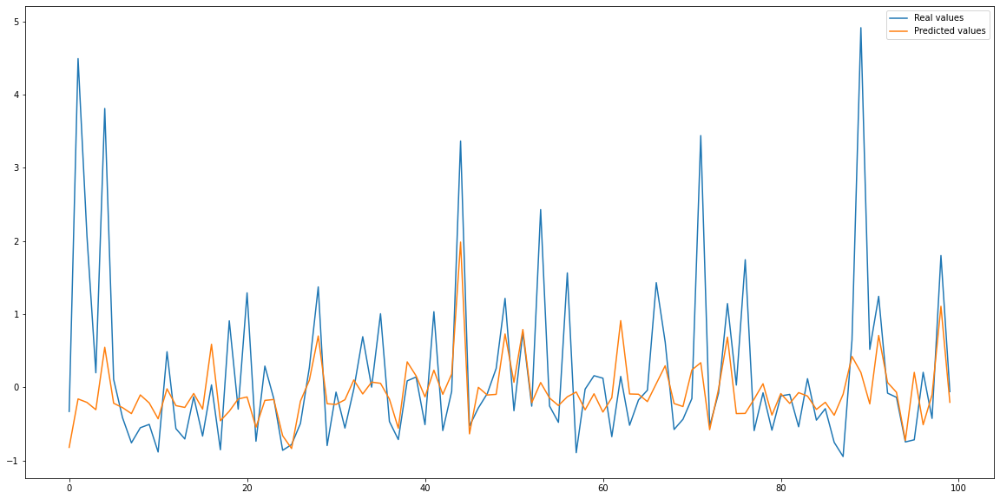

MAE = 0.28 0.51
MSE = 0.44 0.83
RMSE = 0.66 0.91
R2 = 0.55 0.23
AQI accuracy = 0.7847011268985792 0.5508794277595415
AQI accuracy+-1 = 0.9747672709456149 0.961295379942188

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9', 'PM25-10', 'PM25-11', 'PM25-12']
-1.1453916 3.956147


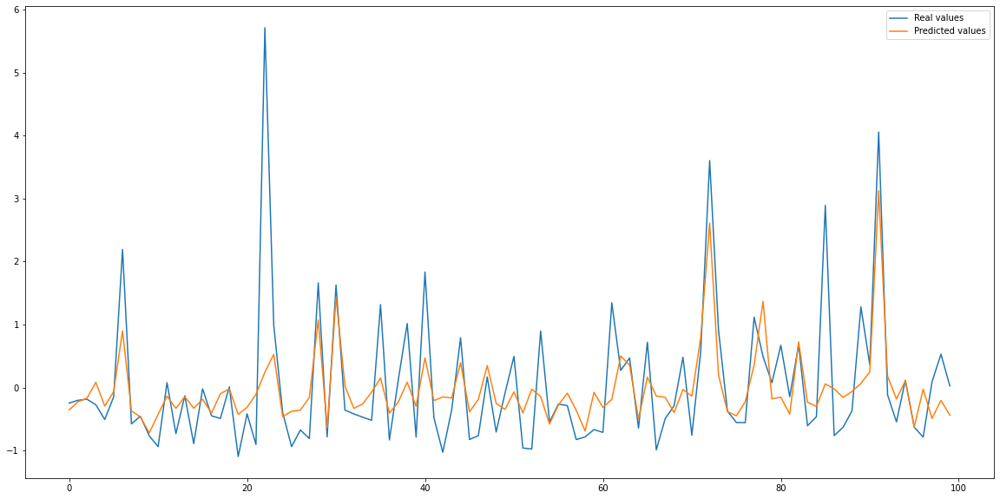

MAE = 0.26 0.5
MSE = 0.34 0.71
RMSE = 0.58 0.84
R2 = 0.66 0.34
AQI accuracy = 0.8488410055501142 0.6968443960826985
AQI accuracy+-1 = 0.9856894112525846 0.9798694232861807

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11', 'NO2-12']
-1.2261401 2.7844775


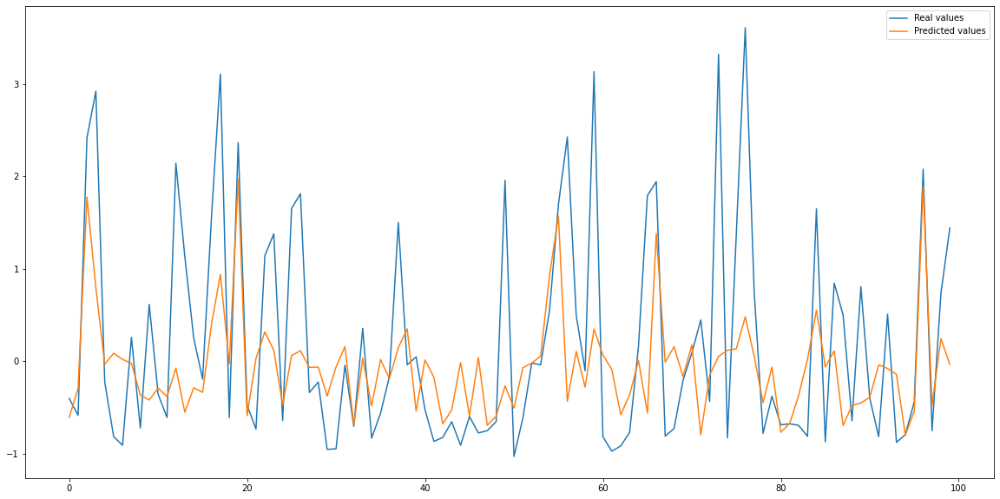

MAE = 0.28 0.57
MSE = 0.25 0.62
RMSE = 0.5 0.79
R2 = 0.75 0.38
AQI accuracy = 0.9034063311722594 0.7854880263546902
AQI accuracy+-1 = 0.9964205013409921 0.9876251214258563

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9', 'SO2-10', 'SO2-11', 'SO2-12']
-0.96582437 3.6978714


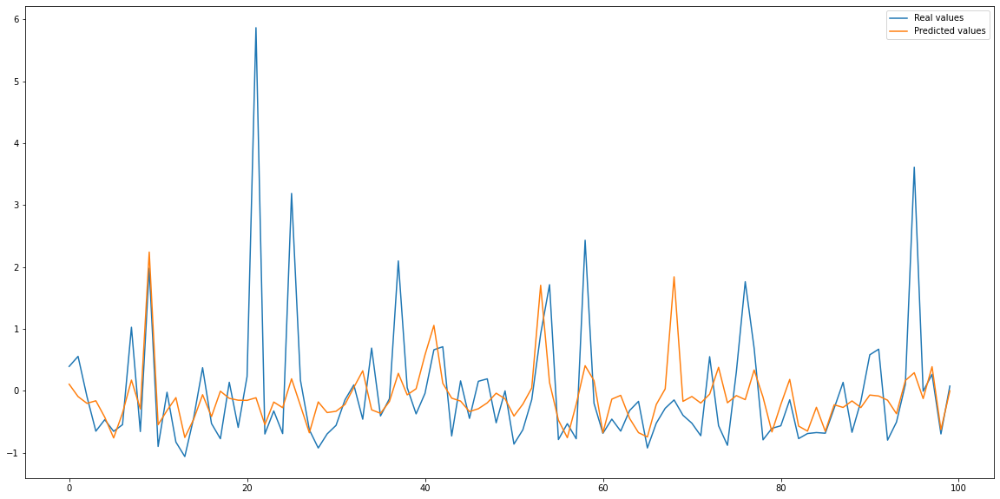

MAE = 0.25 0.46
MSE = 0.39 0.67
RMSE = 0.63 0.82
R2 = 0.61 0.34
AQI accuracy = 0.9977199681344944 0.9979123173277662
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'O3-6', 'O3-7', 'O3-8', 'O3-9', 'O3-10', 'O3-11', 'O3-12']
-2.2851799 2.875587


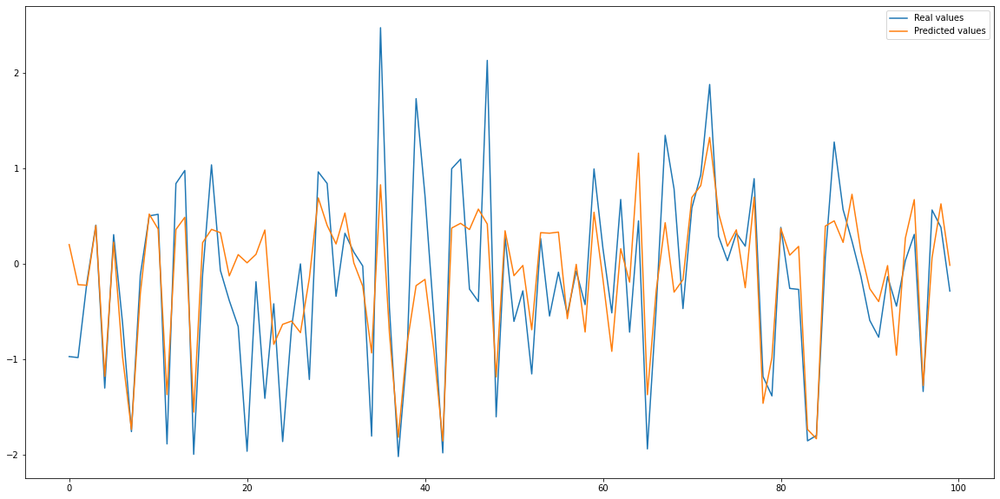

MAE = 0.26 0.53
MSE = 0.18 0.51
RMSE = 0.43 0.71
R2 = 0.82 0.49
AQI accuracy = 0.9025524213679481 0.7610771342985522
AQI accuracy+-1 = 0.9980029955067399 0.9944770344483275

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9', 'PM10-10', 'PM10-11', 'PM10-12']
-1.1433048 3.0272338


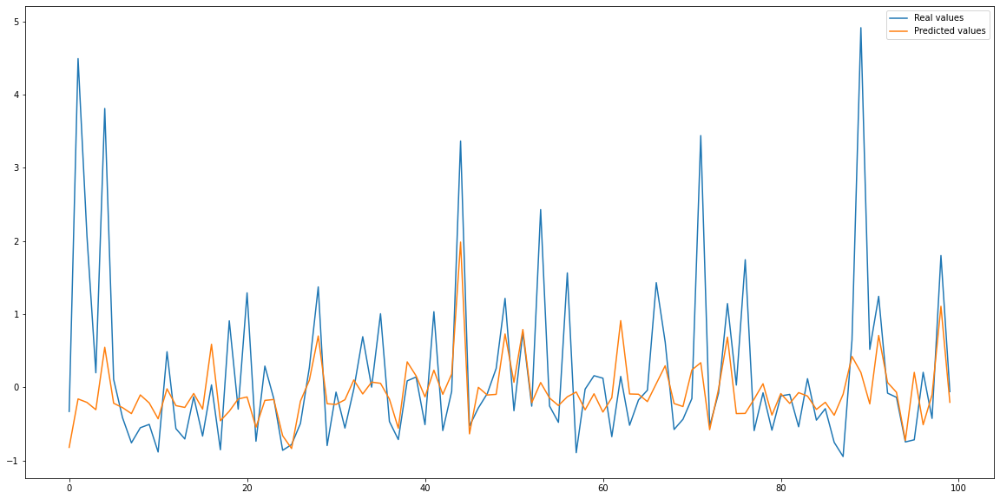

MAE = 0.28 0.51
MSE = 0.44 0.83
RMSE = 0.66 0.91
R2 = 0.55 0.23
AQI accuracy = 0.7847011268985792 0.5508794277595415
AQI accuracy+-1 = 0.9747672709456149 0.961295379942188

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9', 'PM25-10', 'PM25-11', 'PM25-12']
-1.1453916 3.956147


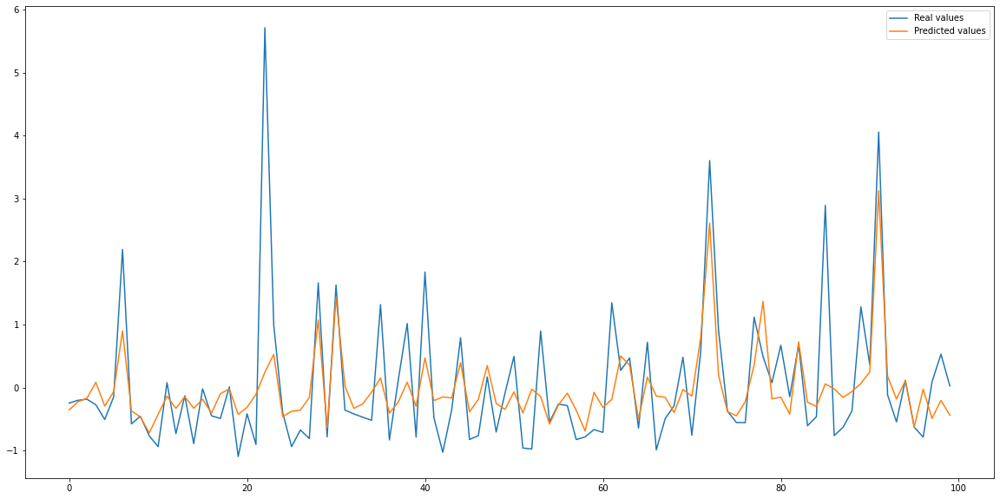

MAE = 0.26 0.5
MSE = 0.34 0.71
RMSE = 0.58 0.84
R2 = 0.66 0.34
AQI accuracy = 0.8488410055501142 0.6968443960826985
AQI accuracy+-1 = 0.9856894112525846 0.9798694232861807

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11', 'NO2-12']
-1.2261401 2.7844775


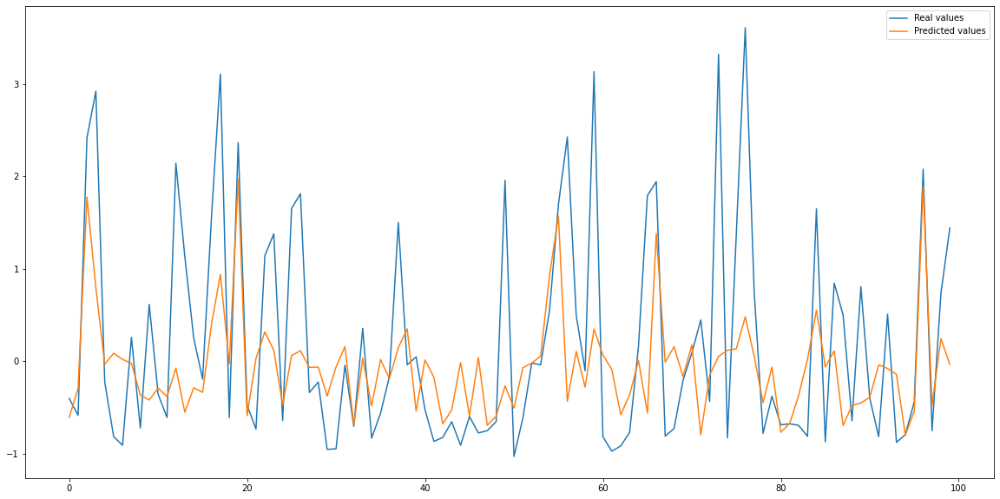

MAE = 0.28 0.57
MSE = 0.25 0.62
RMSE = 0.5 0.79
R2 = 0.75 0.38
AQI accuracy = 0.9034063311722594 0.7854880263546902
AQI accuracy+-1 = 0.9964205013409921 0.9876251214258563

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9', 'SO2-10', 'SO2-11', 'SO2-12']
-0.96582437 3.6978714


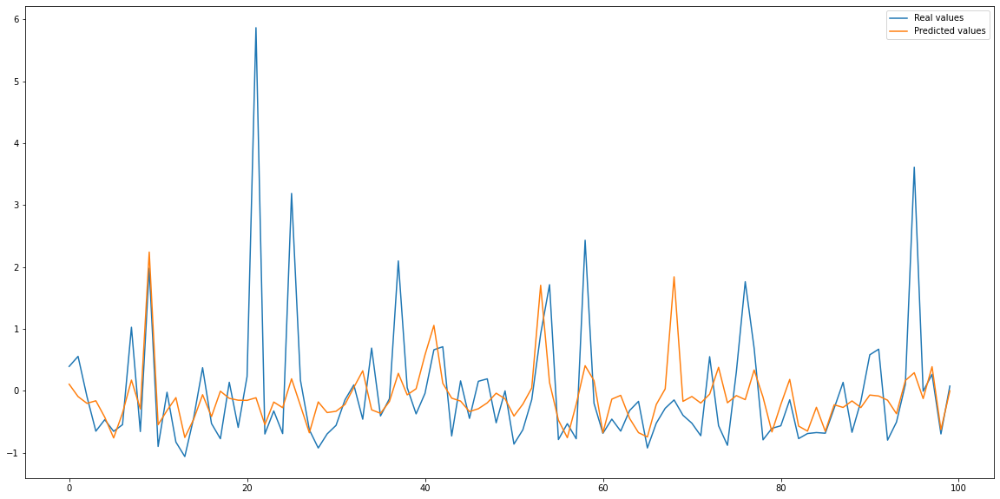

MAE = 0.25 0.46
MSE = 0.39 0.67
RMSE = 0.63 0.82
R2 = 0.61 0.34
AQI accuracy = 0.9977199681344944 0.9979123173277662
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'O3-6', 'O3-7', 'O3-8', 'O3-9', 'O3-10', 'O3-11', 'O3-12']
-2.2851799 2.875587


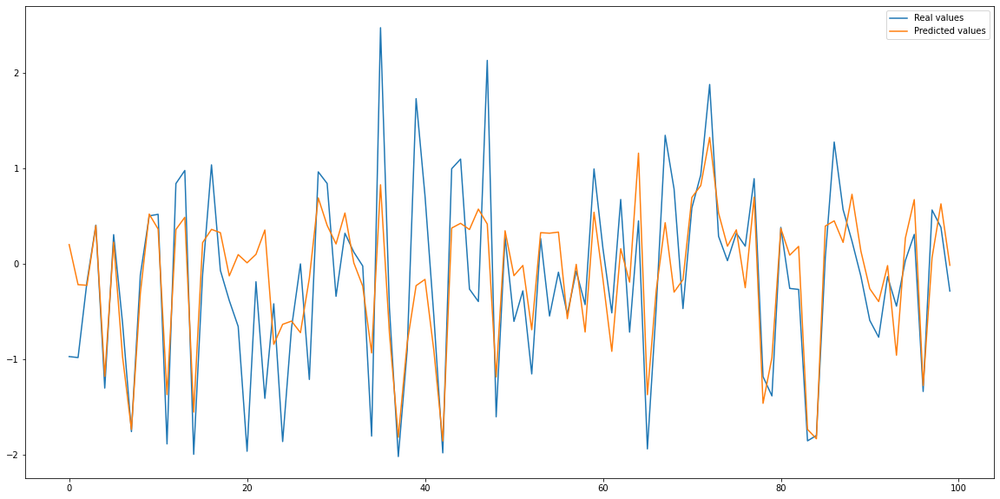

MAE = 0.26 0.53
MSE = 0.18 0.51
RMSE = 0.43 0.71
R2 = 0.82 0.49
AQI accuracy = 0.9025524213679481 0.7610771342985522
AQI accuracy+-1 = 0.9980029955067399 0.9944770344483275

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9', 'PM10-10', 'PM10-11', 'PM10-12']
-1.1433048 3.0272338


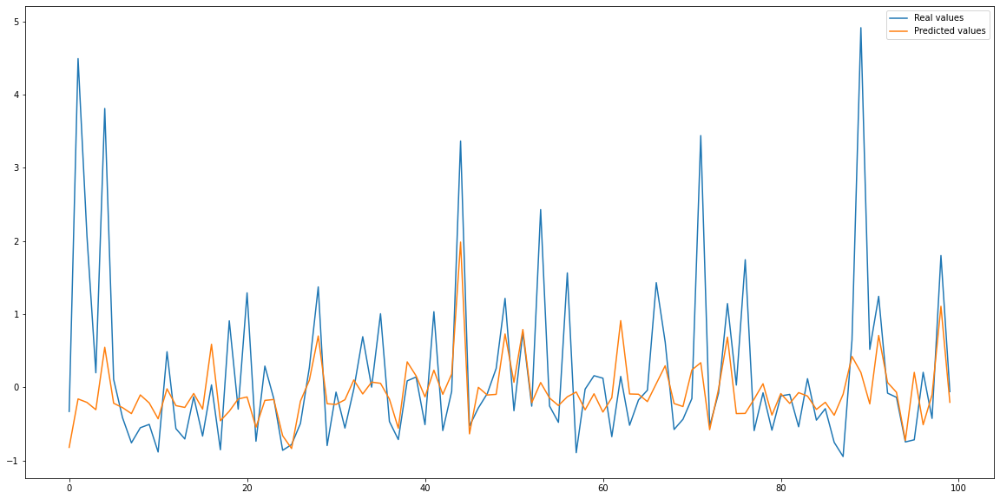

MAE = 0.28 0.51
MSE = 0.44 0.83
RMSE = 0.66 0.91
R2 = 0.55 0.23
AQI accuracy = 0.7847011268985792 0.5508794277595415
AQI accuracy+-1 = 0.9747672709456149 0.961295379942188

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9', 'PM25-10', 'PM25-11', 'PM25-12']
-1.1453916 3.956147


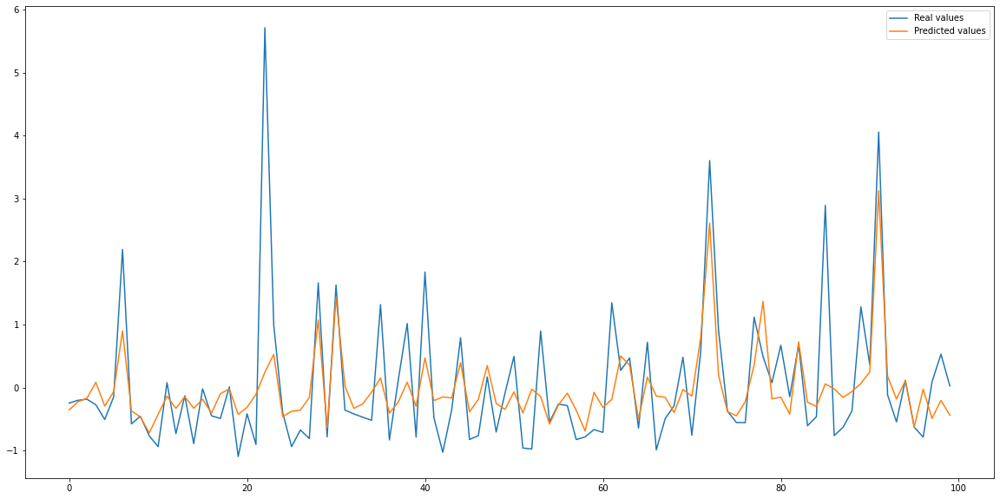

MAE = 0.26 0.5
MSE = 0.34 0.71
RMSE = 0.58 0.84
R2 = 0.66 0.34
AQI accuracy = 0.8488410055501142 0.6968443960826985
AQI accuracy+-1 = 0.9856894112525846 0.9798694232861807

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'NO2-6', 'NO2-7', 'NO2-8', 'NO2-9', 'NO2-10', 'NO2-11', 'NO2-12']
-1.2261401 2.7844775


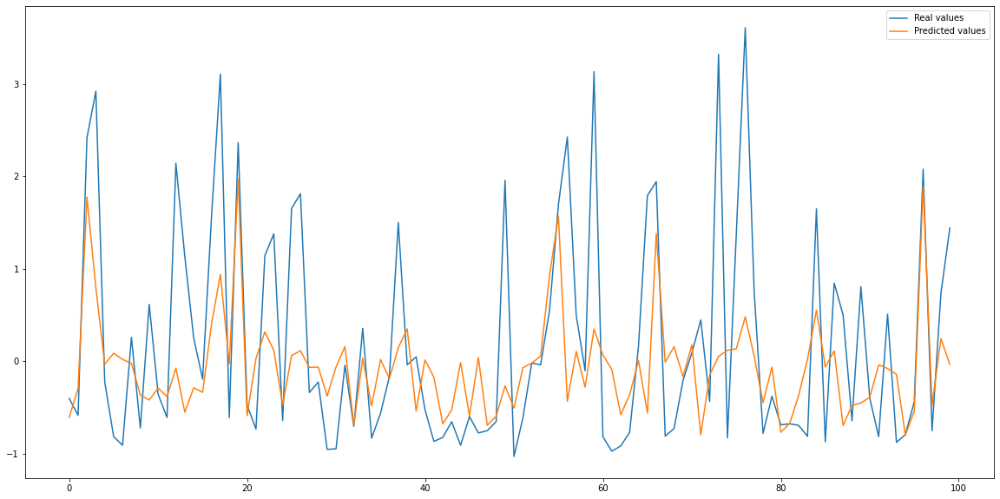

MAE = 0.28 0.57
MSE = 0.25 0.62
RMSE = 0.5 0.79
R2 = 0.75 0.38
AQI accuracy = 0.9034063311722594 0.7854880263546902
AQI accuracy+-1 = 0.9964205013409921 0.9876251214258563

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'SO2-6', 'SO2-7', 'SO2-8', 'SO2-9', 'SO2-10', 'SO2-11', 'SO2-12']
-0.96582437 3.6978714


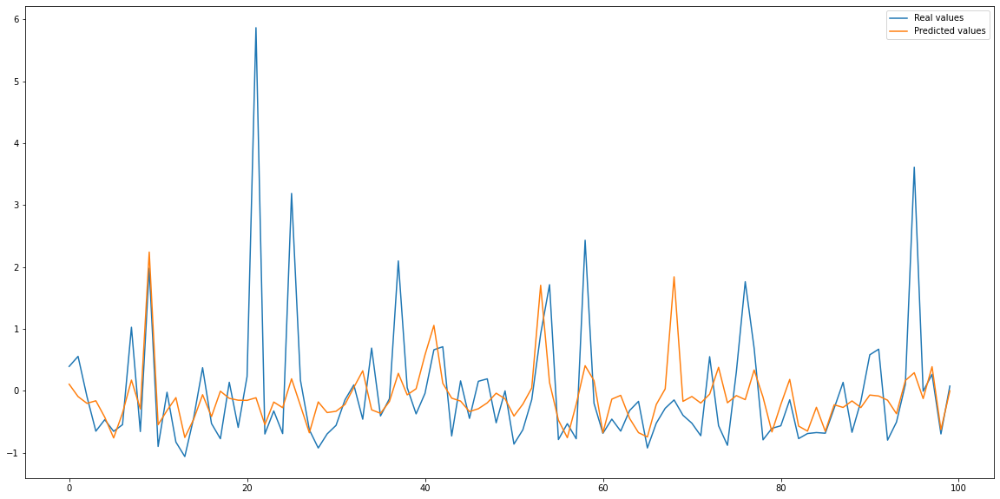

MAE = 0.25 0.46
MSE = 0.39 0.67
RMSE = 0.63 0.82
R2 = 0.61 0.34
AQI accuracy = 0.9977199681344944 0.9979123173277662
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'O3-6', 'O3-7', 'O3-8', 'O3-9', 'O3-10', 'O3-11', 'O3-12']
-2.2851799 2.875587


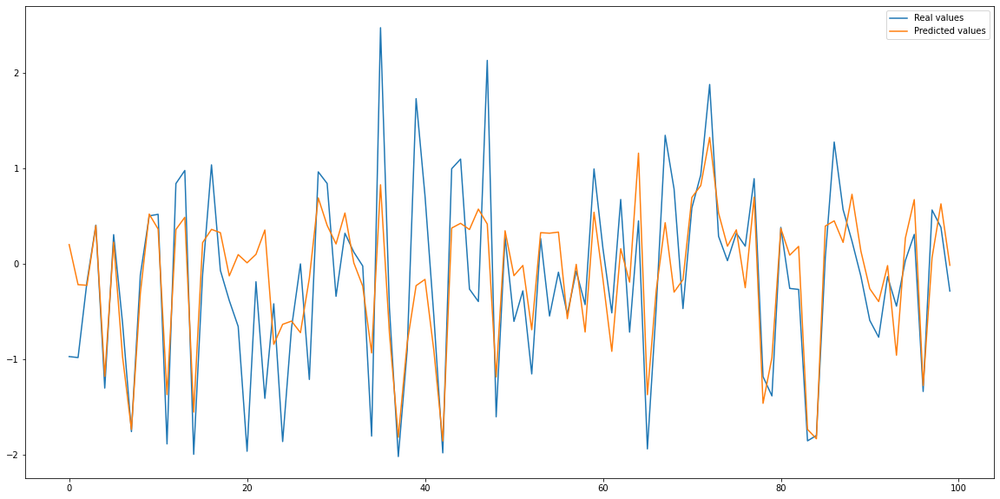

MAE = 0.26 0.53
MSE = 0.18 0.51
RMSE = 0.43 0.71
R2 = 0.82 0.49
AQI accuracy = 0.9025524213679481 0.7610771342985522
AQI accuracy+-1 = 0.9980029955067399 0.9944770344483275

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM10-6', 'PM10-7', 'PM10-8', 'PM10-9', 'PM10-10', 'PM10-11', 'PM10-12']
-1.1433048 3.0272338


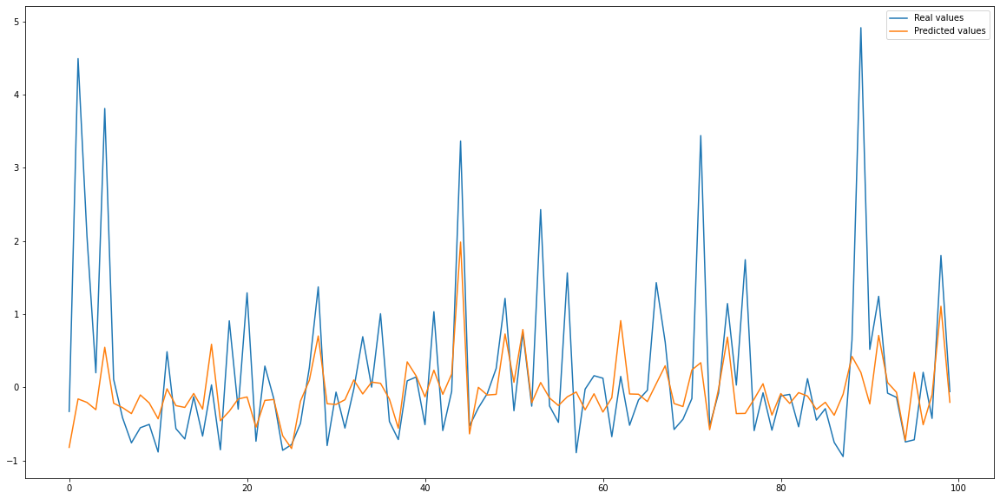

MAE = 0.28 0.51
MSE = 0.44 0.83
RMSE = 0.66 0.91
R2 = 0.55 0.23
AQI accuracy = 0.7847011268985792 0.5508794277595415
AQI accuracy+-1 = 0.9747672709456149 0.961295379942188

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM25-6', 'PM25-7', 'PM25-8', 'PM25-9', 'PM25-10', 'PM25-11', 'PM25-12']
-1.1453916 3.956147


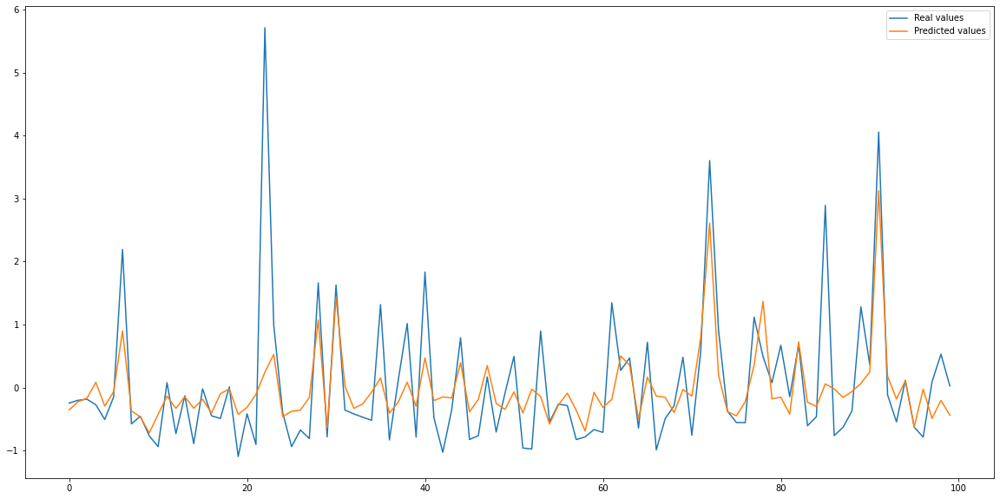

MAE = 0.26 0.5
MSE = 0.34 0.71
RMSE = 0.58 0.84
R2 = 0.66 0.34
AQI accuracy = 0.8488410055501142 0.6968443960826985
AQI accuracy+-1 = 0.9856894112525846 0.9798694232861807

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16',

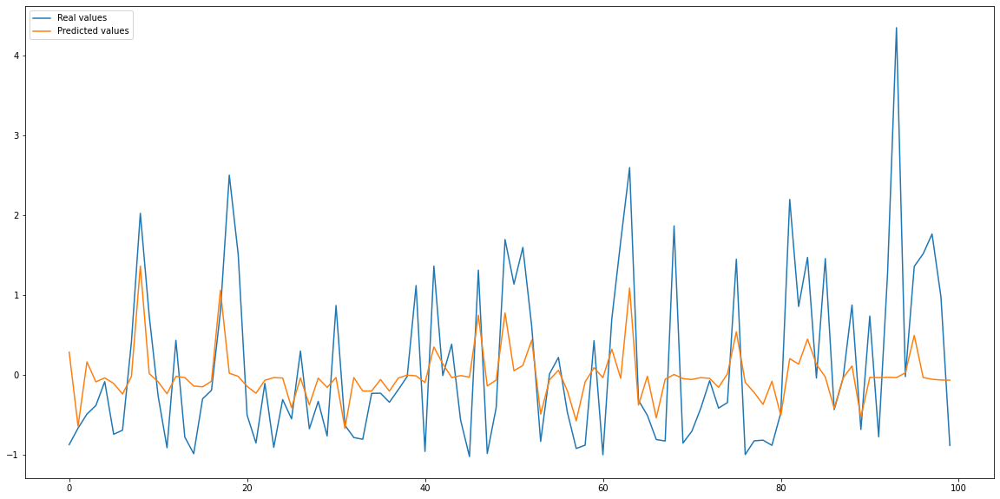

MAE = 0.29 0.65
MSE = 0.28 0.77
RMSE = 0.53 0.88
R2 = 0.72 0.25
AQI accuracy = 0.9067100777233312 0.7467771639042358
AQI accuracy+-1 = 0.9948367152300457 0.9764535648513549

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16'

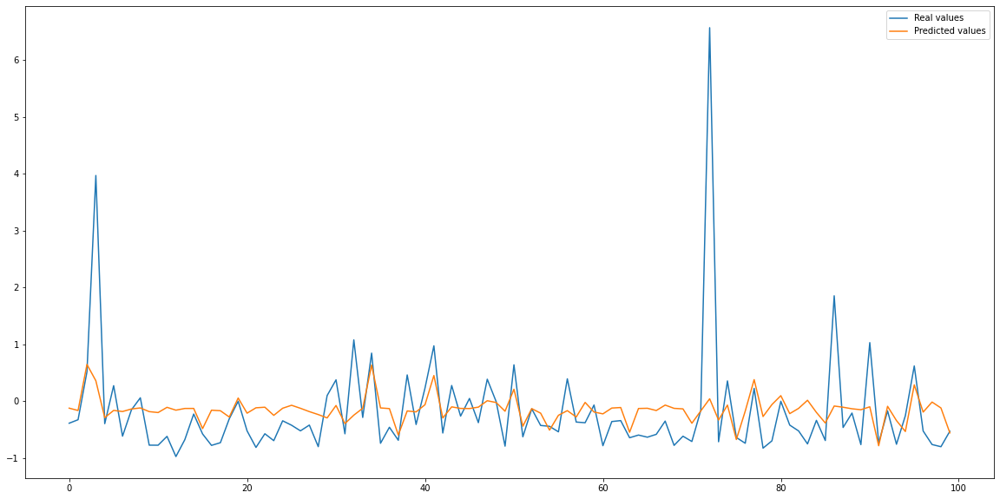

MAE = 0.26 0.49
MSE = 0.45 0.73
RMSE = 0.67 0.86
R2 = 0.56 0.23
AQI accuracy = 0.9977037553772817 0.9979074633806092
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month'

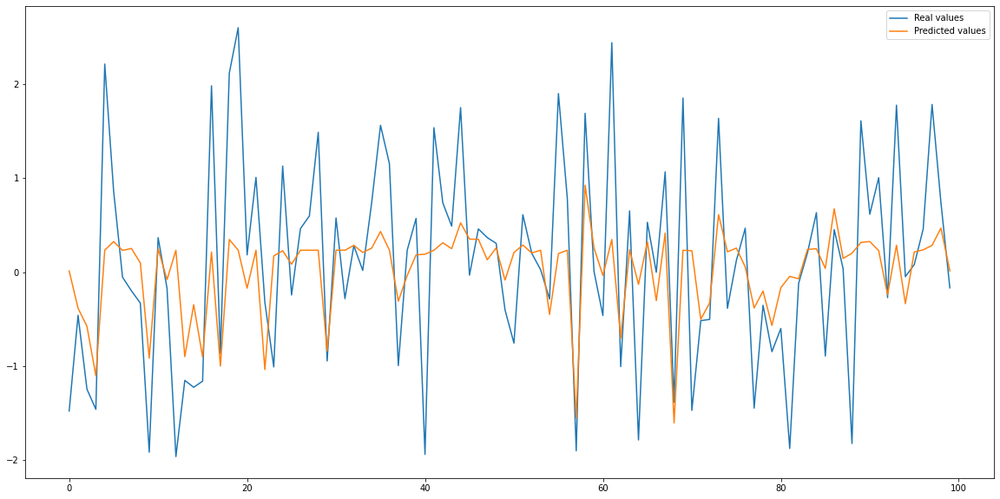

MAE = 0.26 0.59
MSE = 0.2 0.61
RMSE = 0.45 0.78
R2 = 0.8 0.38
AQI accuracy = 0.9009168931823405 0.7196880844454306
AQI accuracy+-1 = 0.997139166475152 0.9906171743747424

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 

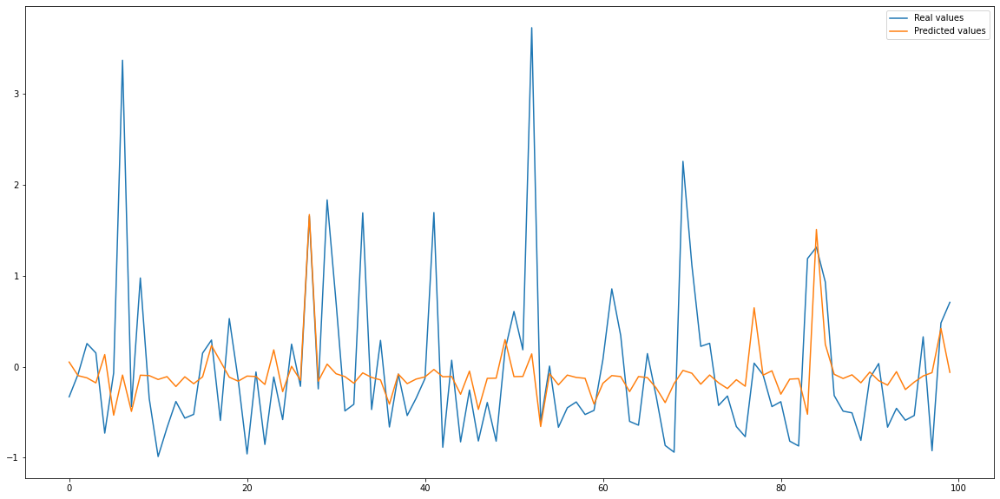

MAE = 0.27 0.53
MSE = 0.45 0.85
RMSE = 0.67 0.92
R2 = 0.55 0.18
AQI accuracy = 0.7792981626839492 0.4907453477958006
AQI accuracy+-1 = 0.9738148254114369 0.9641755398547119

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16

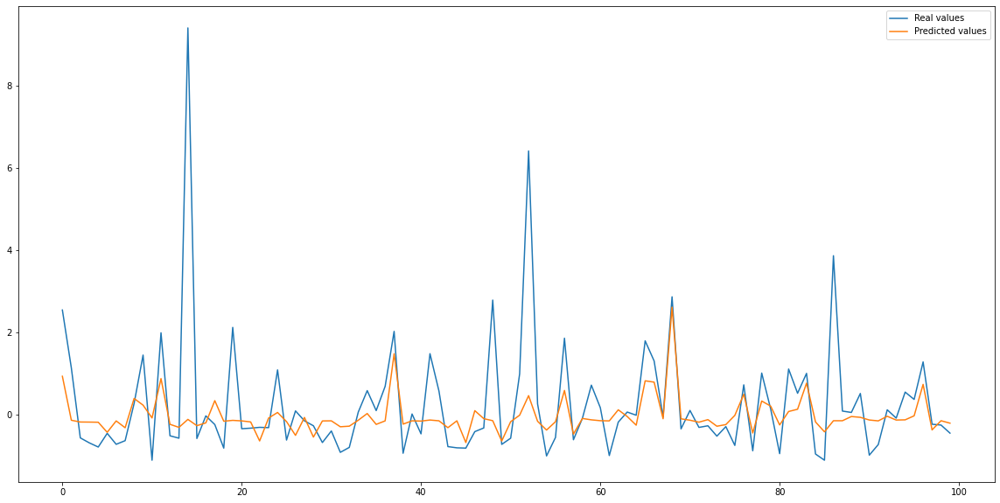

MAE = 0.27 0.53
MSE = 0.39 0.77
RMSE = 0.62 0.88
R2 = 0.63 0.26
AQI accuracy = 0.8566983528874426 0.697191139529573
AQI accuracy+-1 = 0.9834146898461362 0.9741950216944508

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16',

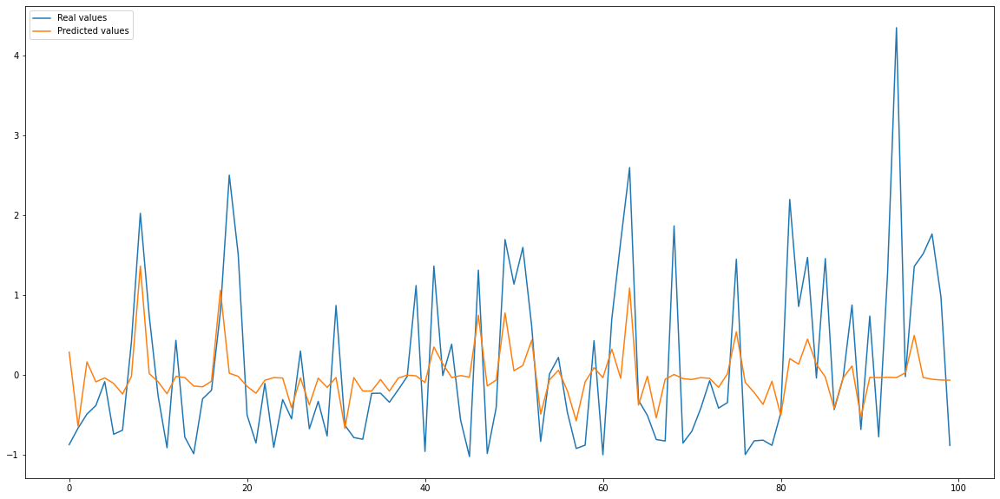

MAE = 0.29 0.65
MSE = 0.28 0.77
RMSE = 0.53 0.88
R2 = 0.72 0.25
AQI accuracy = 0.9067100777233312 0.7467771639042358
AQI accuracy+-1 = 0.9948367152300457 0.9764535648513549

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16'

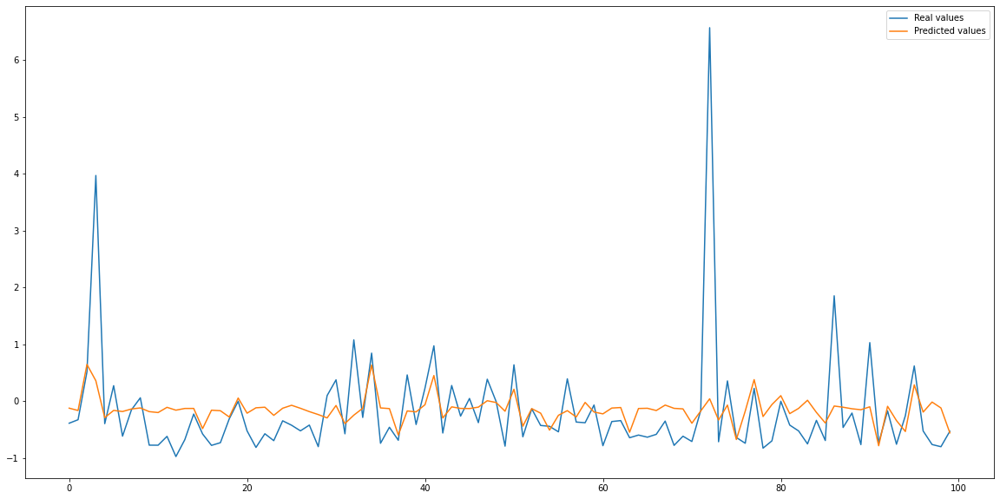

MAE = 0.26 0.49
MSE = 0.45 0.73
RMSE = 0.67 0.86
R2 = 0.56 0.23
AQI accuracy = 0.9977037553772817 0.9979074633806092
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month'

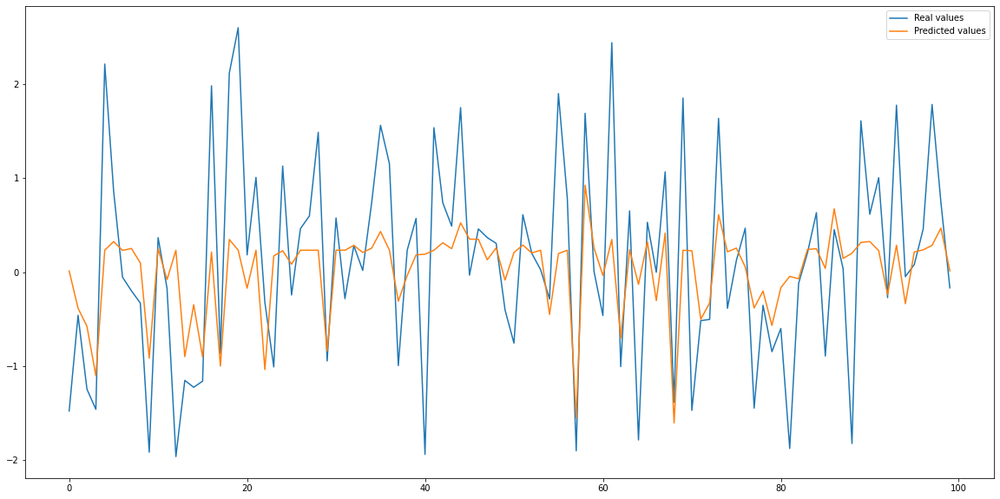

MAE = 0.26 0.59
MSE = 0.2 0.61
RMSE = 0.45 0.78
R2 = 0.8 0.38
AQI accuracy = 0.9009168931823405 0.7196880844454306
AQI accuracy+-1 = 0.997139166475152 0.9906171743747424

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 

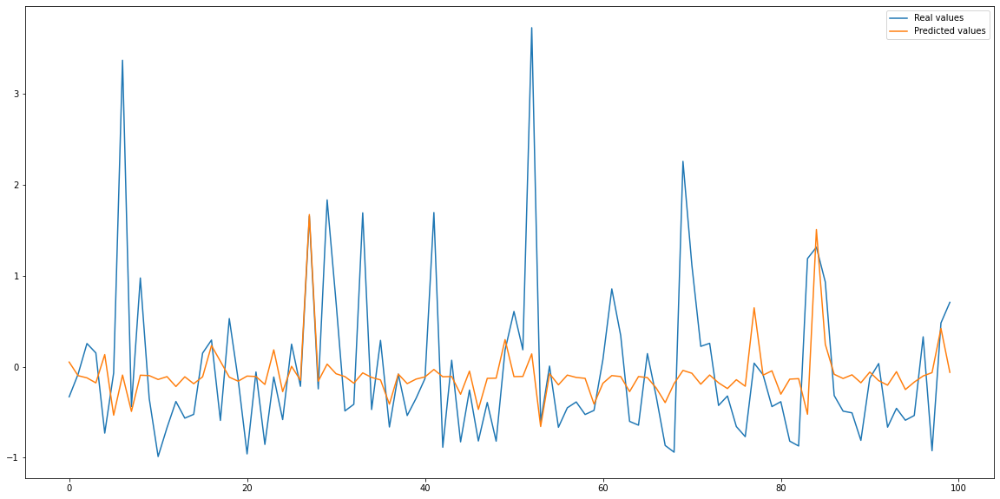

MAE = 0.27 0.53
MSE = 0.45 0.85
RMSE = 0.67 0.92
R2 = 0.55 0.18
AQI accuracy = 0.7792981626839492 0.4907453477958006
AQI accuracy+-1 = 0.9738148254114369 0.9641755398547119

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16

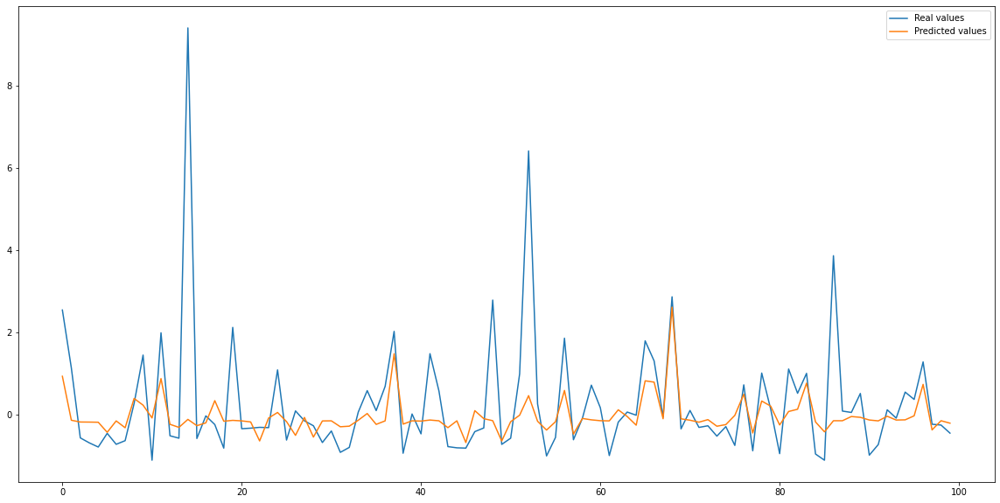

MAE = 0.27 0.53
MSE = 0.39 0.77
RMSE = 0.62 0.88
R2 = 0.63 0.26
AQI accuracy = 0.8566983528874426 0.697191139529573
AQI accuracy+-1 = 0.9834146898461362 0.9741950216944508

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16',

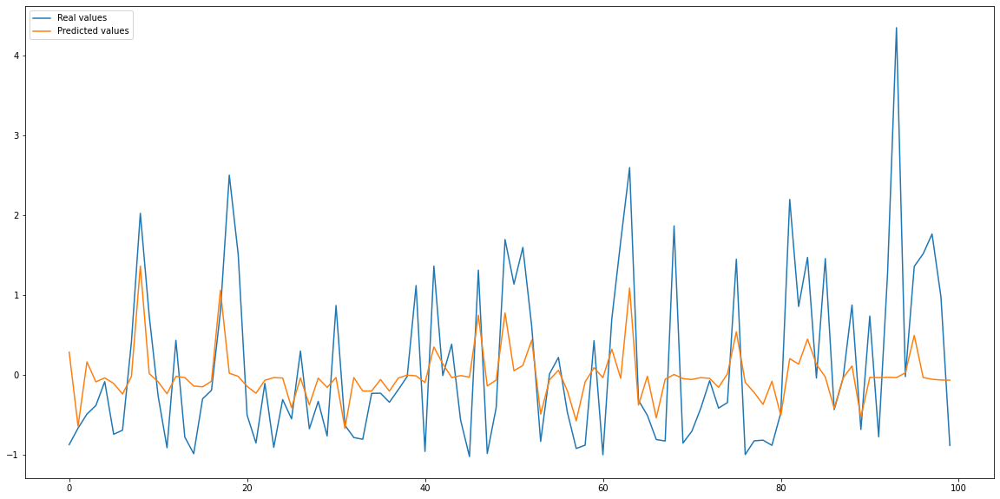

MAE = 0.29 0.65
MSE = 0.28 0.77
RMSE = 0.53 0.88
R2 = 0.72 0.25
AQI accuracy = 0.9067100777233312 0.7467771639042358
AQI accuracy+-1 = 0.9948367152300457 0.9764535648513549

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16'

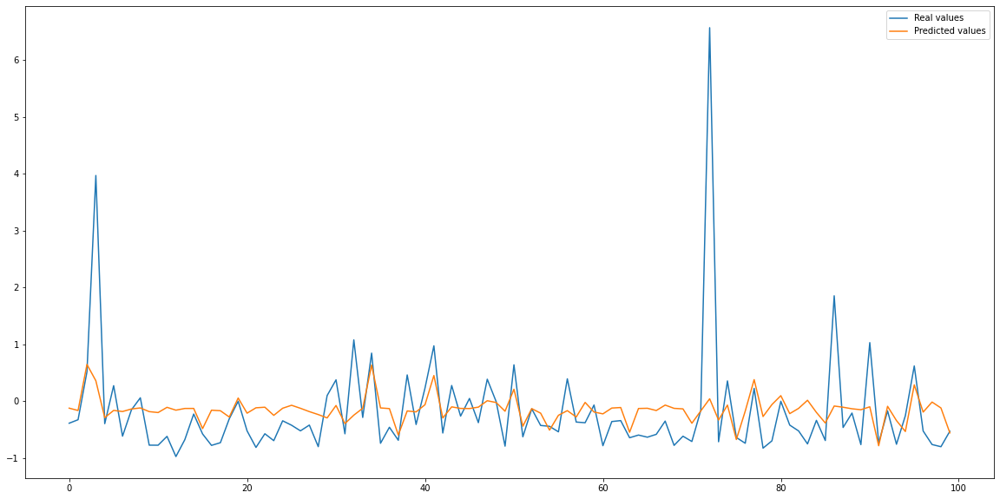

MAE = 0.26 0.49
MSE = 0.45 0.73
RMSE = 0.67 0.86
R2 = 0.56 0.23
AQI accuracy = 0.9977037553772817 0.9979074633806092
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month'

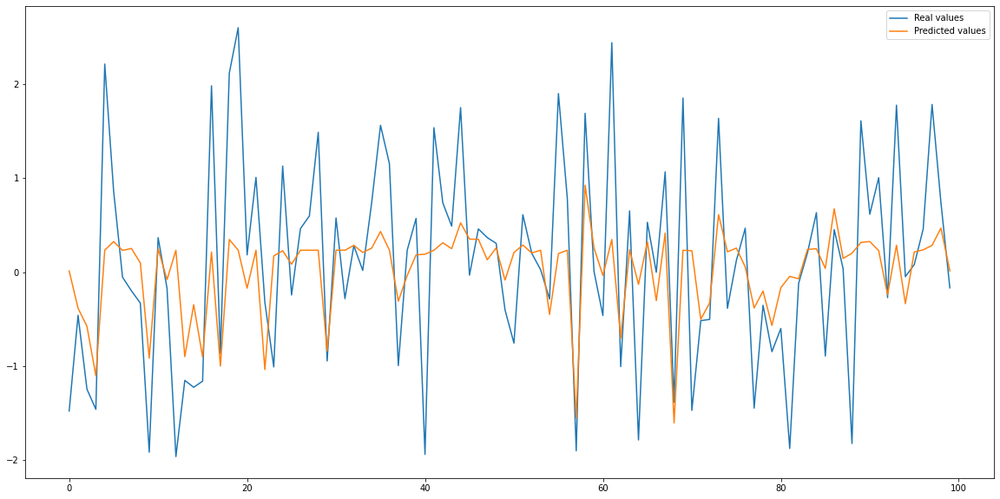

MAE = 0.26 0.59
MSE = 0.2 0.61
RMSE = 0.45 0.78
R2 = 0.8 0.38
AQI accuracy = 0.9009168931823405 0.7196880844454306
AQI accuracy+-1 = 0.997139166475152 0.9906171743747424

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 

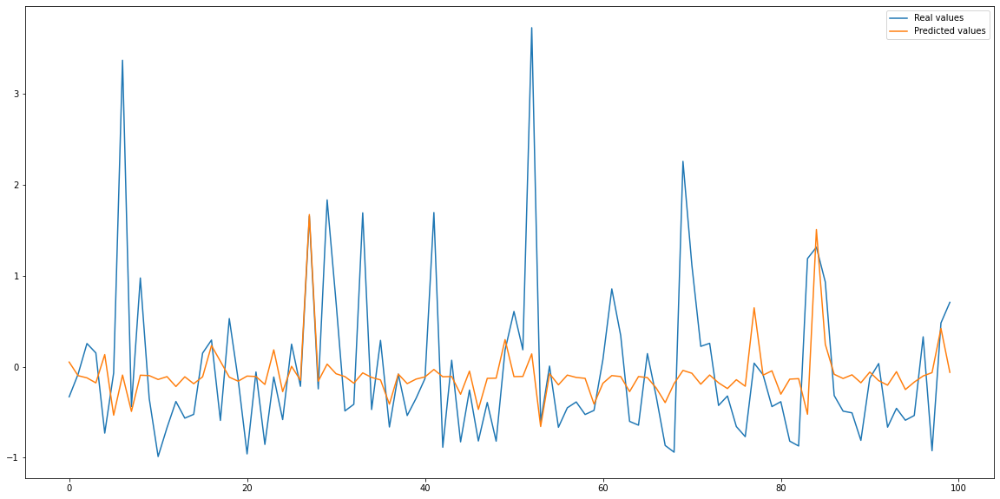

MAE = 0.27 0.53
MSE = 0.45 0.85
RMSE = 0.67 0.92
R2 = 0.55 0.18
AQI accuracy = 0.7792981626839492 0.4907453477958006
AQI accuracy+-1 = 0.9738148254114369 0.9641755398547119

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16

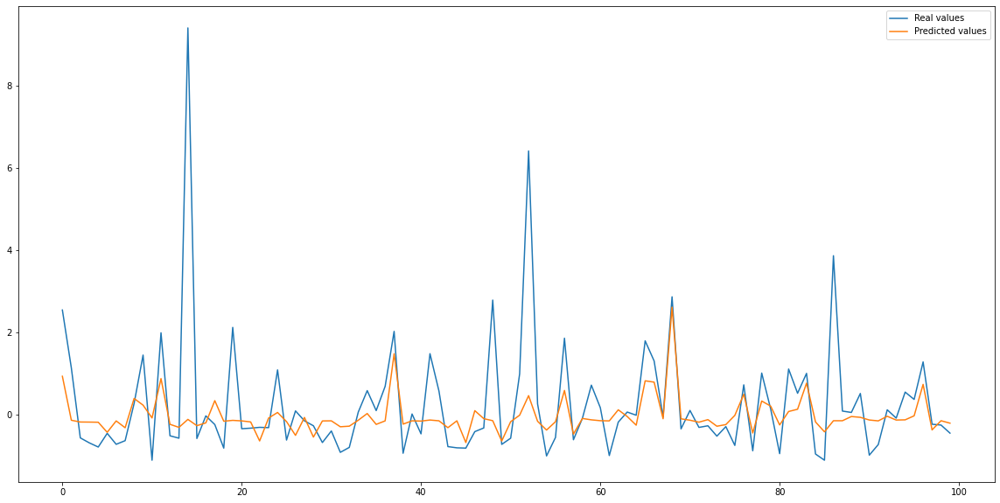

MAE = 0.27 0.53
MSE = 0.39 0.77
RMSE = 0.62 0.88
R2 = 0.63 0.26
AQI accuracy = 0.8566983528874426 0.697191139529573
AQI accuracy+-1 = 0.9834146898461362 0.9741950216944508

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16',

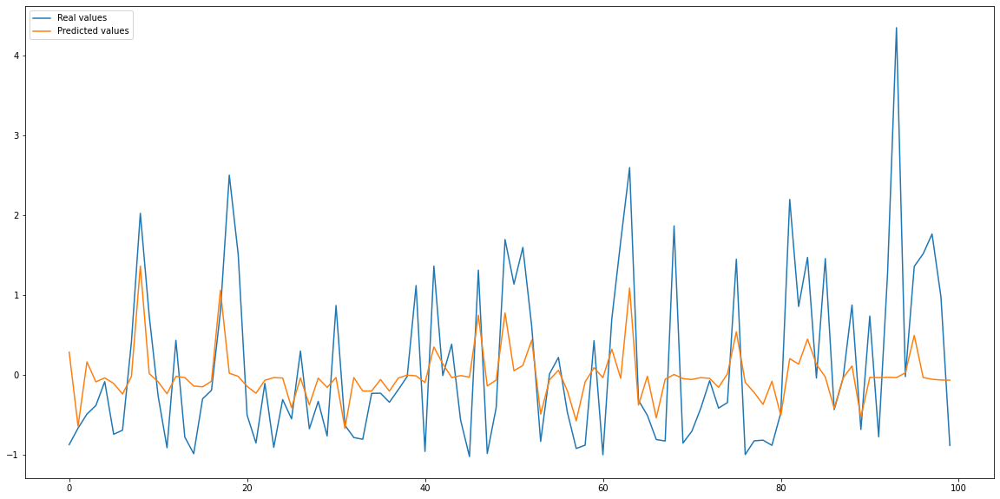

MAE = 0.29 0.65
MSE = 0.28 0.77
RMSE = 0.53 0.88
R2 = 0.72 0.25
AQI accuracy = 0.9067100777233312 0.7467771639042358
AQI accuracy+-1 = 0.9948367152300457 0.9764535648513549

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16'

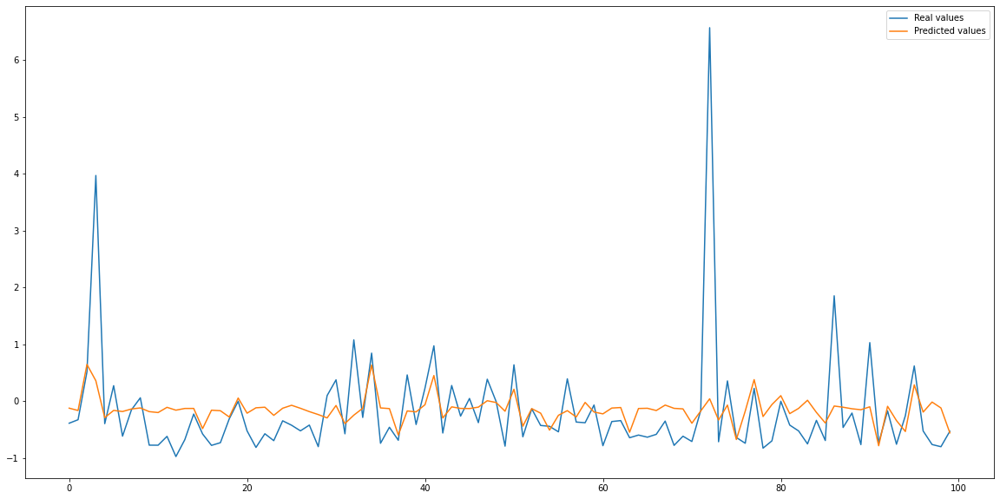

MAE = 0.26 0.49
MSE = 0.45 0.73
RMSE = 0.67 0.86
R2 = 0.56 0.23
AQI accuracy = 0.9977037553772817 0.9979074633806092
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month'

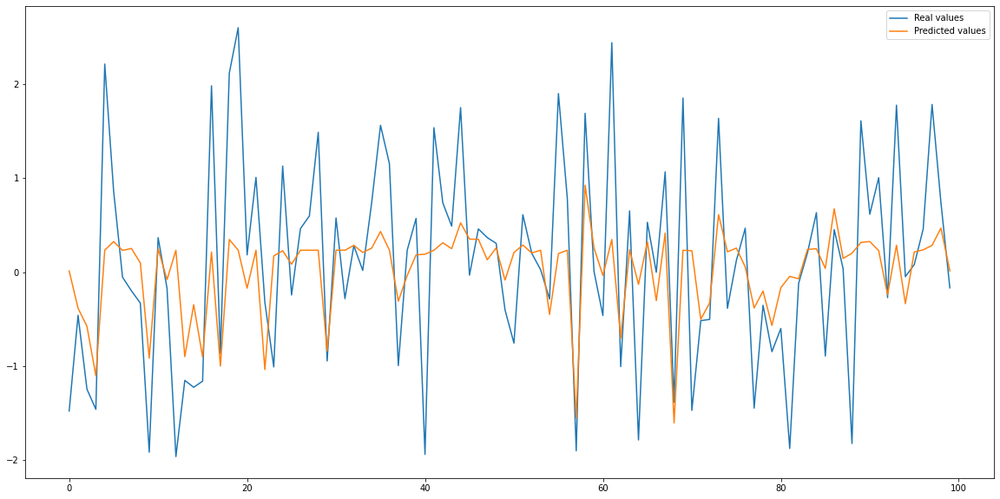

MAE = 0.26 0.59
MSE = 0.2 0.61
RMSE = 0.45 0.78
R2 = 0.8 0.38
AQI accuracy = 0.9009168931823405 0.7196880844454306
AQI accuracy+-1 = 0.997139166475152 0.9906171743747424

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 

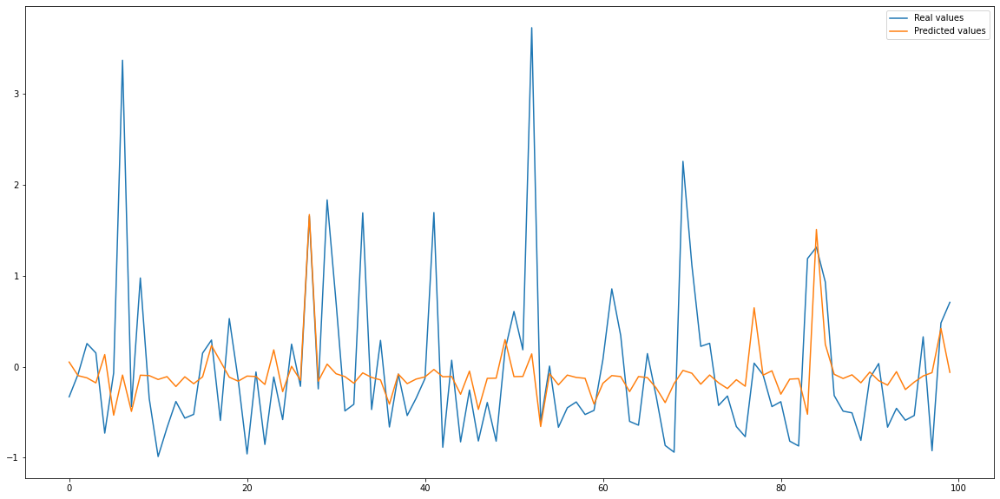

MAE = 0.27 0.53
MSE = 0.45 0.85
RMSE = 0.67 0.92
R2 = 0.55 0.18
AQI accuracy = 0.7792981626839492 0.4907453477958006
AQI accuracy+-1 = 0.9738148254114369 0.9641755398547119

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16

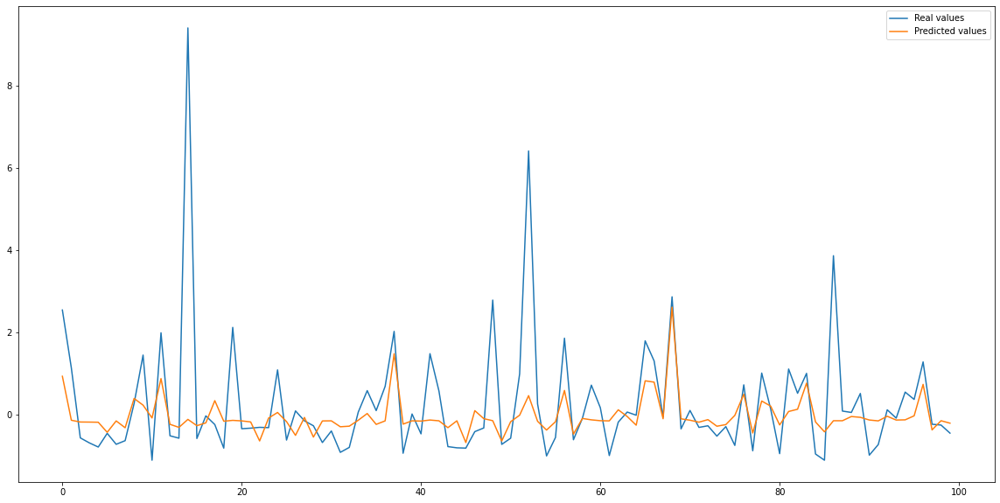

MAE = 0.27 0.53
MSE = 0.39 0.77
RMSE = 0.62 0.88
R2 = 0.63 0.26
AQI accuracy = 0.8566983528874426 0.697191139529573
AQI accuracy+-1 = 0.9834146898461362 0.9741950216944508

SVR()
Param: NO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16',

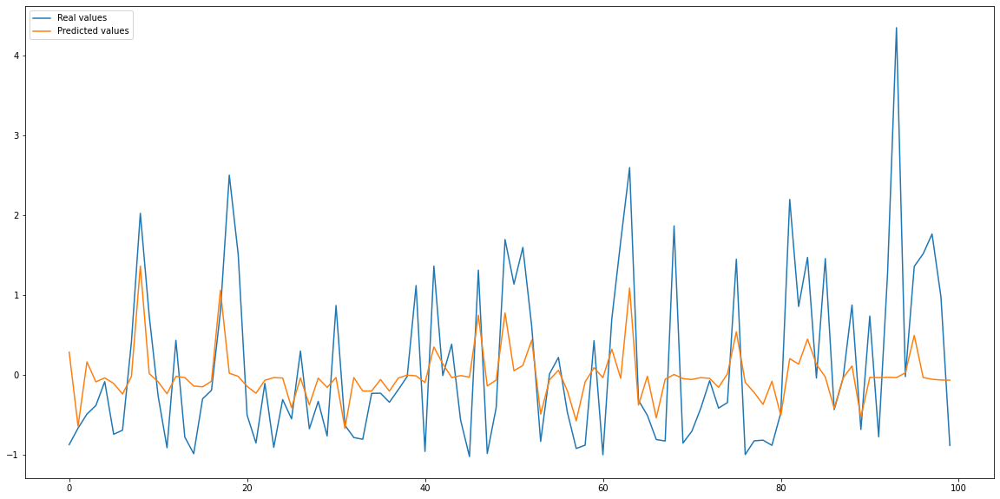

MAE = 0.29 0.65
MSE = 0.28 0.77
RMSE = 0.53 0.88
R2 = 0.72 0.25
AQI accuracy = 0.9067100777233312 0.7467771639042358
AQI accuracy+-1 = 0.9948367152300457 0.9764535648513549

SVR()
Param: SO2, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16'

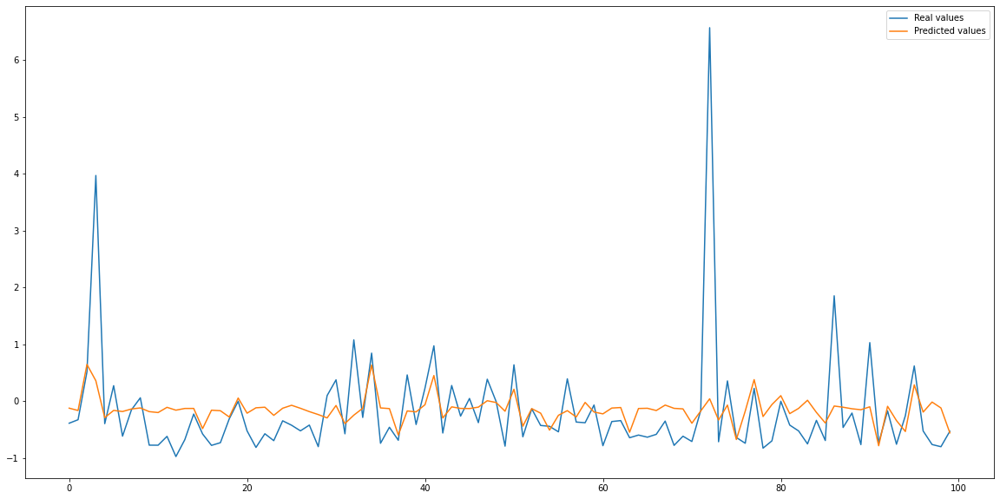

MAE = 0.26 0.49
MSE = 0.45 0.73
RMSE = 0.67 0.86
R2 = 0.56 0.23
AQI accuracy = 0.9977037553772817 0.9979074633806092
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month'

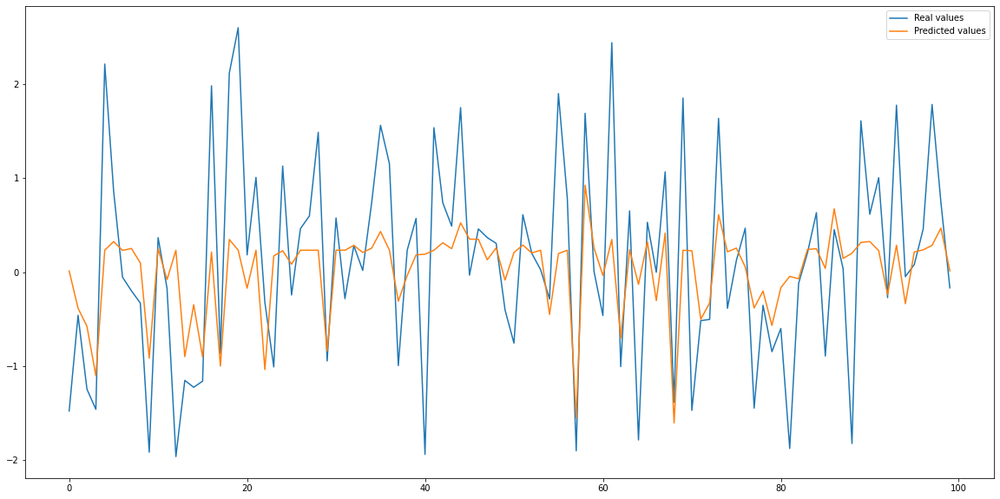

MAE = 0.26 0.59
MSE = 0.2 0.61
RMSE = 0.45 0.78
R2 = 0.8 0.38
AQI accuracy = 0.9009168931823405 0.7196880844454306
AQI accuracy+-1 = 0.997139166475152 0.9906171743747424

SVR()
Param: PM10, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 

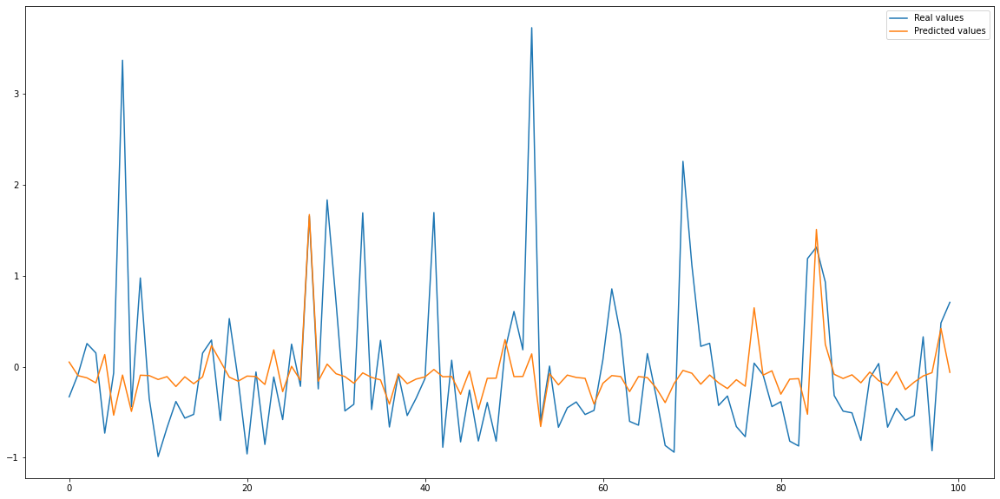

MAE = 0.27 0.53
MSE = 0.45 0.85
RMSE = 0.67 0.92
R2 = 0.55 0.18
AQI accuracy = 0.7792981626839492 0.4907453477958006
AQI accuracy+-1 = 0.9738148254114369 0.9641755398547119

SVR()
Param: PM25, history: [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]:
['temperature-6', 'temperature-7', 'temperature-8', 'temperature-9', 'temperature-10', 'temperature-11', 'temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-6', 'wind-7', 'wind-8', 'wind-9', 'wind-10', 'wind-11', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-6', 'humidity-7', 'humidity-8', 'humidity-9', 'humidity-10', 'humidity-11', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-6', 'precipitation_1-7', 'precipitation_1-8', 'precipitation_1-9', 'precipitation_1-10', 'precipitation_1-11', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16

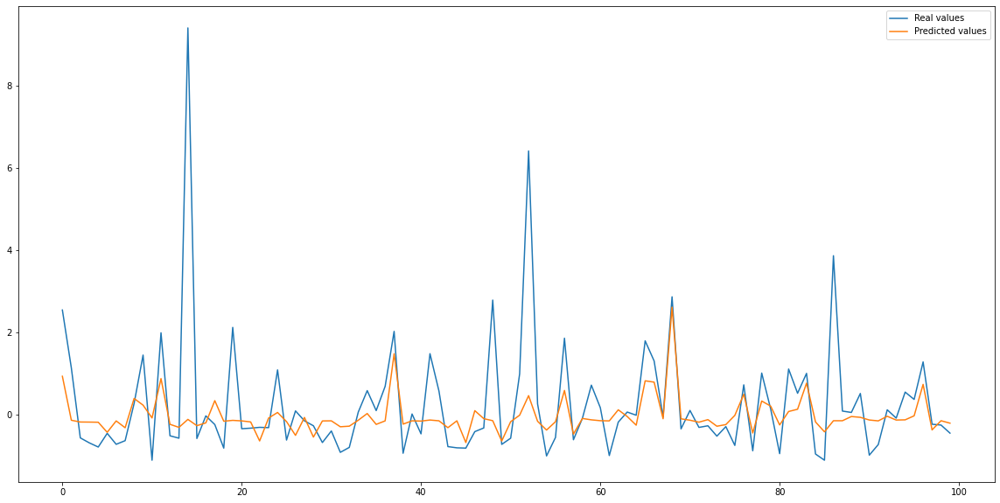

MAE = 0.27 0.53
MSE = 0.39 0.77
RMSE = 0.62 0.88
R2 = 0.63 0.26
AQI accuracy = 0.8566983528874426 0.697191139529573
AQI accuracy+-1 = 0.9834146898461362 0.9741950216944508



In [ ]:
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  svr = SVR2()
  testModelForVariousParameters(svr, df, [[6]], [6], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  svr = SVR2()
  testModelForVariousParameters(svr, df, [[6, 7, 8, 9, 10, 11, 12]], [6, 7, 8, 9, 10, 11, 12], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)
  
for param in ['NO2', 'SO2', 'O3', 'PM10', 'PM25']:
  svr = SVR2()
  testModelForVariousParameters(svr, df, [[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]], [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

SVR()
Param: NO2, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'NO2-12']
-1.1808397 3.377433


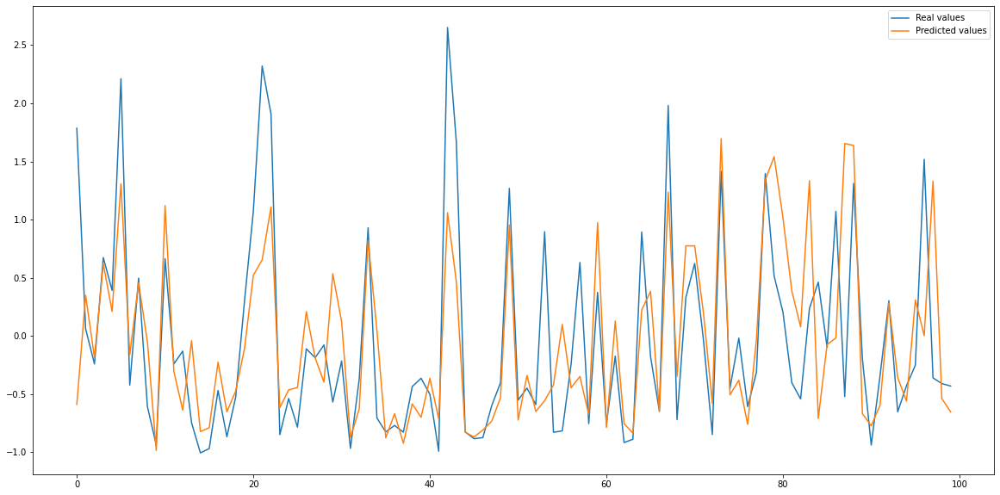

MAE = 0.45 0.48
MSE = 0.46 0.5
RMSE = 0.68 0.7
R2 = 0.54 0.5
AQI accuracy = 0.8164980780902286 0.8070807202103986
AQI accuracy+-1 = 0.9955391462674489 0.9951446489985839

SVR()
Param: SO2, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'SO2-12']
-1.1556383 3.7457497


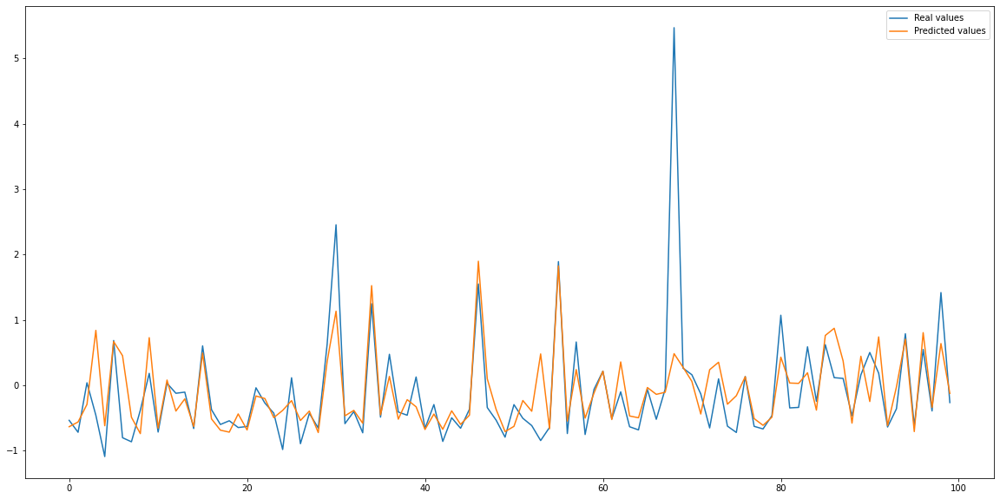

MAE = 0.37 0.41
MSE = 0.52 0.6
RMSE = 0.72 0.78
R2 = 0.48 0.4
AQI accuracy = 0.997886488994278 0.9976288659793815
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'O3-12']
-2.0598602 3.5705314


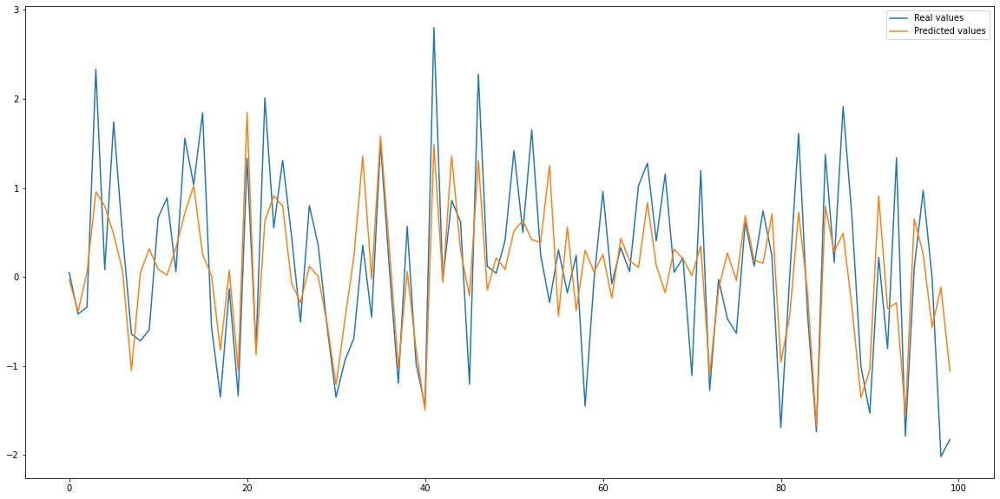

MAE = 0.51 0.56
MSE = 0.49 0.55
RMSE = 0.7 0.74
R2 = 0.51 0.45
AQI accuracy = 0.7910345937741938 0.7701364402882109
AQI accuracy+-1 = 0.9964815993009191 0.9955235321171241

SVR()
Param: PM10, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM10-12']
-1.1070377 4.039442


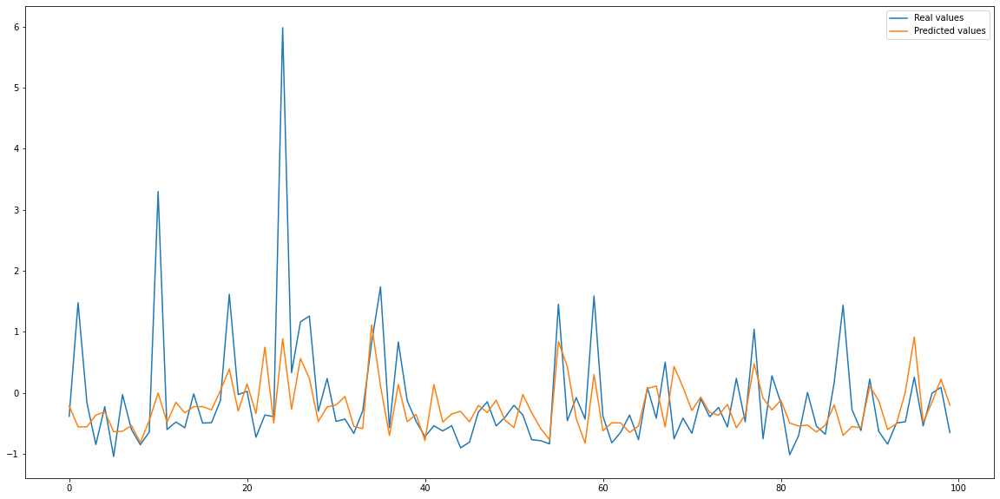

MAE = 0.46 0.49
MSE = 0.68 0.77
RMSE = 0.83 0.88
R2 = 0.31 0.25
AQI accuracy = 0.6541337089608842 0.6227487238755658
AQI accuracy+-1 = 0.9592347792586171 0.9554078782625446

SVR()
Param: PM25, history: [12]:
['temperature-12', 'wind-12', 'humidity-12', 'precipitation_1-12', 'month', 'weekday', 'hour', 'PM25-12']
-1.2676997 3.9749222


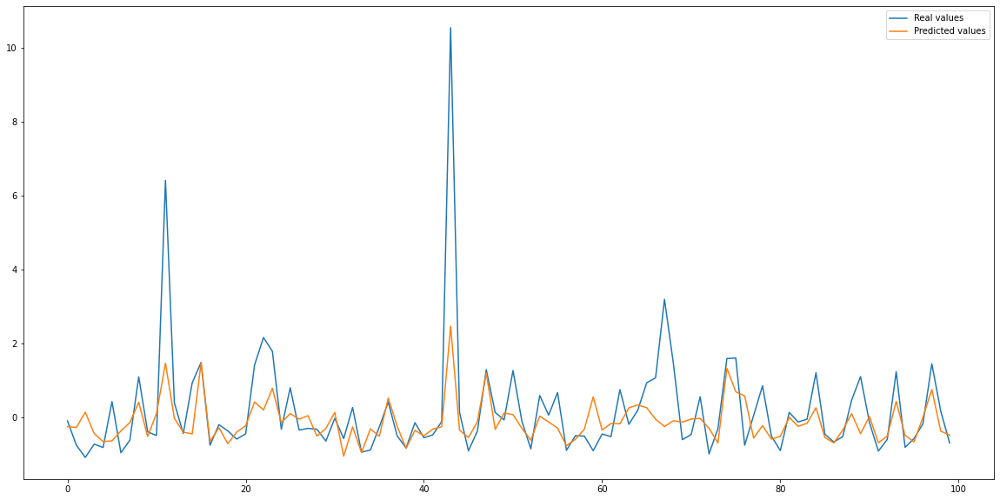

MAE = 0.43 0.48
MSE = 0.51 0.62
RMSE = 0.72 0.79
R2 = 0.48 0.42
AQI accuracy = 0.727286757896903 0.6925925925925925
AQI accuracy+-1 = 0.9832801728572899 0.9799382716049383

SVR()
Param: NO2, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'NO2-12', 'NO2-13', 'NO2-14', 'NO2-15', 'NO2-16', 'NO2-17']
-1.2403191 3.1584501


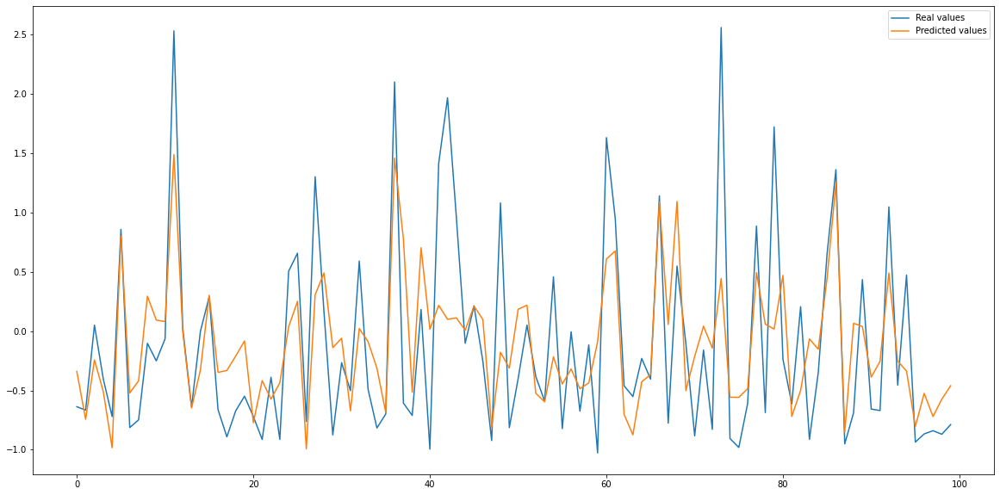

MAE = 0.3 0.56
MSE = 0.27 0.61
RMSE = 0.52 0.78
R2 = 0.73 0.39
AQI accuracy = 0.892420075988161 0.7811083123425693
AQI accuracy+-1 = 0.9961796007472868 0.9890008396305625

SVR()
Param: SO2, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'SO2-12', 'SO2-13', 'SO2-14', 'SO2-15', 'SO2-16', 'SO2-17']
-1.0712974 2.9778807


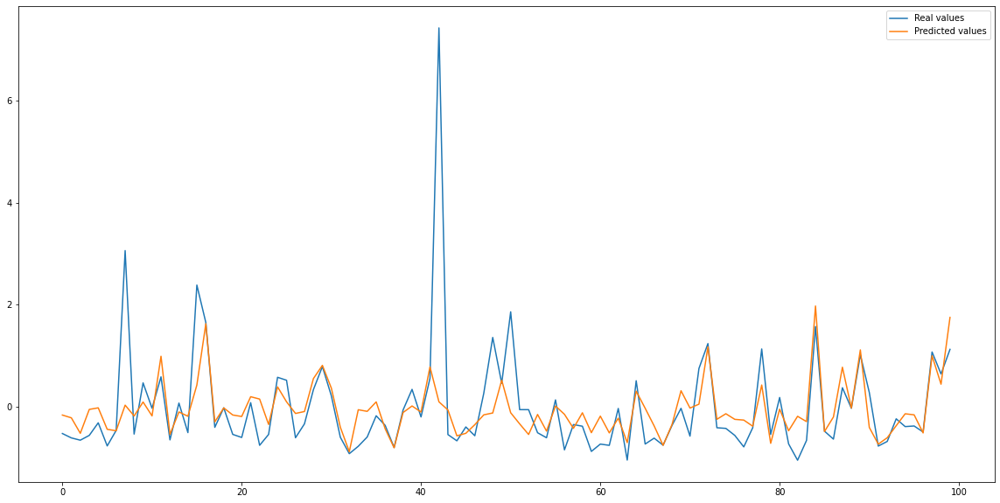

MAE = 0.26 0.47
MSE = 0.42 0.69
RMSE = 0.65 0.83
R2 = 0.58 0.29
AQI accuracy = 0.997904704889929 0.9974967348715716
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'O3-12', 'O3-13', 'O3-14', 'O3-15', 'O3-16', 'O3-17']
-2.1935356 2.6842957


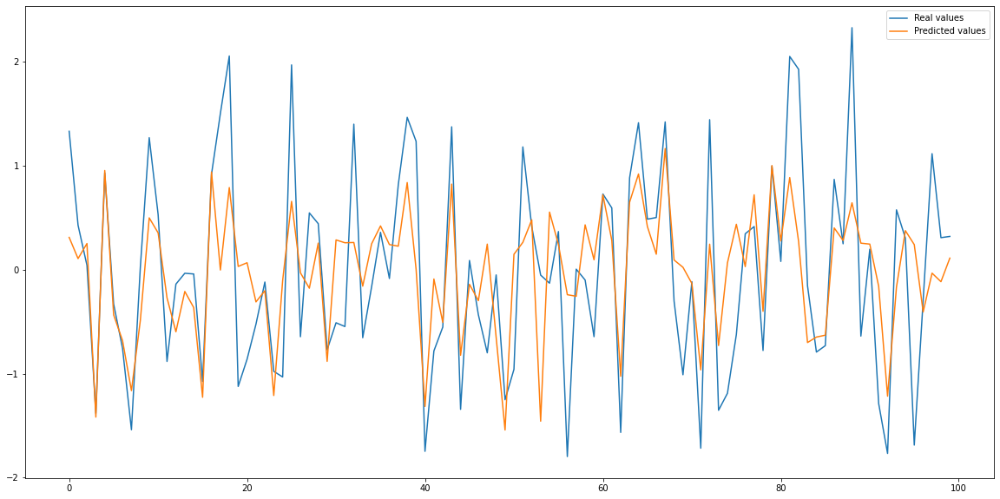

MAE = 0.31 0.6
MSE = 0.25 0.62
RMSE = 0.5 0.79
R2 = 0.75 0.38
AQI accuracy = 0.8857948262704606 0.7382339199501635
AQI accuracy+-1 = 0.9976405176844367 0.9934589627783834

SVR()
Param: PM10, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'PM10-12', 'PM10-13', 'PM10-14', 'PM10-15', 'PM10-16', 'PM10-17']
-1.0465379 3.3145158


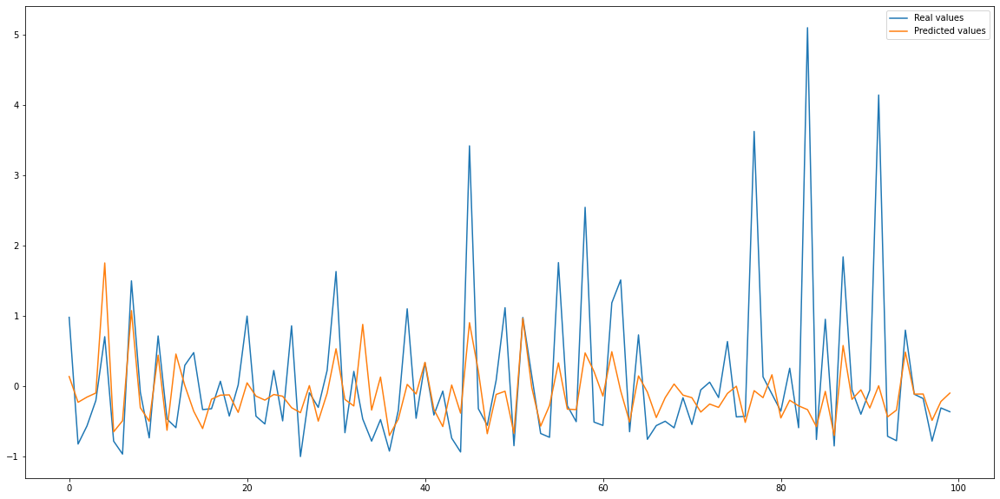

MAE = 0.31 0.52
MSE = 0.48 0.78
RMSE = 0.7 0.88
R2 = 0.52 0.22
AQI accuracy = 0.7711379373736136 0.5555174273248689
AQI accuracy+-1 = 0.9717262087137692 0.9601941271630963

SVR()
Param: PM25, history: [12, 13, 14, 15, 16, 17]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'month', 'weekday', 'hour', 'PM25-12', 'PM25-13', 'PM25-14', 'PM25-15', 'PM25-16', 'PM25-17']
-1.0382521 4.033252


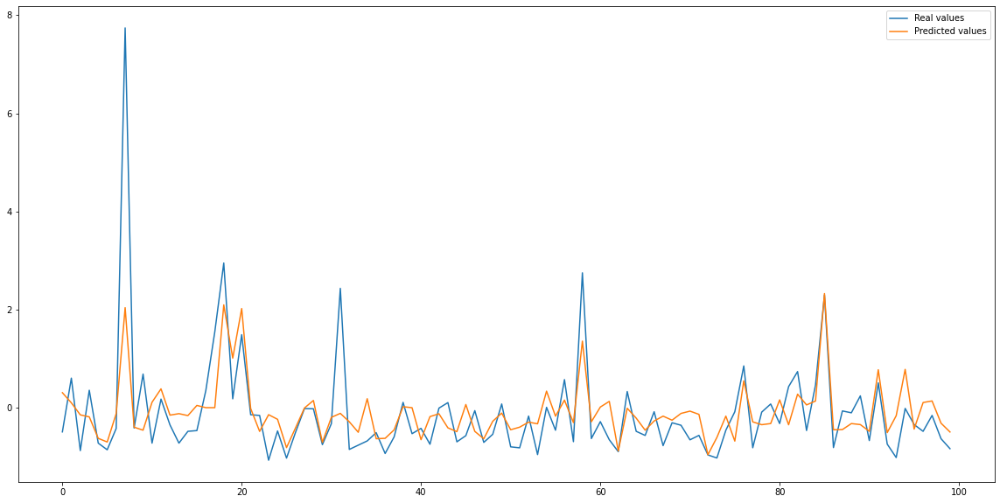

MAE = 0.29 0.52
MSE = 0.4 0.7
RMSE = 0.63 0.84
R2 = 0.61 0.32
AQI accuracy = 0.829402855906534 0.6736614386154678
AQI accuracy+-1 = 0.9850173085244482 0.9786911844240129

SVR()
Param: NO2, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'precipitation_1-18', 'precipitation_1-19', 'precipitation_1-20', 'precipitation_1-21', 'pr

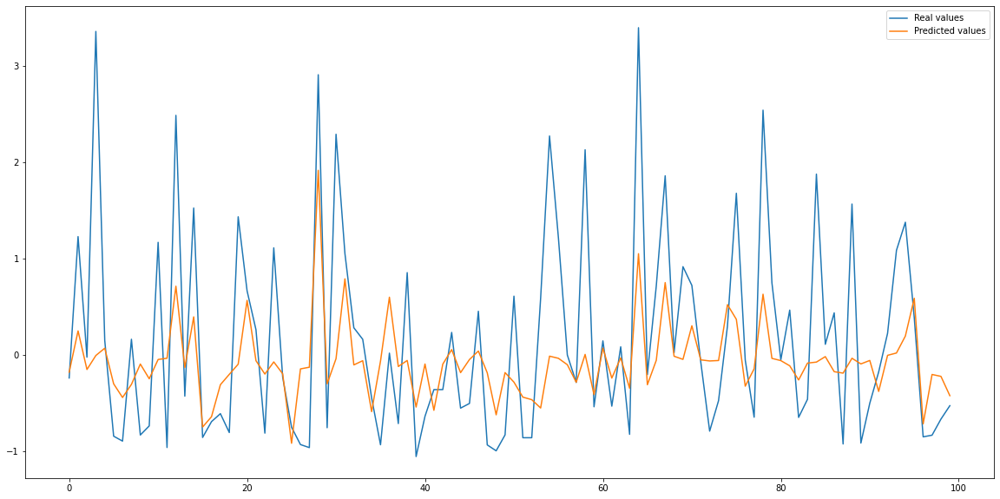

MAE = 0.3 0.66
MSE = 0.29 0.78
RMSE = 0.54 0.89
R2 = 0.72 0.24
AQI accuracy = 0.904426934726307 0.7401343224617005
AQI accuracy+-1 = 0.9952701812914271 0.9781396778016769

SVR()
Param: SO2, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'precipitation_1-18', 'precipitation_1-19', 'precipitation_1-20', 'precipitation_1-21', 'p

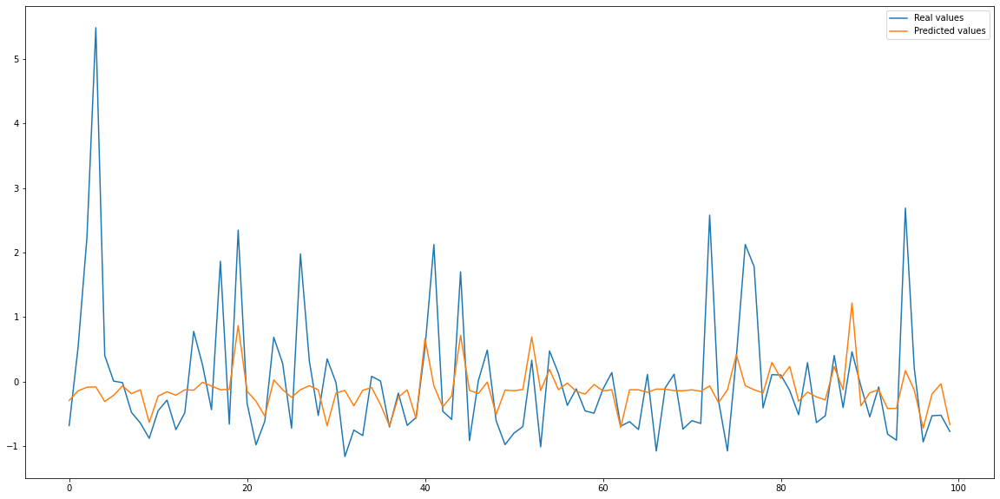

MAE = 0.26 0.51
MSE = 0.44 0.76
RMSE = 0.66 0.87
R2 = 0.57 0.22
AQI accuracy = 0.997787352975428 0.9975547275267815
AQI accuracy+-1 = 1.0 1.0

SVR()
Param: O3, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'precipitation_1-18', 'precipitation_1-19', 'precipitation_1-20', 'precipitation_1-21', 'precipitation_1-22', 'precipita

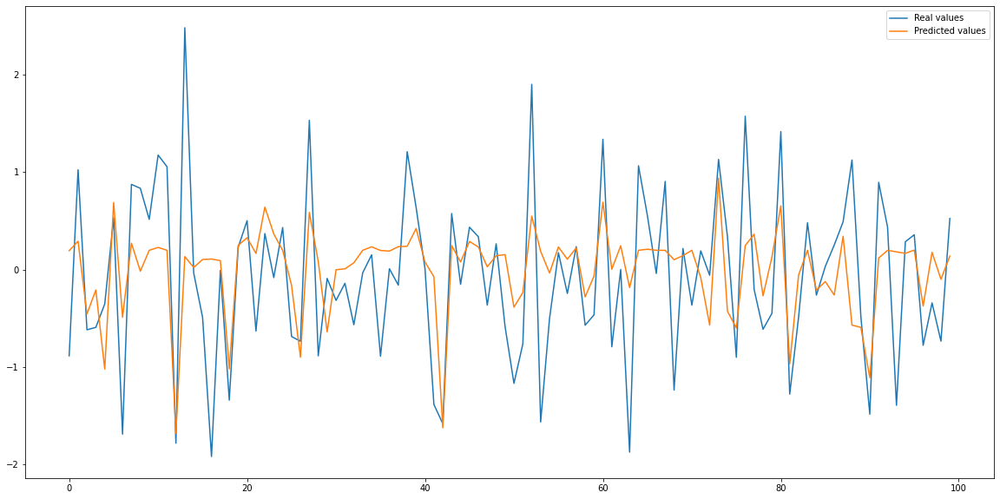

MAE = 0.27 0.61
MSE = 0.21 0.64
RMSE = 0.45 0.8
R2 = 0.79 0.36
AQI accuracy = 0.8990891202234353 0.7207058524819093
AQI accuracy+-1 = 0.997167386060683 0.9900977529516314

SVR()
Param: PM10, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'precipitation_1-18', 'precipitation_1-19', 'precipitation_1-20', 'precipitation_1-21', '

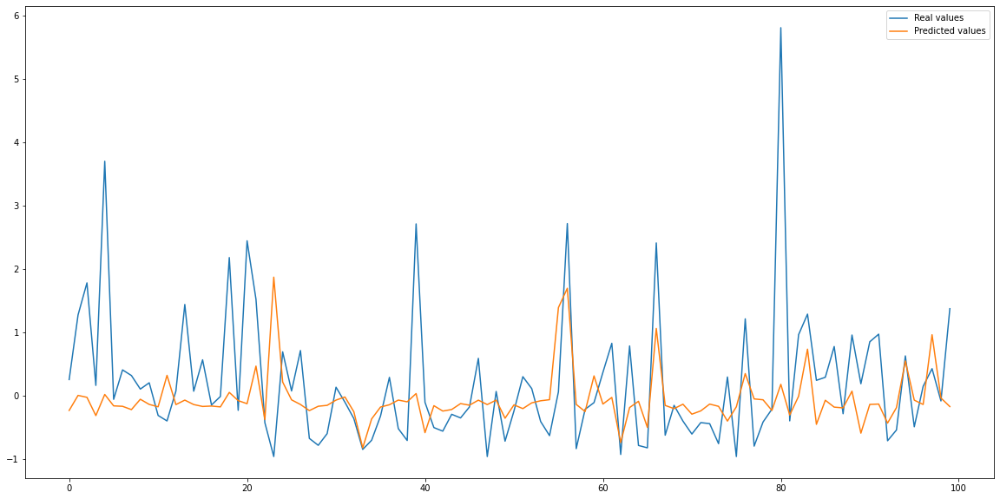

MAE = 0.28 0.53
MSE = 0.43 0.83
RMSE = 0.65 0.91
R2 = 0.57 0.2
AQI accuracy = 0.7733481496279279 0.4831443839584478
AQI accuracy+-1 = 0.9741672077111322 0.9653398591619637

SVR()
Param: PM25, history: [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23]:
['temperature-12', 'temperature-13', 'temperature-14', 'temperature-15', 'temperature-16', 'temperature-17', 'temperature-18', 'temperature-19', 'temperature-20', 'temperature-21', 'temperature-22', 'temperature-23', 'wind-12', 'wind-13', 'wind-14', 'wind-15', 'wind-16', 'wind-17', 'wind-18', 'wind-19', 'wind-20', 'wind-21', 'wind-22', 'wind-23', 'humidity-12', 'humidity-13', 'humidity-14', 'humidity-15', 'humidity-16', 'humidity-17', 'humidity-18', 'humidity-19', 'humidity-20', 'humidity-21', 'humidity-22', 'humidity-23', 'precipitation_1-12', 'precipitation_1-13', 'precipitation_1-14', 'precipitation_1-15', 'precipitation_1-16', 'precipitation_1-17', 'precipitation_1-18', 'precipitation_1-19', 'precipitation_1-20', 'precipitation_1-21', 

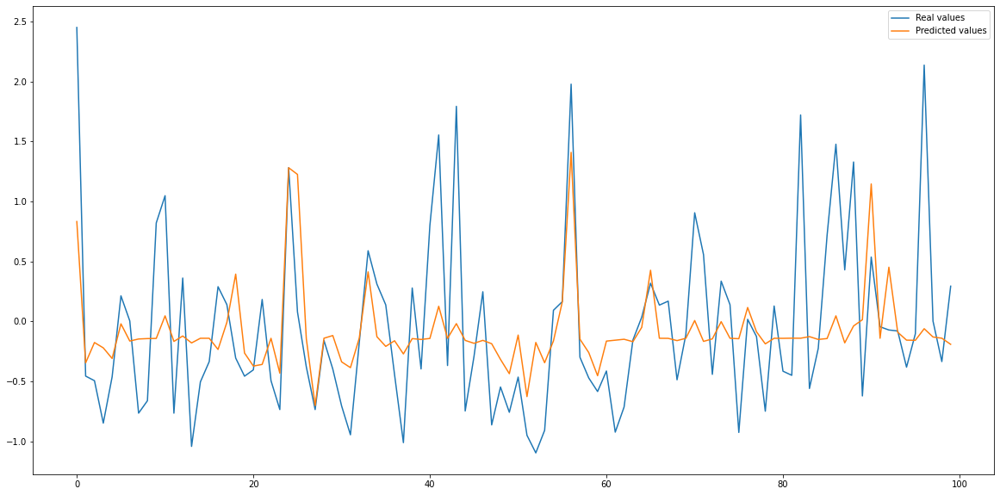

MAE = 0.27 0.54
MSE = 0.4 0.71
RMSE = 0.63 0.84
R2 = 0.62 0.28
AQI accuracy = 0.8498654143519844 0.6793036307410377
AQI accuracy+-1 = 0.983506099307027 0.9738861527889131



In [ ]:
svr = SVR2()
testModelForVariousParameters(svr, df, [[12]], [12], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

svr = SVR2()
testModelForVariousParameters(svr, df, [[12,13, 14, 15, 16, 17]], [12, 13, 14, 15, 16, 17], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

svr = SVR2()
testModelForVariousParameters(svr, df, [[12, 13, 14, 15, 16, 17, 18,19, 20, 21, 22, 23]], [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

AdaBoostRegressor(learning_rate=0.01, loss='square', n_estimators=200)
Param: SO2, history: [2]:
['temperature-2', 'wind-2', 'humidity-2', 'precipitation_1-2', 'month', 'weekday', 'hour', 'SO2-2']
4.026782543573451 50.25484133333336


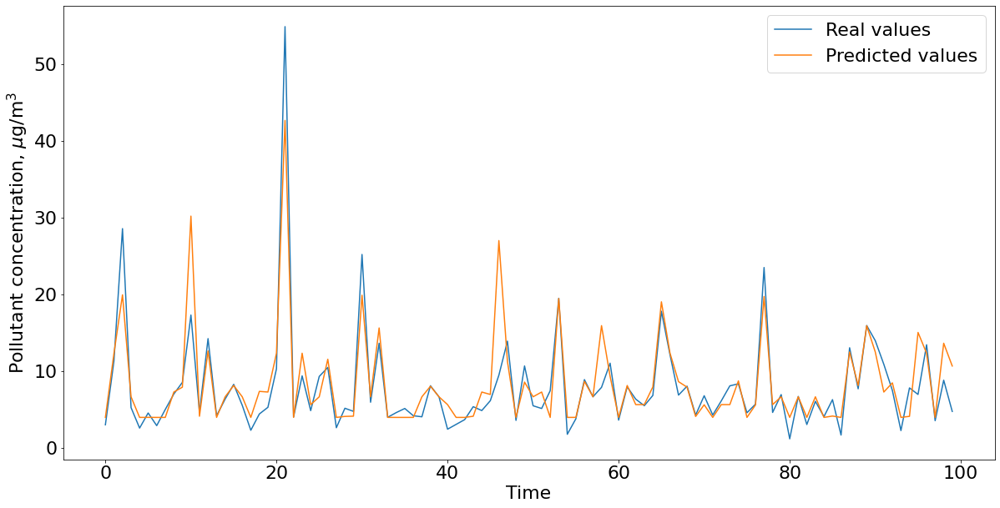

MAE = 1.77 1.8
MSE = 9.83 9.85
RMSE = 3.13 3.14
R2 = 0.76 0.75
AQI accuracy = 0.9979963523337357 0.9982533648412617
AQI accuracy+-1 = 1.0 1.0



In [ ]:
from sklearn.ensemble import AdaBoostRegressor
ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[2]], [2], ['SO2'], 0.2)


In [ ]:
ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[2]], [2], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[2,3, 4, 5, 6, 7]], [2, 3, 4, 5, 6, 7], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]], [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

In [ ]:
ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[6]], [6], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[6, 7, 8, 9, 10, 11, 12]], [6, 7, 8, 9, 10, 11, 12], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]], [6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

In [ ]:
ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[12]], [12], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[12,13, 14, 15, 16, 17]], [12, 13, 14, 15, 16, 17], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)

ada = AdaBoostRegressor(n_estimators=200, loss='square', learning_rate=0.01)
testModelForVariousParameters(ada, df, [[12, 13, 14, 15, 16, 17, 18,19, 20, 21, 22, 23]], [12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23], ['NO2', 'SO2', 'O3', 'PM10', 'PM25'], 0.2)